## Spotify dataset

### 0. Prepare Spotify Album data (only run when generating the Spotify dataset)

#### 0.1 Read data csv file

In [ ]:
! pip install -q requests

In [ ]:
import numpy as np
import pandas as pd
from PIL import Image
import random

import requests
from io import BytesIO


In [ ]:
# load data file
data_table = pd.read_csv('final_parent_genres_fixed.csv',
                   sep=',', header=0, index_col=0,error_bad_lines=False)
data_table.head(5)

<ipython-input-3-a7c4f1fcdf24>:2: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  data_table = pd.read_csv('final_parent_genres_fixed.csv',


,Genre,Artist,Album Name,URI,Image,Selected_Parent_Genre
0,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,San Diego 1989,spotify:album:4XVW50Jscloo7DGqbTuxSI,https://i.scdn.co/image/ab67616d00001e0220e656...,rock
1,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Heading North 53 NÂ° 8Â° E,spotify:album:0wk8LI6OGmJWivf6hKopeR,https://i.scdn.co/image/ab67616d00001e02b9ccc9...,rock
2,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Tales Of The New West,spotify:album:6toyhPRHSjBZYuBvorogOv,https://i.scdn.co/image/ab67616d00001e023ca375...,rock
3,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Best Of The Beat Farmers,spotify:album:4nI7uO3B7ja2n2Skm2H52G,https://i.scdn.co/image/ab67616d00001e02b459a4...,rock
4,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Loud and Plowed and... LIVE!,spotify:album:3DnGo1DUDP3O0Cynpplb1B,https://i.scdn.co/image/ab67616d00001e02df50b5...,rock


In [ ]:
data_table.count()

Genre                    136507
Artist                   136507
Album Name               136496
URI                      136507
Image                    136507
Selected_Parent_Genre    136507
dtype: int64

In [ ]:
data_table.tail()

,Genre,Artist,Album Name,URI,Image,Selected_Parent_Genre
136502,['neo-synthpop'],b! machine,Hybrid,spotify:album:20CBXqtAsib9BpcBWLvoIf,https://i.scdn.co/image/ab67616d00001e024ee561...,pop
136503,['neo-synthpop'],b! machine,Opal,spotify:album:5ybip8OOfB1HztE6x8PUVL,https://i.scdn.co/image/ab67616d00001e020059ca...,pop
136504,['neo-synthpop'],b! machine,Infinity Plus,spotify:album:0mvsKkpMNkxqE7jpfqcA43,https://i.scdn.co/image/ab67616d00001e022c8047...,pop
136505,['neo-synthpop'],b! machine,Aftermath,spotify:album:4EOt7z1j5Y61JiAvBCkA9Y,https://i.scdn.co/image/ab67616d00001e02b61020...,pop
136506,['neo-synthpop'],b! machine,Breaking the Silence,spotify:album:7iOfuXQBFccrH6jREXXEBU,https://i.scdn.co/image/ab67616d00001e02229293...,pop


In [ ]:
data_table['Selected_Parent_Genre'].unique()

array(['rock', 'jazz', 'folk;country;blues;indie', 'metal', 'pop',
       'other', 'indie', 'country', 'hip hop', 'pop;punk', 'metal;rock',
       'indie;rock', 'punk', 'christian', 'pop;hip hop',
       'hip hop;metal;rock', 'classical', 'jazz;rock', 'punk;rock;indie',
       'r&b', 'folk', 'rock;metal', 'rock;pop', 'punk;christian',
       'reggae;rock', 'pop;folk', 'rock;punk', 'country;blues', 'blues',
       'hip hop;pop', 'rock;indie', 'pop;rock', 'electronic',
       'country;rock', 'punk;metal', 'pop;r&b', 'rock;christian',
       'metal;christian', 'reggae', 'country;folk', 'folk;classical',
       'pop;punk;rock', 'folk;pop;jazz', 'blues;jazz',
       'country;folk;rock', 'electronic;jazz', 'country;pop', 'pop;indie',
       'folk;rock', 'folk;punk', 'pop;reggae', 'r&b;indie',
       'punk;pop;metal', 'punk;indie', 'blues;rock', 'folk;indie',
       'jazz;folk', 'rock;folk', 'rock;country', 'country;indie;rock',
       'indie;pop', 'punk;rock', 'folk;rock;pop', 'pop;rock;indi

#### 0.2 Download spotify data and organize into parent genres

In [ ]:
# obtain the list of parent genres
parent_genres_list = []

for genre in data_table['Selected_Parent_Genre'].unique():
    if str(genre) != 'nan':
        if ";" not in genre and genre != 'other':
            parent_genres_list.append(genre)

print(len(parent_genres_list))
print(parent_genres_list)

15
['rock', 'jazz', 'metal', 'pop', 'indie', 'country', 'hip hop', 'punk', 'christian', 'classical', 'r&b', 'folk', 'blues', 'electronic', 'reggae']


In [ ]:
# create a mapping to folder names (removed special characters)
parent_genres_output_dict = {}

for genre in parent_genres_list:
    parent_genres_output_dict[genre] = genre

parent_genres_output_dict['r&b'] = 'r_b'
parent_genres_output_dict['hip hop'] = 'hip_hop'
parent_genres_output_dict

{'rock': 'rock',
 'jazz': 'jazz',
 'metal': 'metal',
 'pop': 'pop',
 'indie': 'indie',
 'country': 'country',
 'hip hop': 'hip_hop',
 'punk': 'punk',
 'christian': 'christian',
 'classical': 'classical',
 'r&b': 'r_b',
 'folk': 'folk',
 'blues': 'blues',
 'electronic': 'electronic',
 'reggae': 'reggae'}

In [ ]:
# # create data folder structure
# folder_dir = 'album_spotify_single'
# !rm -rf $folder_dir
# !mkdir $folder_dir
# for _, genre in parent_genres_output_dict.items():
#     output_path = folder_dir+'/'+genre
#     !mkdir $output_path

In [ ]:
# filter the data and keep useful data
data_in = data_table[ data_table['Selected_Parent_Genre'].isin(parent_genres_list) ]
n_data = data_in['Selected_Parent_Genre'].count()
data_in.to_csv('final_parent_genres_super_filtered.csv', index=False)
n_data

116217

In [ ]:
# fetch data and save images under genres folders
# note that the idx in the original index before filter and is not continuous after filtering

folder_dir = 'album_spotify_single'

counter = 0

for idx in data_in.index:
    if counter%1000 == 0:
        print("working on sample No.",counter,". Index=",idx)

    genre = data_in.loc[idx, 'Selected_Parent_Genre']
    genre_dir = parent_genres_output_dict[ genre ]
    image_url = data_in.loc[idx, 'Image']

    file_no = str(idx)

    response = requests.get(image_url)
    image_file = BytesIO(response.content)
    image = Image.open(image_file)

    image.save(folder_dir+'/'+genre_dir+"/album"+file_no+".jpg")

    counter += 1


working on sample No. 0 . Index= 0
working on sample No. 1000 . Index= 1258
working on sample No. 2000 . Index= 2441
working on sample No. 3000 . Index= 3603
working on sample No. 4000 . Index= 4668
working on sample No. 5000 . Index= 5938
working on sample No. 6000 . Index= 7066
working on sample No. 7000 . Index= 8275
working on sample No. 8000 . Index= 9580
working on sample No. 9000 . Index= 10897
working on sample No. 10000 . Index= 11998
working on sample No. 11000 . Index= 13186
working on sample No. 12000 . Index= 14438
working on sample No. 13000 . Index= 15620
working on sample No. 14000 . Index= 16722
working on sample No. 15000 . Index= 17910
working on sample No. 16000 . Index= 19100
working on sample No. 17000 . Index= 20328
working on sample No. 18000 . Index= 21447
working on sample No. 19000 . Index= 22660
working on sample No. 20000 . Index= 23823
working on sample No. 21000 . Index= 25010
working on sample No. 22000 . Index= 26168
working on sample No. 23000 . Index=

In [ ]:
# make a zip file from folder
zip_file = folder_dir+".zip"
!zip -r $zip_file $folder_dir -q

#### 0.3 Load Spotify Album data and creating training and validation sets

In [ ]:
# download data from shared google drive file
# !wget https://1drv.ms/u/s!AkAIDJJbuiBcgsJ7eJWM8gQYdNeNCA?e=0geljL


--2023-04-11 15:51:21--  https://1drv.ms/u/s!AkAIDJJbuiBcgsJ7eJWM8gQYdNeNCA?e=0geljL
Resolving 1drv.ms (1drv.ms)... 13.107.42.12
Connecting to 1drv.ms (1drv.ms)|13.107.42.12|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://onedrive.live.com/redir?resid=5C20BA5B920C0840!41339&authkey=!AHiVjPIEGHTXjQg&e=0geljL [following]
--2023-04-11 15:51:22--  https://onedrive.live.com/redir?resid=5C20BA5B920C0840!41339&authkey=!AHiVjPIEGHTXjQg&e=0geljL
Resolving onedrive.live.com (onedrive.live.com)... 13.107.43.13
Connecting to onedrive.live.com (onedrive.live.com)|13.107.43.13|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6817 (6.7K) [text/html]
Saving to: ‘s!AkAIDJJbuiBcgsJ7eJWM8gQYdNeNCA?e=0geljL.1’

s!AkAIDJJbuiBcgsJ7e 100%[===================>]   6.66K  --.-KB/s    in 0s      

2023-04-11 15:51:23 (76.3 MB/s) - ‘s!AkAIDJJbuiBcgsJ7eJWM8gQYdNeNCA?e=0geljL.1’ saved [6817/6817]



In [ ]:
# define folder name
folder_dir = "album_spotify_single"

In [ ]:
# unzip data
zip_file = folder_dir + ".zip"
! unzip -q $zip_file

In [ ]:
# create a data_list file containing filenames and categories

for key, value in parent_genres_output_dict.items():
    folder_cur = folder_dir + "/" + value + "/*.jpg"
    file_cur = folder_dir + "/files_" + value + ".txt"
    ! ls $folder_cur > $file_cur
    ! wc $file_cur


  25831   25831 1063878 album_spotify_single/files_rock.txt
  4033   4033 165730 album_spotify_single/files_jazz.txt
 12098  12098 510160 album_spotify_single/files_metal.txt
 19999  19999 803751 album_spotify_single/files_pop.txt
  3644   3644 153832 album_spotify_single/files_indie.txt
  8491   8491 375387 album_spotify_single/files_country.txt
  7561   7561 333905 album_spotify_single/files_hip_hop.txt
  4630   4630 190984 album_spotify_single/files_punk.txt
  3966   3966 183066 album_spotify_single/files_christian.txt
  7412   7412 342251 album_spotify_single/files_classical.txt
  4119   4119 165512 album_spotify_single/files_r_b.txt
  5087   5087 209980 album_spotify_single/files_folk.txt
  6291   6291 265468 album_spotify_single/files_blues.txt
 1764  1764 83313 album_spotify_single/files_electronic.txt
 1291  1291 55907 album_spotify_single/files_reggae.txt


In [ ]:
## randomly split data (index file) based on given ratio

# set random seed number
np.random.seed(2023)

def split_data_index(input_fn, output_fn_1, output_fn_2, split_ratio=0.8):
    '''
    Function to split data catalog file based on ratio
    '''
    index_in = []
    # get the list of index from file
    with open(input_fn, 'r') as file:
        for line in file:
            index_in.append(line.strip())

    # get the number of indice for output files
    n_data = len(index_in)
    n1 = round(n_data*split_ratio)
    n2 = n_data - n1

    # get the list of indice for output files
    index_out_1 = random.sample(index_in, n1)
    index_out_2 = [idx for idx in index_in if idx not in index_out_1]

    # write output files
    with open(output_fn_1, 'w') as file:
        for item in index_out_1:
            file.write("%s\n" % item)

    with open(output_fn_2, 'w') as file:
        for item in index_out_2:
            file.write("%s\n" % item)

def subset_data_index(input_fn, output_fn, n_samples):
    '''
    Function to select a subset of data within catalog file
    '''
    index_in = []
    # get the list of index from file
    with open(input_fn, 'r') as file:
        for line in file:
            index_in.append(line.strip())

    # get the number of indice for output files
    n_data = len(index_in)
    if n_samples > n_data:
        print("Warning: Requested number of samples is great to the number of available samples, cut to",n_data)
        n_samples = n_data

    # get the list of indice for output files
    index_out = random.sample(index_in, n_samples)

    # write output files
    with open(output_fn, 'w') as file:
        for item in index_out:
            file.write("%s\n" % item)



In [ ]:
# split data into train and val

n_sub = 500

for key, value in parent_genres_output_dict.items():
    print("working on genre",key)

    file_in = folder_dir + "/files_" + value + ".txt"
    output_fn_train = folder_dir + "/files_" + value + "_train.txt"
    output_fn_val   = folder_dir + "/files_" + value + "_val.txt"
    output_fn_train_sub = folder_dir + "/files_" + value + "_train_sub.txt"
    output_fn_val_sub   = folder_dir + "/files_" + value + "_val_sub.txt"

    split_data_index(file_in, output_fn_train, output_fn_val, split_ratio=0.5)
    subset_data_index(output_fn_train, output_fn_train_sub, n_sub)
    subset_data_index(output_fn_val, output_fn_val_sub, n_sub)


working on genre rock
working on genre jazz
working on genre metal
working on genre pop
working on genre indie
working on genre country
working on genre hip hop
working on genre punk
working on genre christian
working on genre classical
working on genre r&b
working on genre folk
working on genre blues
working on genre electronic
working on genre reggae


In [ ]:
# copy train and val images to new dir

dir_train = "album_spotify_15genres_train"
dir_val = "album_spotify_15genres_val"

!mkdir $dir_train
!mkdir $dir_val
!ls $folder_dir/files_*_train_sub.txt > $dir_train/file_list.txt
!ls $folder_dir/files_*_val_sub.txt > $dir_val/file_list.txt

fn_in_train = []
fn_in_val = []
with open(dir_train+"/file_list.txt", 'r') as file:
    for line in file:
        fn_in_train.append(line.strip())

with open(dir_val+"/file_list.txt", 'r') as file:
    for line in file:
        fn_in_val.append(line.strip())

for key, value in parent_genres_output_dict.items():
    dir_cur = dir_train + "/" + value
    !mkdir $dir_cur
    dir_cur = dir_val + "/" + value
    !mkdir $dir_cur
    
# for file in fn_in_train:
#     genre_dir = file.split("_")[1]
#     print("working on",genre_dir)
#     !mkdir $genre_dir
#     with open(file, 'r') as file:
#         for fn in file:
#             to_dir = dir_train+"/"+genre_dir+"/"+fn
#             !cp $fn $to_dir
            
# for file in fn_in_val:
#     genre_dir = file.split("_")[1]
#     print("working on",genre_dir)
#     !mkdir $genre_dir
#     with open(file, 'r') as file:
#         for fn in file:
#             to_dir = dir_val+"/"+genre_dir+"/"+fn
#             !cp $fn $to_dir


In [ ]:
counter = 0

for file in fn_in_train:
    print("working on",file)
    with open(file, 'r') as paths:
        for path_from in paths:
            counter += 1
            path_from_tokens = path_from.split("/")
            path_to = dir_train + "/" + path_from_tokens[1] + "/" + path_from_tokens[2]
            cp_command = "cp "+ path_from.replace('\n', '') + " " + path_to
            ! $cp_command

print(counter)
counter = 0

for file in fn_in_val:
    print("working on",file)
    with open(file, 'r') as paths:
        for path_from in paths:
            counter += 1
            path_from_tokens = path_from.split("/")
            path_to = dir_val + "/" + path_from_tokens[1] + "/" + path_from_tokens[2]
            cp_command = "cp "+ path_from.replace('\n', '') + " " + path_to
            ! $cp_command

print(counter)


working on album_spotify_single/files_blues_train_sub.txt
working on album_spotify_single/files_christian_train_sub.txt
working on album_spotify_single/files_classical_train_sub.txt
working on album_spotify_single/files_country_train_sub.txt
working on album_spotify_single/files_electronic_train_sub.txt
working on album_spotify_single/files_folk_train_sub.txt
working on album_spotify_single/files_hip_hop_train_sub.txt
working on album_spotify_single/files_indie_train_sub.txt
working on album_spotify_single/files_jazz_train_sub.txt
working on album_spotify_single/files_metal_train_sub.txt
working on album_spotify_single/files_pop_train_sub.txt
working on album_spotify_single/files_punk_train_sub.txt
working on album_spotify_single/files_r_b_train_sub.txt
working on album_spotify_single/files_reggae_train_sub.txt
working on album_spotify_single/files_rock_train_sub.txt
7500
working on album_spotify_single/files_blues_val_sub.txt
working on album_spotify_single/files_christian_val_sub.txt

In [ ]:
folder_name = "album_spotify_15genres_train"
zip_file = folder_name+".zip"
!zip -r $zip_file $folder_name -q

folder_name = "album_spotify_15genres_val"
zip_file = folder_name+".zip"
!zip -r $zip_file $folder_name -q

### 1. Load and prepare Album cover data

#### 1.1 Imports

In [ ]:
!pip install livelossplot --quiet
!pip install torchmetrics --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 19.1 MB/s eta 0:00:00


In [ ]:
## imports

import os, json, pickle, random
import torch.utils.data
from PIL import Image

from torchvision import transforms

import matplotlib
import matplotlib.pyplot as plt

import time
import numpy as np
import pandas as pd

from PIL import Image
import cv2 
import numpy as np
import matplotlib.pyplot as plt

#### 1.2 Setup dataset name (important)


In [ ]:
## set data folder name
## this is used to control which dataset to use
train_folder_name = 'album_spotify_15genres_train'
val_folder_name = 'album_spotify_15genres_val'

#### 1.3 Find genres of images

In [ ]:
# !wget https://1drv.ms/u/s!AkAIDJJbuiBcgsM7raMkZKhX-O8Zzg?e=qxPq6O

In [ ]:
## unzip
!unzip -q $train_folder_name".zip"
!unzip -q $val_folder_name".zip"

In [ ]:
# dump image filenames and genres to a csv file
! ls $train_folder_name/*/* > train_data_file_paths
! cat train_data_file_paths | awk -F/ '{print $2","$3","$0}' > train_data_list.csv
! ls $val_folder_name/*/* > val_data_file_paths
! cat val_data_file_paths | awk -F/ '{print $2","$3","$0}' > val_data_list.csv

In [ ]:
# load filename and genre data list
train_data_list = pd.read_csv('train_data_list.csv', header=None, names=['genre', 'filename', 'file_path'])
val_data_list   = pd.read_csv('val_data_list.csv', header=None, names=['genre', 'filename', 'file_path'])

# find unique genre and filename
train_file_names = train_data_list['filename'].drop_duplicates()
train_genre_names = train_data_list['genre'].drop_duplicates()
val_file_names = val_data_list['filename'].drop_duplicates()
val_genre_names = val_data_list['genre'].drop_duplicates()

print("Number of unique train files is:",train_file_names.shape[0])
print("Number of unique train genres is:",train_genre_names.shape[0])
print("Number of unique val files is:",val_file_names.shape[0])
print("Number of unique val genres is:",val_genre_names.shape[0])

Number of unique train files is: 7500
Number of unique train genres is: 15
Number of unique val files is: 7500
Number of unique val genres is: 15


#### 1.4 QC Album covers

Image shape:  (300, 300, 3)
Value type: <class 'numpy.uint8'>, Min: 0, Max: 255


(-0.5, 299.5, 299.5, -0.5)

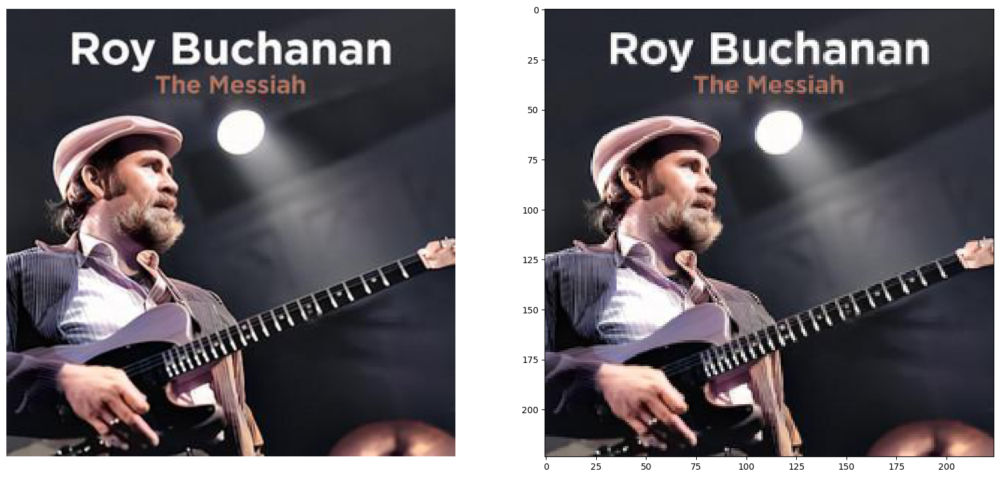

In [ ]:
# review images and test the effect of resizing

# from PIL import Image
# import cv2 
# import numpy as np
# import matplotlib.pyplot as plt

img_path = val_data_list['file_path'][0]

im = Image.open(img_path)

im = np.array(im) # Convert to a numpy array
print("Image shape: ", im.shape) # Prints out shape: (height, width, channels)
print("Value type: %s, Min: %d, Max: %d" % (type(im[0,0,0]), np.min(im), np.max(im))) # Image is loaded with uint8 values in [0, 255]

im_224 = cv2.resize(im, (224, 224))
im_out = Image.fromarray(im_224)

# im_out.save('test_224.jpg')

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20,40))

ax[0].imshow(im) # Show image
ax[0].axis(False)
ax[1].imshow(im_out)
ax[0].axis(False)


#### 1.5 Setup data loader

In [ ]:
## create list of classes
!cd
!ls -d $train_folder_name/*/ | cut -d "/" -f 2 > $train_folder_name/ClassName.txt
!ls -d $val_folder_name/*/ | cut -d "/" -f 2 > $val_folder_name/ClassName.txt

In [ ]:
# Simple implementation of a custom data loading class for our dataset.
class album_cover_loader(torch.utils.data.Dataset):

  # Initialize the class e.g. load files, preprocess, etc.
  def __init__(self, folder_name, split = '', transform = None):
    
    # These are the 20 categories selected.
    # self.categories = open('GAID/' + split + '/ClassName.txt').read().split('\n')[:-1]
    self.categories = open(folder_name + '/' + split + '/ClassName.txt').read().split('\n')[:-1]
    self.categories = sorted(self.categories)
    self.category2index = {category: idx for (idx, category) in enumerate(self.categories)}
    self.transform = transform

    # Compile a list of images and corresponding labels.
    self.imagepaths = []
    self.labels = []
    for category in self.categories:
    #   category_directory = 'GAID/' + split + category
      category_directory = folder_name + '/' + split + category
      category_imagenames = os.listdir(category_directory)
      self.imagepaths += [os.path.join(category_directory, imagename) 
                          for imagename in category_imagenames]
      self.labels += [self.category2index[category]] * len(category_imagenames)

    # Sort imagepaths alphabetically and labels accordingly.
    sorted_pairs = sorted(zip(self.imagepaths, self.labels), key = lambda x: x[0])
    self.imagepaths, self.labels = zip(*sorted_pairs)

        
  # Return a sample (x, y) as a tuple e.g. (image, label)
  def __getitem__(self, index):
    image = Image.open(self.imagepaths[index]).convert('RGB')
    if self.transform:
      image = self.transform(image)
    return image, self.labels[index]
  
  # Return the total number of samples.
  def __len__(self):
    return len(self.imagepaths)

This dataset has 7500 training images
Image 0 is a blues
Image size is 300x300


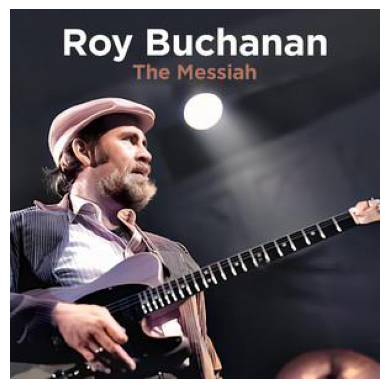

In [ ]:
import matplotlib
import matplotlib.pyplot as plt

# valset = GAID(split = '')
valset = album_cover_loader(folder_name = val_folder_name, split = '')

image_index = 0  # Feel free to change this.

# 1. Datasets need to implement the __len__ method for this to work.
print('This dataset has {0} training images'.format(len(valset)))

# 2. Datasets need to implement the  __getitem__ method for this to work.
img, label = valset[image_index]  # Returns image and label.

print('Image {0} is a {1}'.format(image_index, valset.categories[label]))
print('Image size is {0}x{1}'.format(img.height, img.width))

# Show the image.
plt.figure();plt.imshow(img);
plt.grid(False); plt.axis('off'); plt.show()

### 2. Train/Fine-tune model for Genre classification

#### 2.1 Prep CLIP model and helper functions

In [ ]:
! pip install ftfy regex tqdm
! pip install git+https://github.com/openai/CLIP.git

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 5.3 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-6vfaru7i
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-6vfaru7i
  Resolved https://github.com/openai/CLIP.git to commit a9b1bf5920416aaeaec965c25dd9e8f98c864f16
  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369398 sha256=25858985dc91b59d073bc60c80551451fbfd02b5d46801368fe20ebeffa55e8a
  Stored in directory: /tmp/pip-ephem-wheel-cache-ts052bhj/wheels/c8/e4/e1/11374c111387672fc2068dfbe0d4b424cb9cdd1b2e184a71b5
Successfully built clip


In [ ]:
import torch
from pkg_resources import packaging

import clip

import IPython.display

from collections import OrderedDict

print("Torch version:", torch.__version__)

clip.available_models()

Torch version: 2.0.0+cu118


['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [ ]:
# load pre-trained model
# model, preprocess = clip.load("ViT-B/32")
model, preprocess = clip.load("ViT-L/14")

model.cuda().eval()
input_resolution = model.visual.input_resolution
context_length = model.context_length
vocab_size = model.vocab_size

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

100%|███████████████████████████████████████| 890M/890M [00:10<00:00, 90.0MiB/s]


Model parameters: 427,616,513
Input resolution: 224
Context length: 77
Vocab size: 49408


In [ ]:
# helper functions

to_tensor = transforms.ToTensor()
to_image = transforms.ToPILImage()

def image_pil_to_tensor(img):
    transform = transforms.Compose([transforms.ToTensor()])
    return transform(img)

def image_tensor_to_pil(img):
    transform = transforms.Compose([transforms.ToPILImage()])
    return transform(img)

def image_tensor_to_numpy(img_tensor):
    img_np = img_tensor.detach().cpu().numpy()
    return np.transpose( img_np[...], (1, 2, 0))

def image_numpy_to_tensor(img_np):
    img_tensor = torch.tensor(img_np)
    return img_tensor

def image_resize(image, img_height=256, img_width=256):
    transform = transforms.Compose([transforms.Resize([img_height,img_width])])
    return transform(image)

#### 2.2 QC data

In [ ]:
# QC categories in dataset
valset.categories

['blues',
 'christian',
 'classical',
 'country',
 'electronic',
 'folk',
 'hip_hop',
 'indie',
 'jazz',
 'metal',
 'pop',
 'punk',
 'r_b',
 'reggae',
 'rock']

/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


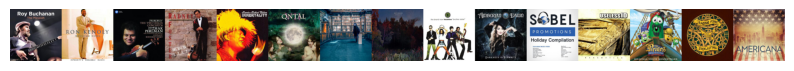

In [ ]:
# Show image examples

valset = album_cover_loader(folder_name = val_folder_name, split = '')

n_class = len(valset.categories)
n_channel = 3
height = 224
width = 224

image_exp_list = []
found_list = []

for (image, label) in valset:
    # only save first image in each category
    if label not in found_list:
        image_cur = image_pil_to_tensor(image)
        image_cur = image_resize( image_cur, 224, 224 )
        image_exp_list.append( image_cur )
        found_list.append(label)

image_exp_display = image_tensor_to_numpy( torch.concat(image_exp_list, axis = 2) )
plt.figure(figsize=(10,150))
plt.imshow( image_exp_display )
plt.grid(False); 
plt.axis('off'); 

#### 2.3 Descriptions

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# prompt after feature engineering
descriptions = {
    "rock": "Color: Varied color palettes, often leaning towards darker or more saturated hues. \
Imagery: Striking visuals, powerful symbols, abstract designs, rock culture elements like musical instruments, concert venues, iconic symbols, and elements of rebellion or counterculture such as political statements, anti-establishment symbols, or provocative imagery. \
Text: Stylized typography with bold lettering and distressed textures.",

    "country": "Color: Warm, earthy browns, greens, and reds. \
Imagery: Rural landscapes such as farms, fields, rolling hills, country icons like cowboys, pickup trucks, and cowboy hats, and a sense of Americana. \
Text: Bold, simple, and legible typography.",

    "pop": "Color: Bright and bold colors. \
Imagery: Artist's image, people dancing or partying, bold patterns, surreal visuals, unusual textures. \
Text: Distinctive lettering, creative fonts, playful shapes, and colors.",

    "hip_hop": "Color: Vibrant and bold colors. \
Imagery: Urban culture visuals, including cityscapes, graffiti, hip hop fashion, breakdancing, DJing, and stylized or altered photographs or illustrations of the artist or urban scenes. \
Text: Stylized typography with elements like drop shadows or 3D effects, bold lettering.",

    "folk": "Earthy tones, like browns, greens, and blues. \
Imagery: Scenic nature like forests or mountains, regional folk customs or instruments, artists in natural settings or folk venues. \
Text: Rustic, hand-drawn typography, reflecting tradition.",

    "metal": "Color: Muted shades of black, gray, and red. \
Imagery: Dark or intense visuals, featuring fantasy or horror themes, depictions of demons, monsters, supernatural creatures, symbols of death, destruction, or rebellion. \
Text: Gothic or medieval-inspired bold and angular typography.",

    "r_b": "Color: Rich, vibrant, or sultry color schemes. \
Imagery: Sensual or emotional themes, cityscapes, nightlife, silhouettes or portraits of artists, abstract or geometric patterns. \
Text: Smooth, stylish typography, often with a modern or urban influence.",

    "punk": "Color: Monochromatic palette or limited to black and white. \
Imagery: Raw, rebellious aesthetic featuring bold designs with gritty or distressed textures, hand-drawn elements, DIY-style graphics, politically charged or socially conscious themes, and punk subculture symbols like safety pins, leather jackets, and mohawks. \
Text: Bold, distressed typography.",

    "blues": "Color: Deep, rich blues, blacks, and reds. \
Imagery: Elements of African American history and culture, rural landscapes, sharecroppers, iconic Southern images, and instruments like guitars, harmonicas, and pianos. \
Text: Classic and legible typography.",

    "christian": "Color: Soft, warm hues or uplifting bright colors. \
Imagery: Spiritual symbols, peaceful landscapes, religious buildings, or abstract designs conveying faith, hope, or love. \
Text: Elegant, refined typography or handwritten-style lettering.",

    "classical": "Color: Neutral and elegant colors. \
Imagery: Minimalist designs, sophisticated and timeless imagery, classical instruments like pianos, violins, and cellos. \
Text: Serif fonts, calligraphy, or other classical typography styles.",

    "indie": "Color: Diverse, often bold or unconventional palettes. \
Imagery: Unique, artistic visuals, eclectic or abstract designs, personal or introspective themes, hand-drawn elements. \
Text: Creative, distinctive typography, often handcrafted or experimental in style.",

    "jazz": "Color: Diverse color schemes, vibrant and bold or subdued and muted. \
Imagery: Photography, artwork, musicians playing instruments such as trumpet or sax, jazz clubs and venues, cityscapes, nature, and abstract shapes, designs, and patterns. \
Text: Elegant, refined serifs or modern, playful sans-serif fonts, bold or italicized.",

    "reggae": "Color: Vibrant colors, prominently featuring red, green, and yellow. \
Imagery: Tropical landscapes, historical figures, Jamaican culture, Rastafarianism, iconic Reggae artists or bands, political messages, social commentary, and bold patterns. \
Text: Bold typography.",

    "electronic": "Color: Neon and bright colors, like pink, blue, or green. \
Imagery: Abstract or psychedelic elements, including geometric shapes, trippy patterns, and digital landscapes. \
Text: Sleek sans-serif fonts, futuristic-looking typefaces, and bold typography."
}

# descriptions = {
#     "blues": "Color: Deep, rich blues, blacks, and reds. \
# Imagery: Elements of African American history and culture, rural landscapes, sharecroppers, iconic Southern images, and instruments like guitars, harmonicas, and pianos. \
# Text: Classic and legible typography.",

#     "christian": "Color: Soft, warm hues or uplifting bright colors. \
# Imagery: Spiritual symbols, peaceful landscapes, religious buildings, or abstract designs conveying faith, hope, or love. \
# Text: Elegant, refined typography or handwritten-style lettering.",

#     "classical": "Color: Neutral and elegant colors. \
# Imagery: Minimalist designs, sophisticated and timeless imagery, classical instruments like pianos, violins, and cellos. \
# Text: Serif fonts, calligraphy, or other classical typography styles.",

#     "country": "Color: Warm, earthy browns, greens, and reds. \
# Imagery: Rural landscapes such as farms, fields, rolling hills, country icons like cowboys, pickup trucks, and cowboy hats, and a sense of Americana. \
# Text: Bold, simple, and legible typography.",

#     "electronic": "Color: Neon and bright colors, like pink, blue, or green. \
# Imagery: Abstract or psychedelic elements, including geometric shapes, trippy patterns, and digital landscapes. \
# Text: Sleek sans-serif fonts, futuristic-looking typefaces, and bold typography.",

#     "folk": "Colors: Earthy tones, like browns, greens, and blues. \
# Imagery: Scenic nature like forests or mountains, regional folk customs or instruments, artists in natural settings or folk venues. \
# Text: Rustic, hand-drawn typography, reflecting tradition.",

#     "hip_hop": "Color: Vibrant and bold colors. \
# Imagery: Urban culture visuals, including cityscapes, graffiti, hip hop fashion, breakdancing, DJing, and stylized or altered photographs or illustrations of the artist or urban scenes. \
# Text: Stylized typography with elements like drop shadows or 3D effects, bold lettering.",

#     "indie": "Color: Diverse, often bold or unconventional palettes. \
# Imagery: Unique, artistic visuals, eclectic or abstract designs, personal or introspective themes, hand-drawn elements. \
# Text: Creative, distinctive typography, often handcrafted or experimental in style.",

#     "jazz": "Diverse color schemes, vibrant and bold or subdued and muted. \
# Imagery: Photography, artwork, musicians playing instruments such as trumpet or sax, jazz clubs and venues, cityscapes, nature, and abstract shapes, designs, and patterns. \
# Text: Elegant, refined serifs or modern, playful sans-serif fonts, bold or italicized.",

#     "metal": "Color: Muted shades of black, gray, and red. \
# Imagery: Dark or intense visuals, featuring fantasy or horror themes, depictions of demons, monsters, supernatural creatures, symbols of death, destruction, or rebellion. \
# Text: Gothic or medieval-inspired bold and angular typography.",

#     "pop": "Color: Bright and bold colors. \
# Imagery: Artist's image, people dancing or partying, bold patterns, surreal visuals, unusual textures. \
# Text: Distinctive lettering, creative fonts, playful shapes, and colors.",

#     "punk": "Color: Monochromatic palette or limited to black and white. \
# Imagery: Raw, rebellious aesthetic featuring bold designs with gritty or distressed textures, hand-drawn elements, DIY-style graphics, politically charged or socially conscious themes, and punk subculture symbols like safety pins, leather jackets, and mohawks. \
# Text: Bold, distressed typography.",

#     "r_b": "Color: Rich, vibrant, or sultry color schemes. \
# Imagery: Sensual or emotional themes, cityscapes, nightlife, silhouettes or portraits of artists, abstract or geometric patterns. \
# Text: Smooth, stylish typography, often with a modern or urban influence.",

#     "reggae": "Color: Vibrant colors, prominently featuring red, green, and yellow. \
# Imagery: Tropical landscapes, historical figures, Jamaican culture, Rastafarianism, iconic Reggae artists or bands, political messages, social commentary, and bold patterns. \
# Text: Bold typography.",

#     "rock": "Color: Varied color palettes, often leaning towards darker or more saturated hues. \
# Imagery: Striking visuals, powerful symbols, abstract designs, rock culture elements like musical instruments, concert venues, iconic symbols, and elements of rebellion or counterculture such as political statements, anti-establishment symbols, or provocative imagery. \
# Text: Stylized typography with bold lettering and distressed textures."
# }


#### 2.4 QC images with descriptinos

In [ ]:
# Show image examples

original_images = []
images = []
texts = []
plt.figure(figsize=(40, 40))
  
for idx in range(len(image_exp_list)):
    name = valset.categories[idx]
    image = image_tensor_to_pil(image_exp_list[idx])

    plt.subplot(len(valset.categories), 1, idx + 1)
    plt.imshow(image)
    plt.title(f"{descriptions[name]}")
    plt.xticks([])
    plt.yticks([])

    original_images.append(image)
    images.append(preprocess(image))
    texts.append(descriptions[name])

plt.tight_layout()

#### 2.5 Test and QC prediction on example images

We normalize the images, tokenize each text input, and run the forward pass of the model to get the image and text features.

##### 2.5.1 Encode text and image

In [ ]:
image_input = torch.tensor(np.stack(images)).cuda()
text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

In [ ]:
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_tokens).float()

##### 2.5.2 Calculating cosine similarity

We normalize the features and calculate the dot product of each pair.

In [ ]:
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

Text(0.5, 1.0, 'Cosine similarity between text and image features')

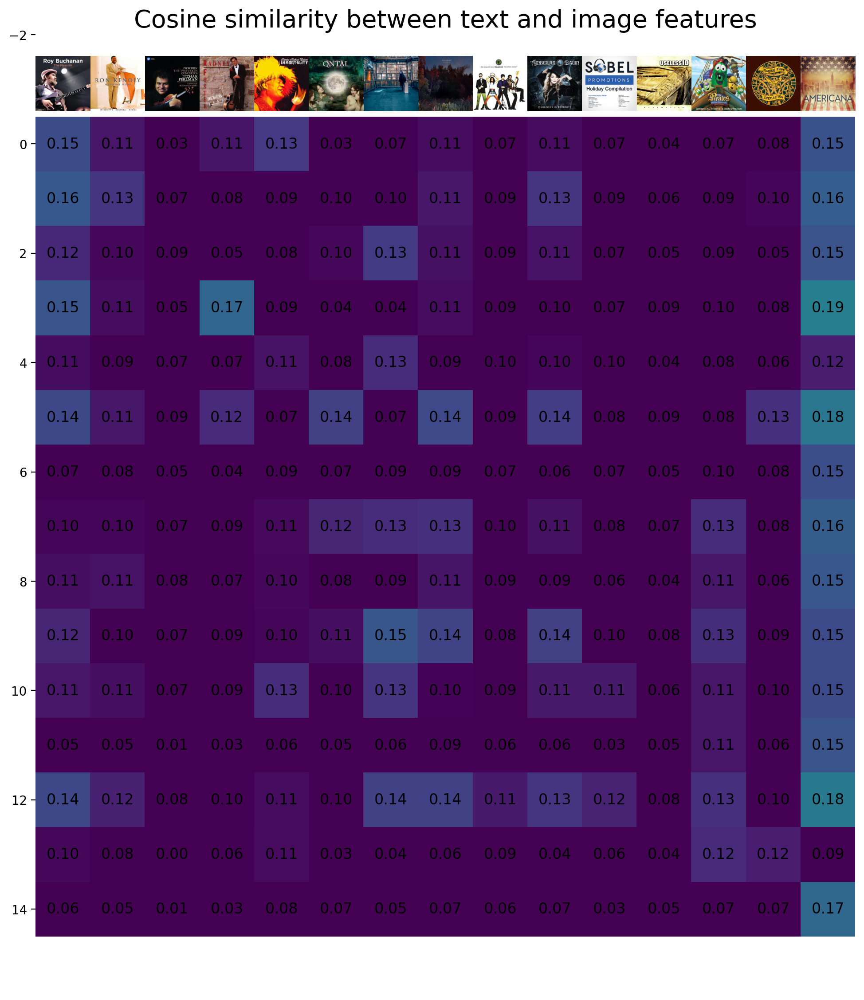

In [ ]:
count = len(descriptions)

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
# plt.colorbar()
# plt.yticks(range(count), texts, fontsize=18)
plt.xticks([])
for i, image in enumerate(original_images):
    plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])

plt.title("Cosine similarity between text and image features", size=20)

##### 2.5.3 Text Feature Optimization (testing)

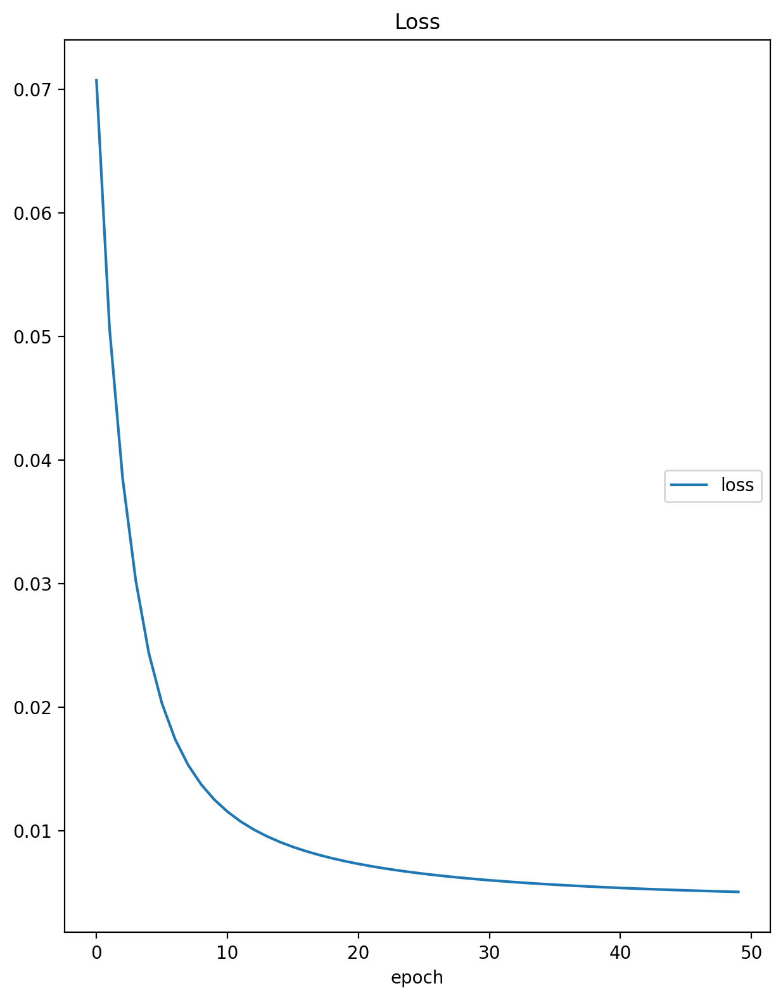

Loss
	loss             	 (min:    0.005, max:    0.071, cur:    0.005)
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])
torch.Size([15, 15])


In [ ]:
# testing optimizing text_features only using 1 group of images

from livelossplot import PlotLosses

def freeze_model(model):
    for param in model.parameters():
        param.requires_grad = False

def tokens_to_similarity(input_text_features, image_features):
    normalized_input_text_features = input_text_features / input_text_features.norm(dim=-1, keepdim=True)
    similarity = normalized_input_text_features @ image_features.T

    return similarity.to(input_text_features.device)

freeze_model(model)

with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    image_features /= image_features.norm(dim=-1, keepdim=True)

input_text_features = text_features.clone().detach().requires_grad_(True)

n_epoch = 500
learningRate = 1e-3

liveloss = PlotLosses()
logs = {}

cost_function = torch.nn.MSELoss()
optimizer = torch.optim.Adam([input_text_features], lr = learningRate)

# genre_names.shape[0] = 15
true_similarity = torch.eye(genre_names.shape[0]).to('cuda')

for epoch in range(n_epoch):
    optimizer.zero_grad()

    if input_text_features.grad is not None:
        input_text_features.grad.zero_()

    pred_similarity = tokens_to_similarity(input_text_features, image_features)

    loss_recon = cost_function(pred_similarity, true_similarity.detach())
    loss = loss_recon
    loss.backward()
    logs['loss'] = loss.item()
    # print("epoch", epoch,"loss=",loss.item())

    optimizer.step()
    
    # Update the plot with new logging information.
    if epoch%10==0:
        liveloss.update(logs)
        liveloss.send()


In [ ]:
normalized_input_text_features = input_text_features / input_text_features.norm(dim=-1, keepdim=True)
similarity = normalized_input_text_features.cpu().detach().numpy() @ image_features.cpu().numpy().T

Text(0.5, 1.0, 'Cosine similarity between text and image features')

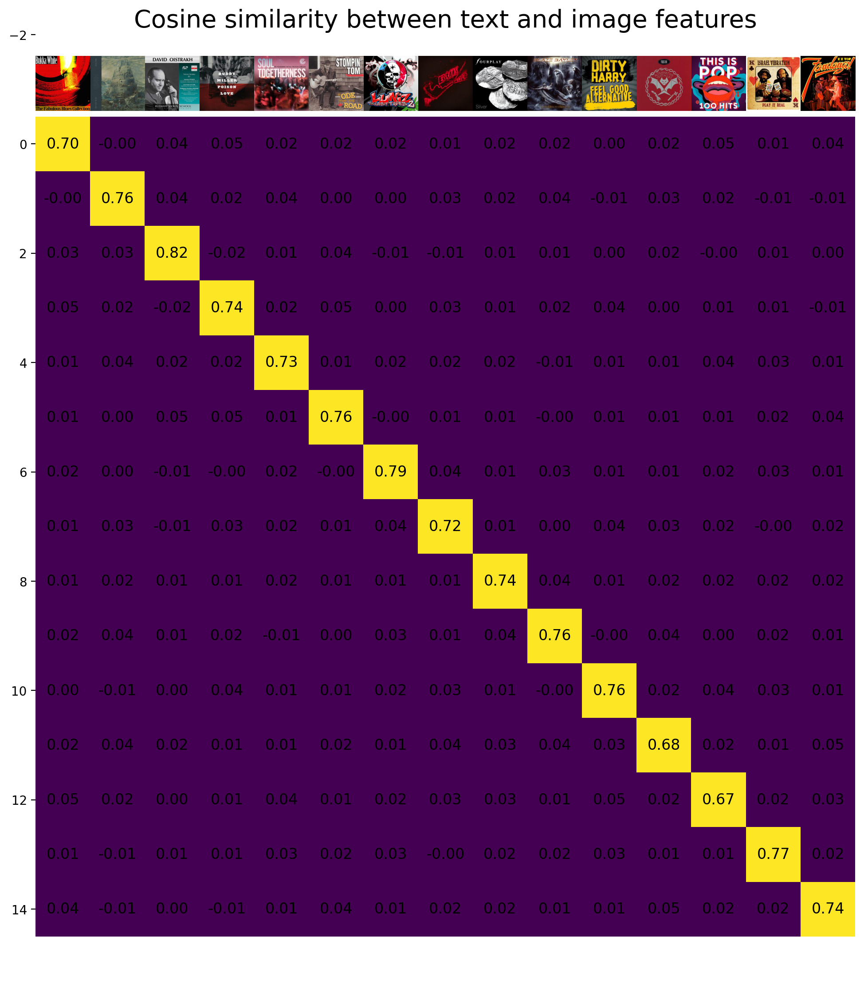

In [ ]:
count = len(descriptions)

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
# plt.colorbar()
# plt.yticks(range(count), texts, fontsize=18)
plt.xticks([])
for i, image in enumerate(original_images):
    plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])

plt.title("Cosine similarity between text and image features", size=20)

##### 2.5.4 Zero-Shot Image Classification

Classify images using the cosine similarity (times 100) as the logits to the softmax operation.

In [ ]:
text_descriptions = [f"This is a photo of a {label}" for label in valset.categories]
text_tokens = clip.tokenize(text_descriptions).cuda()

In [ ]:
with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)
top_probs, top_labels = text_probs.cpu().topk(5, dim=-1)

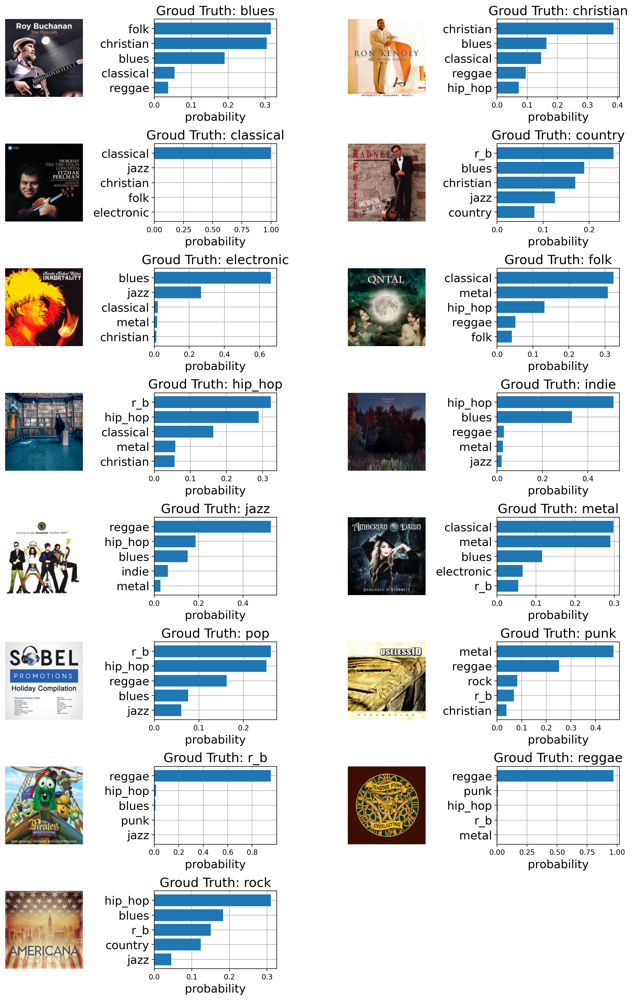

In [ ]:
## validate prediction for original images

plt.figure(figsize=(16, 24))

for i, image in enumerate(original_images):
    plt.subplot(8, 4, 2 * i + 1)
    plt.imshow(image)
    plt.axis("off")
    
    plt.subplot(8, 4, 2 * i + 2)
    y = np.arange(top_probs.shape[-1])
    plt.grid()
    plt.barh(y, top_probs[i])
    plt.gca().invert_yaxis()
    plt.gca().set_axisbelow(True)
    # plt.yticks(y, [valset.categories[index] for index in top_labels[i].numpy()])
    plt.yticks(y, [valset.categories[index] for index in top_labels[i].numpy()], fontsize=16)
    plt.xlabel("probability", fontsize=16)
    plt.title(f'Groud Truth: '+valset.categories[i], fontsize=18)

plt.subplots_adjust(wspace=0.4)
plt.subplots_adjust(hspace=0.6)

plt.savefig('zero_shot_examples.pdf', format='pdf')
plt.show()

#### 2.6a Make predictions on the whole validation dataset

In [ ]:
# setup val data loader

class Flatten(object):
  def __call__(self, input_tensor):
    return input_tensor.view(224 * 224 * 3)

transform = transforms.Compose([transforms.Resize((224, 224)),
                                transforms.ToTensor(),
                                Flatten()])

valset = album_cover_loader(folder_name = val_folder_name, split = '', transform = transform)

batch_size = 50

val_loader = torch.utils.data.DataLoader(valset, 
                                         batch_size = batch_size, 
                                         shuffle = False)

In [ ]:
# encode descriptions

texts = []

for idx in range(len(image_exp_list)):
    name = valset.categories[idx]
    texts.append(descriptions[name])

text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()

text_features /= text_features.norm(dim=-1, keepdim=True)

In [ ]:
## make predictions by comparing encoded images and text descriptions

results_all = []

for (batch_id, (xb, yb)) in enumerate(val_loader):
    image_input = xb.reshape(-1,3,224,224).cuda()

    with torch.no_grad():
        image_features = model.encode_image(image_input).float()
    
    image_features /= image_features.norm(dim=-1, keepdim=True)

    text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    top_probs, top_labels = text_probs.cpu().topk(5, dim=-1)
    all_probs, all_labels = text_probs.cpu().topk(len(valset.categories), dim=-1)

    results_all.append( (all_probs,all_labels,yb) )


#### 2.6b Obtain probabilities and plot histograms

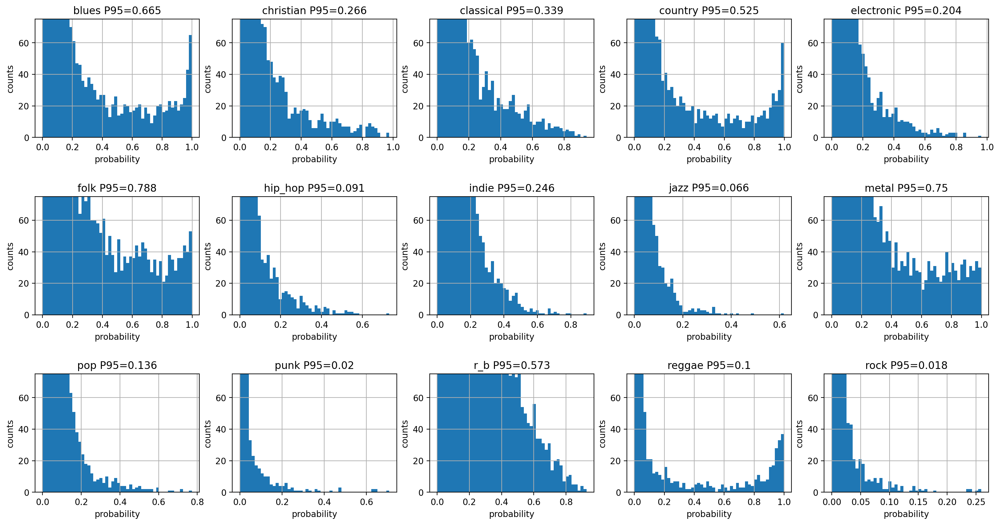

In [ ]:
### obtain predicted probabilities for each genre and plot

n_data = len(results_all) * batch_size
n_label = len(valset.categories)
probs_all = np.zeros( (n_label, n_data) )

for idx1 in range(len(results_all)):
    for idx2 in range(batch_size):
        for idx3 in range(n_label):
            probs_all[results_all[idx1][1][idx2][idx3], idx1*batch_size+idx2] = results_all[idx1][0][idx2][idx3]

plt.figure(figsize=(20, 10))

for idx in range(n_label):
    
    P95 = round(np.percentile(probs_all[idx,:], 95),3)

    plt.subplot(3, 5, idx + 1)
    plt.hist(probs_all[idx,:], bins=50)
    plt.ylim(ymax = n_data//100, ymin = 0)

    plt.grid()
    plt.title(valset.categories[idx]+" P95="+str(P95))
    plt.xlabel("probability")
    plt.ylabel("counts")

plt.subplots_adjust(hspace=0.5)
plt.show()

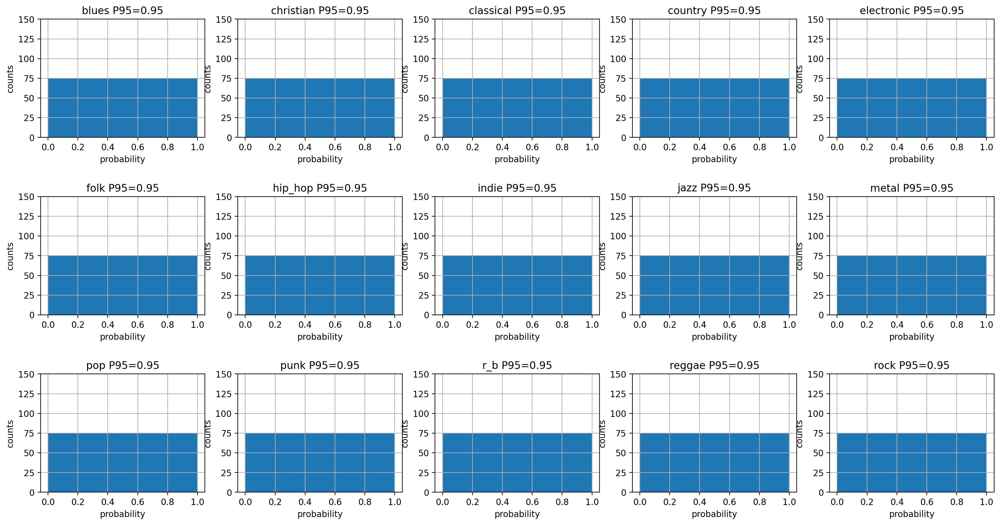

In [ ]:
# convert distribution to uniform

probs_all_new = np.zeros( (n_label, n_data) )

# for idx in range(n_label):
for idx in range(n_label):
    # obtain ranking in ascending order
    ranking = np.argsort(np.argsort(probs_all[idx,:]))
    ranking_min = np.min(ranking)
    ranking_max = np.max(ranking)
    relative_ranking = (ranking - ranking_min) / ranking_max
    probs_all_new[idx,:] = relative_ranking

    # print(probs_all[idx,:10])
    # print(ranking_min)
    # print(ranking_max)
    # print(ranking[:10])
    # print(relative_ranking[:10])

plt.figure(figsize=(20, 10))

for idx in range(n_label):
    
    P95 = round(np.percentile(probs_all_new[idx,:], 95),3)

    plt.subplot(3, 5, idx + 1)
    plt.hist(probs_all_new[idx,:], bins=100)
    plt.ylim(ymax = n_data//50, ymin = 0)

    plt.grid()
    plt.title(valset.categories[idx]+" P95="+str(P95))
    plt.xlabel("probability")
    plt.ylabel("counts")

plt.subplots_adjust(hspace=0.5)
plt.show()

##### 2.7b compute accuracies with the transform

In [ ]:
# calculate accuracy based on original genres

n_labels = len(valset.categories)

correct = 0
incorrect = 0
incorrect_info = []
confusion_matrix = np.zeros( (n_labels, n_labels) )

for idx1 in range(len(results_all)):
    for idx2 in range(batch_size):
        probs = probs_all_new[:,idx1*batch_size+idx2]
        pred = np.argmax(probs)
        true = results_all[idx1][2][idx2].item()

        confusion_matrix[true, pred] += 1

        if pred == true:
            correct += 1
        else:
            incorrect += 1
            incorrect_info.append( (valset.categories[pred], valset.categories[true]) )

accuracy = correct / (correct+incorrect)
confusion_matrix_df = pd.DataFrame(confusion_matrix, columns=valset.categories, index=valset.categories)

print("total=",correct+incorrect)
print("accuracy=",accuracy)

total= 7500
accuracy= 0.3468


In [ ]:
confusion_matrix_df

,blues,christian,classical,country,electronic,folk,hip_hop,indie,jazz,metal,pop,punk,r_b,reggae,rock
blues,326.0,11.0,12.0,17.0,13.0,30.0,1.0,10.0,21.0,6.0,10.0,4.0,14.0,17.0,8.0
christian,25.0,224.0,17.0,24.0,11.0,36.0,13.0,25.0,18.0,17.0,15.0,24.0,17.0,9.0,25.0
classical,2.0,10.0,271.0,2.0,2.0,105.0,0.0,6.0,87.0,5.0,3.0,0.0,5.0,1.0,1.0
country,39.0,22.0,10.0,326.0,8.0,27.0,0.0,11.0,18.0,7.0,10.0,5.0,6.0,7.0,4.0
electronic,8.0,21.0,38.0,5.0,73.0,21.0,36.0,37.0,18.0,81.0,36.0,41.0,37.0,10.0,38.0
folk,47.0,33.0,18.0,105.0,13.0,164.0,2.0,22.0,27.0,16.0,10.0,11.0,13.0,12.0,7.0
hip_hop,10.0,8.0,13.0,5.0,32.0,18.0,182.0,22.0,4.0,68.0,35.0,15.0,55.0,18.0,15.0
indie,11.0,38.0,41.0,26.0,45.0,106.0,16.0,80.0,25.0,26.0,15.0,22.0,26.0,10.0,13.0
jazz,87.0,45.0,54.0,19.0,22.0,32.0,5.0,16.0,97.0,5.0,40.0,7.0,60.0,8.0,3.0
metal,0.0,17.0,9.0,6.0,20.0,46.0,15.0,20.0,2.0,253.0,11.0,33.0,11.0,4.0,53.0


In [ ]:
print("Total number of predictions for each genre:")
print(confusion_matrix_df.sum(axis=0))

Total number of predictions for each genre:
blues         668.0
christian     546.0
classical     560.0
country       647.0
electronic    467.0
folk          751.0
hip_hop       343.0
indie         422.0
jazz          433.0
metal         651.0
pop           404.0
punk          305.0
r_b           562.0
reggae        444.0
rock          297.0
dtype: float64


In [ ]:
# calculate top 3 accuracy based on original genres

# set top n accuracy
top_n = 3

n_labels = len(valset.categories)

correct = 0
incorrect = 0

for idx1 in range(len(results_all)):
    for idx2 in range(batch_size):
        probs = probs_all_new[:,idx1*batch_size+idx2]
        # top n accuracy
        label_idx = np.argsort(probs)[-top_n:]
        true_idx = results_all[idx1][2][idx2].item()

        if true_idx in label_idx:
            correct += 1
        else:
            incorrect += 1

accuracy = correct / (correct+incorrect)

print("total=",correct+incorrect)
print("accuracy=",accuracy)

total= 7500
accuracy= 0.5861333333333333


#### 2.6c Text feature optimization on training dataset and make predictions


##### data loader and functions

In [ ]:
# setup val data loader

class Flatten(object):
  def __call__(self, input_tensor):
    return input_tensor.view(224 * 224 * 3)

transform = transforms.Compose([transforms.Resize((224, 224)),
                                transforms.ToTensor(),
                                Flatten()])

batch_size = 50

trainset = album_cover_loader(folder_name = train_folder_name, split = '', transform = transform)
train_loader = torch.utils.data.DataLoader(trainset, batch_size = batch_size, shuffle = True)

valset = album_cover_loader(folder_name = val_folder_name, split = '', transform = transform)
val_loader = torch.utils.data.DataLoader(valset, batch_size = batch_size, shuffle = False)

In [ ]:
def freeze_model(model):
    for param in model.parameters():
        param.requires_grad = False

def tokens_to_similarity(input_text_features, image_features):
    normalized_input_text_features = input_text_features / input_text_features.norm(dim=-1, keepdim=True)
    similarity = normalized_input_text_features @ image_features.T
    return similarity.to(input_text_features.device)

##### Training (feature optimization)

In [ ]:
# encode descriptions

texts = []

for idx in range(len(image_exp_list)):
    name = valset.categories[idx]
    texts.append(descriptions[name])

text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()

text_features /= text_features.norm(dim=-1, keepdim=True)

In [ ]:
from livelossplot import PlotLosses

freeze_model(model)

input_text_features = text_features.clone().detach().requires_grad_(True)

n_epoch = 20
learningRate = 2e-4

liveloss = PlotLosses()
logs = {}

cost_function = torch.nn.MSELoss()
optimizer = torch.optim.Adam([input_text_features], lr = learningRate)
# optimizer = torch.optim.SGD([input_text_features], lr = learningRate)

n_class = 15

for epoch in range(n_epoch):
    cumulative_loss = 0

    for (batch_id, (xb, yb)) in enumerate(train_loader):
        optimizer.zero_grad()

        if input_text_features.grad is not None:
            input_text_features.grad.zero_()

        # obtain image features
        image_input = xb.reshape(-1,3,224,224).cuda()

        with torch.no_grad():
            image_features = model.encode_image(image_input).float()
        
        image_features /= image_features.norm(dim=-1, keepdim=True)

        # measure similarity
        true_similarity = torch.zeros(n_class, batch_size).to('cuda')
        for ib in range(yb.shape[0]):
            true_similarity[ yb[ib], ib ] = 1

        pred_similarity = tokens_to_similarity(input_text_features, image_features)

        # loss and backward
        loss_recon = cost_function(pred_similarity, true_similarity.detach())
        loss = loss_recon
        loss.backward()

        cumulative_loss += loss.item()
        n_batches = 1 + batch_id 
        logs['loss'] = 10 * cumulative_loss / n_batches
        # print("epoch", epoch,"loss=",loss.item())

        optimizer.step()
        
        # Update the plot with new logging information.
        if batch_id%10 == 0:
            liveloss.update(logs)
            liveloss.send()


In [ ]:
## save input_feature
# torch.save(input_text_features,'input_text_features.pt')

##### Make prediction on training and validation dataset


In [ ]:
input_text_features = torch.load('input_text_features.pt')

In [ ]:
## make predictions on training set

results_train = []

for (batch_id, (xb, yb)) in enumerate(train_loader):
    image_input = xb.reshape(-1,3,224,224).cuda()

    with torch.no_grad():
        image_features = model.encode_image(image_input).float()
    
    image_features /= image_features.norm(dim=-1, keepdim=True)

    text_probs = (100.0 * image_features @ input_text_features.T).softmax(dim=-1)
    all_probs, all_labels = text_probs.cpu().topk(len(valset.categories), dim=-1)

    results_train.append( (all_probs,all_labels,yb) )


In [ ]:
# calculate accuracy based on original genres

n_labels = len(trainset.categories)

correct = 0
incorrect = 0
confusion_matrix = np.zeros( (n_labels, n_labels) )

for idx in range(len(results_train)):
    for idx2 in range(batch_size):
        pred = results_train[idx][1][idx2,0].item()
        true = results_train[idx][2][idx2].item()

        confusion_matrix[true, pred] += 1

        if pred == true:
            correct += 1
        else:
            incorrect += 1

accuracy = correct / (correct+incorrect)
confusion_matrix_df = pd.DataFrame(confusion_matrix, columns=trainset.categories, index=trainset.categories)

print("total=",correct+incorrect)
print("training accuracy=",accuracy)


total= 7500
training accuracy= 0.6002666666666666


In [ ]:
# calculate top 3 accuracy based on original genres

# set top n accuracy
top_n = 3

n_labels = len(trainset.categories)

correct = 0
incorrect = 0

for idx1 in range(len(results_train)):
    for idx2 in range(batch_size):
        probs = results_train[idx1][0][idx2,:].detach().numpy()
        # top n accuracy
        label_idx = results_train[idx1][1][idx2, np.argsort(probs)[-top_n:]]
        true_idx = results_train[idx1][2][idx2].item()

        if true_idx in label_idx:
            correct += 1
        else:
            incorrect += 1

accuracy = correct / (correct+incorrect)

print("total=",correct+incorrect)
print("training accuracy=",accuracy)

total= 7500
training accuracy= 0.8117333333333333


In [ ]:
## make predictions on validation data

results_all = []

for (batch_id, (xb, yb)) in enumerate(val_loader):
    image_input = xb.reshape(-1,3,224,224).cuda()

    with torch.no_grad():
        image_features = model.encode_image(image_input).float()
    
    image_features /= image_features.norm(dim=-1, keepdim=True)

    text_probs = (100.0 * image_features @ input_text_features.T).softmax(dim=-1)
    all_probs, all_labels = text_probs.cpu().topk(len(valset.categories), dim=-1)

    results_all.append( (all_probs,all_labels,yb) )


In [ ]:
torch.save(results_all,'results_all.py')

#### 2.7 Compute prediction accuracy and analyze errors

In [ ]:
# calculate accuracy based on original genres

n_labels = len(valset.categories)

correct = 0
incorrect = 0
incorrect_info = []
confusion_matrix = np.zeros( (n_labels, n_labels) )

for idx in range(len(results_all)):
    for idx2 in range(batch_size):
        pred = results_all[idx][1][idx2,0].item()
        true = results_all[idx][2][idx2].item()

        confusion_matrix[true, pred] += 1

        if pred == true:
            correct += 1
        else:
            incorrect += 1
            incorrect_info.append( (valset.categories[pred], valset.categories[true]) )

accuracy = correct / (correct+incorrect)
confusion_matrix_df = pd.DataFrame(confusion_matrix, columns=valset.categories, index=valset.categories)

print("total=",correct+incorrect)
print("validation accuracy=",accuracy)


total= 7500
validation accuracy= 0.3085333333333333


In [ ]:
# calculate top 3 accuracy based on original genres

# set top n accuracy
top_n = 3

n_labels = len(valset.categories)

correct = 0
incorrect = 0

for idx1 in range(len(results_all)):
    for idx2 in range(batch_size):
        probs = results_all[idx1][0][idx2,:].detach().numpy()
        # top n accuracy
        label_idx = results_all[idx1][1][idx2, np.argsort(probs)[-top_n:]]
        true_idx = results_all[idx1][2][idx2].item()

        if true_idx in label_idx:
            correct += 1
        else:
            incorrect += 1

accuracy = correct / (correct+incorrect)

print("total=",correct+incorrect)
print("validation accuracy=",accuracy)

total= 7500
validation accuracy= 0.7862666666666667


In [ ]:
# print out confusion matrix to QC wrong predictions
confusion_matrix_df
torch.save(confusion_matrix_df, 'confusion_matrix_df_relative_ranking.py')

In [ ]:
confusion_matrix_df.index

Index(['blues', 'christian', 'classical', 'country', 'electronic', 'folk',
       'hip_hop', 'indie', 'jazz', 'metal', 'pop', 'punk', 'r_b', 'reggae',
       'rock'],
      dtype='object')

In [ ]:
### compute per genre accuracy(precision)

genre_accuracy = np.zeros(n_labels)

for idx in range(n_labels):
    correct = confusion_matrix_df.iloc[idx,idx]
    all     = confusion_matrix_df.iloc[:,idx].sum()
    print(correct, all)
    genre_accuracy[idx] = correct/all

print(genre_accuracy)

367.0 577.0
277.0 472.0
484.0 714.0
355.0 574.0
193.0 388.0
175.0 281.0
376.0 625.0
261.0 663.0
259.0 409.0
364.0 676.0
88.0 269.0
246.0 491.0
298.0 629.0
330.0 396.0
150.0 336.0
[0.63604853 0.58686441 0.67787115 0.6184669  0.49742268 0.6227758
 0.6016     0.39366516 0.63325183 0.53846154 0.32713755 0.50101833
 0.47376789 0.83333333 0.44642857]


In [ ]:
num_predict_genre = confusion_matrix_df.sum(axis=0)
torch.save(num_predict_genre, 'num_predict_genre_relative_ranking.py')
print("Total number of predictions for each genre:")
print(confusion_matrix_df.sum(axis=0))

Total number of predictions for each genre:
blues         668.0
christian     546.0
classical     560.0
country       647.0
electronic    467.0
folk          751.0
hip_hop       343.0
indie         422.0
jazz          433.0
metal         651.0
pop           404.0
punk          305.0
r_b           562.0
reggae        444.0
rock          297.0
dtype: float64


#### Output prediction data

In [ ]:
# load data file
data_table = pd.read_csv('final_parent_genres_fixed.csv',
                   sep=',', header=0, index_col=0,error_bad_lines=False)
data_table.head(5)

<ipython-input-63-a7c4f1fcdf24>:2: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  data_table = pd.read_csv('final_parent_genres_fixed.csv',


,Genre,Artist,Album Name,URI,Image,Selected_Parent_Genre
0,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,San Diego 1989,spotify:album:4XVW50Jscloo7DGqbTuxSI,https://i.scdn.co/image/ab67616d00001e0220e656...,rock
1,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Heading North 53 NÂ° 8Â° E,spotify:album:0wk8LI6OGmJWivf6hKopeR,https://i.scdn.co/image/ab67616d00001e02b9ccc9...,rock
2,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Tales Of The New West,spotify:album:6toyhPRHSjBZYuBvorogOv,https://i.scdn.co/image/ab67616d00001e023ca375...,rock
3,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Best Of The Beat Farmers,spotify:album:4nI7uO3B7ja2n2Skm2H52G,https://i.scdn.co/image/ab67616d00001e02b459a4...,rock
4,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Loud and Plowed and... LIVE!,spotify:album:3DnGo1DUDP3O0Cynpplb1B,https://i.scdn.co/image/ab67616d00001e02df50b5...,rock


In [ ]:
val_data_list.head(5)

,genre,filename,file_path
0,blues,album10018.jpg,album_spotify_15genres_val/blues/album10018.jpg
1,blues,album10032.jpg,album_spotify_15genres_val/blues/album10032.jpg
2,blues,album10050.jpg,album_spotify_15genres_val/blues/album10050.jpg
3,blues,album10054.jpg,album_spotify_15genres_val/blues/album10054.jpg
4,blues,album101364.jpg,album_spotify_15genres_val/blues/album101364.jpg


In [ ]:
n_labels = len(valset.categories)

irow = 0
prediction_list = []
for idx1 in range(len(results_all)):
    for idx2 in range(batch_size):
        pred_label1 = results_all[idx1][1][idx2,0].item()
        pred_label2 = results_all[idx1][1][idx2,1].item()
        pred_label3 = results_all[idx1][1][idx2,2].item()
        index = val_data_list.loc[irow, 'file_path'].split('/')[2].split('.')[0].split('m')[1]
        pred1_str = valset.categories[pred_label1]
        pred2_str = valset.categories[pred_label2]
        pred3_str = valset.categories[pred_label3]
        prediction_list.append([index, pred1_str, pred2_str, pred3_str])
        irow += 1

In [ ]:
prediction_pd = pd.DataFrame(prediction_list)
prediction_pd.columns = ['Index','predicted_genre1','predicted_genre2','predicted_genre3']
prediction_pd['Index'] = prediction_pd['Index'].astype(int)
prediction_pd = prediction_pd.set_index('Index')
prediction_pd.head(5)

,predicted_genre1,predicted_genre2,predicted_genre3
Index,,,
10018,blues,rock,christian
10032,blues,country,folk
10050,blues,country,rock
10054,blues,country,folk
101364,electronic,country,folk


In [ ]:
prediction_pd.index

Int64Index([ 10018,  10032,  10050,  10054, 101364, 102261, 102282, 102287,
            103412, 103418,
            ...
             96038,  96539,  96788,  96824,  96927,  96929,  96933,  96937,
             97164,  97597],
           dtype='int64', name='Index', length=7500)

In [ ]:
data_table.index

Int64Index([     0,      1,      2,      3,      4,      5,      6,      7,
                 8,      9,
            ...
            136497, 136498, 136499, 136500, 136501, 136502, 136503, 136504,
            136505, 136506],
           dtype='int64', length=136507)

In [ ]:
# add predicted genre to the record and output
prediction_table = prediction_pd.join(data_table)
prediction_table.head(5)

,predicted_genre1,predicted_genre2,predicted_genre3,Genre,Artist,Album Name,URI,Image,Selected_Parent_Genre
Index,,,,,,,,,
10018,blues,rock,christian,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,The Messiah [Live (Remastered)],spotify:album:1GqXFkqjBFuuJarSonJC2i,https://i.scdn.co/image/ab67616d00001e02a52881...,blues
10032,blues,country,folk,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,American Axe: Live in 1974,spotify:album:34xJ86Z30ULu4zE5aoMYFZ,https://i.scdn.co/image/ab67616d00001e02bf8a8e...,blues
10050,blues,country,rock,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,20th Century Masters: The Millennium Collectio...,spotify:album:7kl2vwFJJXepwicNieWjL7,https://i.scdn.co/image/ab67616d00001e02ae48de...,blues
10054,blues,country,folk,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,Teeanage Heart,spotify:album:0DHLsFq8sxYaHZNor8qBCG,https://i.scdn.co/image/ab67616d00001e025c8912...,blues
101364,electronic,country,folk,"['gothic americana', 'lafayette indie', 'moder...",brother dege,Trailerville,spotify:album:5tAYxnQvzk1FTcMEESj7o4,https://i.scdn.co/image/ab67616d00001e02d5ef4f...,blues


In [ ]:
# save results
prediction_table.to_csv('valset_genres_prediction.csv')

#### Select random set of album covers for humman to classify

In [ ]:
val_folder_name = 'album_spotify_15genres_val'

In [ ]:
!unzip -q $val_folder_name".zip"
! ls $val_folder_name/*/* > val_data_file_paths
! cat val_data_file_paths | awk -F/ '{print $2","$3","$0}' > val_data_list.csv

In [ ]:
valset_genres_prediction = pd.read_csv('valset_genres_prediction.csv',
                   sep=',', header=0, index_col=0, error_bad_lines=False)
valset_genres_prediction.head(5)

<ipython-input-4-e4b350fb7fd5>:1: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  valset_genres_prediction = pd.read_csv('valset_genres_prediction.csv',


,predicted_genre,Genre,Artist,Album Name,URI,Image,Selected_Parent_Genre
Index,,,,,,,
10018,blues,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,The Messiah [Live (Remastered)],spotify:album:1GqXFkqjBFuuJarSonJC2i,https://i.scdn.co/image/ab67616d00001e02a52881...,blues
10032,blues,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,American Axe: Live in 1974,spotify:album:34xJ86Z30ULu4zE5aoMYFZ,https://i.scdn.co/image/ab67616d00001e02bf8a8e...,blues
10050,blues,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,20th Century Masters: The Millennium Collectio...,spotify:album:7kl2vwFJJXepwicNieWjL7,https://i.scdn.co/image/ab67616d00001e02ae48de...,blues
10054,blues,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,Teeanage Heart,spotify:album:0DHLsFq8sxYaHZNor8qBCG,https://i.scdn.co/image/ab67616d00001e025c8912...,blues
101364,electronic,"['gothic americana', 'lafayette indie', 'moder...",brother dege,Trailerville,spotify:album:5tAYxnQvzk1FTcMEESj7o4,https://i.scdn.co/image/ab67616d00001e02d5ef4f...,blues


In [ ]:
val_data_pd   = pd.read_csv('val_data_list.csv', header=None, names=['genre', 'filename', 'file_path'])
val_data_pd.head(5)

,genre,filename,file_path
0,blues,album10018.jpg,album_spotify_15genres_val/blues/album10018.jpg
1,blues,album10032.jpg,album_spotify_15genres_val/blues/album10032.jpg
2,blues,album10050.jpg,album_spotify_15genres_val/blues/album10050.jpg
3,blues,album10054.jpg,album_spotify_15genres_val/blues/album10054.jpg
4,blues,album101364.jpg,album_spotify_15genres_val/blues/album101364.jpg


In [ ]:
val_dir_names = val_data_pd['genre'].drop_duplicates()
print(val_dir_names.values)

['blues' 'christian' 'classical' 'country' 'electronic' 'folk' 'hip_hop'
 'indie' 'jazz' 'metal' 'pop' 'punk' 'r_b' 'reggae' 'rock']


In [ ]:
val_genre_names = valset_genres_prediction['Selected_Parent_Genre'].drop_duplicates()
print(val_genre_names.values)

['blues' 'christian' 'classical' 'country' 'electronic' 'folk' 'hip hop'
 'indie' 'jazz' 'metal' 'pop' 'punk' 'r&b' 'reggae' 'rock']


In [ ]:
### randomly select samples

n_sample = 5
selected_list = []
for idx, genre in enumerate(val_genre_names.values):
    selected_rows = valset_genres_prediction[valset_genres_prediction['Selected_Parent_Genre'] == genre].sample(n=n_sample, random_state=2023)
    selected_list.append( selected_rows.index.tolist() )

samples_list = []
for idx in range(len(selected_list)):
    genre_dir = val_dir_names.values[idx]
    for file_no in selected_list[idx]:
        file_path = val_folder_name + "/" + genre_dir + "/album" + str(file_no) + ".jpg"
        samples_list.append( (file_path, genre_dir) )

samples_list_cp = list(samples_list)
sorted_list = sorted(samples_list_cp, key=lambda x: x[0].split('/')[2].split('m')[1])

import random
random.seed(2023)
random.shuffle(samples_list)
# torch.save(samples_list,'samples_list.py')

In [ ]:
samples_list = torch.load('samples_list.py')

samples_list_cp = list(samples_list)
sorted_list = sorted(samples_list_cp, key=lambda x: x[0].split('/')[2].split('m')[1])

import random
random.seed(2023)
random.shuffle(samples_list)

In [ ]:
sorted_list

[('album_spotify_15genres_val/reggae/album103845.jpg', 'reggae'),
 ('album_spotify_15genres_val/folk/album106863.jpg', 'folk'),
 ('album_spotify_15genres_val/christian/album112605.jpg', 'christian'),
 ('album_spotify_15genres_val/country/album114715.jpg', 'country'),
 ('album_spotify_15genres_val/r_b/album11511.jpg', 'r_b'),
 ('album_spotify_15genres_val/punk/album115278.jpg', 'punk'),
 ('album_spotify_15genres_val/classical/album115492.jpg', 'classical'),
 ('album_spotify_15genres_val/indie/album115721.jpg', 'indie'),
 ('album_spotify_15genres_val/pop/album117290.jpg', 'pop'),
 ('album_spotify_15genres_val/blues/album117434.jpg', 'blues'),
 ('album_spotify_15genres_val/metal/album119059.jpg', 'metal'),
 ('album_spotify_15genres_val/rock/album1193.jpg', 'rock'),
 ('album_spotify_15genres_val/electronic/album120069.jpg', 'electronic'),
 ('album_spotify_15genres_val/hip_hop/album121534.jpg', 'hip_hop'),
 ('album_spotify_15genres_val/jazz/album12409.jpg', 'jazz'),
 ('album_spotify_15genre

In [ ]:
# copy samples images to a folder

folder_name = "image_samples"
!cd
!mkdir $folder_name

for sample in samples_list:
    path_from = sample[0]
    file_name = path_from.split('/')[2]
    path_to = folder_name + "/" + file_name
    !cp $path_from $path_to


In [ ]:
# make zip file
! zip -r image_samples.zip image_samples -q

In [ ]:
# generate ground truth dataframe

samples_list = torch.load('samples_list.py')
sorted_list = sorted(samples_list, key=lambda x: x[0].split('/')[2].split('.')[0].split('m')[1])
sorted_list_int = sorted([(int(x[0].split('/')[2].split('.')[0].split('m')[1]), x[1]) for x in sorted_list])

album_guess_ground_truth = []
for idx in range(len(sorted_list_int)):
    genre = sorted_list_int[idx][1]
    genre_id = np.where( val_dir_names.values == genre )[0][0]
    album_guess_ground_truth.append( (sorted_list_int[idx][0], genre, genre_id) )

album_guess_ground_truth_df = pd.DataFrame(album_guess_ground_truth, columns=['Index', 'genre','genre_id'])

album_guess_ground_truth_df

,Index,genre,genre_id
0,1193,rock,14
1,2401,punk,11
2,2616,jazz,8
3,5163,country,3
4,5496,electronic,4
...,...,...,...
70,129481,indie,7
71,131160,electronic,4
72,133780,punk,11
73,134890,country,3


In [ ]:
sorted_list_int

[(1193, 'rock'),
 (2401, 'punk'),
 (2616, 'jazz'),
 (5163, 'country'),
 (5496, 'electronic'),
 (5975, 'blues'),
 (8413, 'electronic'),
 (8591, 'hip_hop'),
 (8999, 'blues'),
 (11511, 'r_b'),
 (12409, 'jazz'),
 (14171, 'metal'),
 (14297, 'jazz'),
 (14671, 'christian'),
 (15811, 'r_b'),
 (16178, 'folk'),
 (16459, 'classical'),
 (16727, 'reggae'),
 (16986, 'rock'),
 (19667, 'blues'),
 (20820, 'indie'),
 (21791, 'hip_hop'),
 (22264, 'r_b'),
 (23331, 'christian'),
 (24406, 'pop'),
 (26305, 'country'),
 (27925, 'classical'),
 (28282, 'hip_hop'),
 (29262, 'metal'),
 (29623, 'electronic'),
 (29799, 'rock'),
 (30132, 'blues'),
 (50081, 'reggae'),
 (50450, 'christian'),
 (51310, 'rock'),
 (52187, 'punk'),
 (53523, 'classical'),
 (54036, 'r_b'),
 (54698, 'pop'),
 (54853, 'folk'),
 (55358, 'hip_hop'),
 (55763, 'jazz'),
 (57356, 'indie'),
 (59065, 'metal'),
 (79100, 'punk'),
 (81786, 'christian'),
 (83089, 'classical'),
 (84851, 'country'),
 (86117, 'indie'),
 (87518, 'rock'),
 (88662, 'pop'),
 (888

In [ ]:
# save ground truth
torch.save(album_guess_ground_truth_df,'album_guess_ground_truth_df.py')

In [ ]:
prediction_clip_all = pd.read_csv('valset_genres_prediction.csv', sep=',', header=0, index_col=0,error_bad_lines=False)
prediction_clip_all

<ipython-input-16-bc27e0dc71c3>:1: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  prediction_clip_all = pd.read_csv('valset_genres_prediction.csv', sep=',', header=0, index_col=0,error_bad_lines=False)


,predicted_genre,Genre,Artist,Album Name,URI,Image,Selected_Parent_Genre
Index,,,,,,,
10018,blues,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,The Messiah [Live (Remastered)],spotify:album:1GqXFkqjBFuuJarSonJC2i,https://i.scdn.co/image/ab67616d00001e02a52881...,blues
10032,blues,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,American Axe: Live in 1974,spotify:album:34xJ86Z30ULu4zE5aoMYFZ,https://i.scdn.co/image/ab67616d00001e02bf8a8e...,blues
10050,blues,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,20th Century Masters: The Millennium Collectio...,spotify:album:7kl2vwFJJXepwicNieWjL7,https://i.scdn.co/image/ab67616d00001e02ae48de...,blues
10054,blues,"['blues', 'blues rock', 'classic rock', 'elect...",roy buchanan,Teeanage Heart,spotify:album:0DHLsFq8sxYaHZNor8qBCG,https://i.scdn.co/image/ab67616d00001e025c8912...,blues
101364,electronic,"['gothic americana', 'lafayette indie', 'moder...",brother dege,Trailerville,spotify:album:5tAYxnQvzk1FTcMEESj7o4,https://i.scdn.co/image/ab67616d00001e02d5ef4f...,blues
...,...,...,...,...,...,...,...
96929,rock,"['jam band', 'progressive bluegrass', 'roots r...",jerry garcia band,Fall 1989: The Long Island Sound,spotify:album:2s0aiyDcjnzYpHZIMwxQ4G,https://i.scdn.co/image/ab67616d00001e028c61db...,rock
96933,rock,"['jam band', 'progressive bluegrass', 'roots r...",jerry garcia band,"Pure Jerry: Bay Area, 1978",spotify:album:3IZCBODINQuz3GJ9Weovwe,https://i.scdn.co/image/ab67616d00001e0213672f...,rock
96937,rock,"['jam band', 'progressive bluegrass', 'roots r...",jerry garcia band,"Pure Jerry: Merriweather Post Pavilion, Septem...",spotify:album:75iCRkPQixfr6THO2smbmK,https://i.scdn.co/image/ab67616d00001e025f3047...,rock


In [ ]:
image_indices = [sorted_list_int[idx][0] for idx in range(len(sorted_list_int))]
prediction_clip_75 = prediction_clip_all.loc[image_indices]
prediction_clip_75.to_csv('album_guess_clip.csv', index=False)

In [ ]:
image_indices = [sorted_list_int[idx][0] for idx in range(len(sorted_list_int))]
prediction_clip_75 = prediction_clip_all.loc[image_indices]
prediction_clip_75.to_csv('album_guess_clip_columns.csv', index=True)

#### Measure accuracy by human

In [ ]:
prediction_humman_3 = pd.read_excel('album_genre_guess_LEINWEBER.xlsx', sheet_name='Sheet1')
prediction_humman_3

,Album covers,Genre guess 1,Genre guess 2,Genre guess 3,please use number to represent genre guesses
0,NaN,5,3,7,"0: blues, 1: christian, 2: classical, 3: count..."
1,NaN,11,14,10,"0: blues, 1: christian, 2: classical, 3: count..."
2,NaN,14,8,10,"0: blues, 1: christian, 2: classical, 3: count..."
3,NaN,3,0,5,"0: blues, 1: christian, 2: classical, 3: count..."
4,NaN,9,14,11,"0: blues, 1: christian, 2: classical, 3: count..."
...,...,...,...,...,...
70,NaN,10,14,4,"0: blues, 1: christian, 2: classical, 3: count..."
71,NaN,10,14,11,"0: blues, 1: christian, 2: classical, 3: count..."
72,NaN,14,11,9,"0: blues, 1: christian, 2: classical, 3: count..."
73,NaN,1,0,3,"0: blues, 1: christian, 2: classical, 3: count..."


In [ ]:
prediction_clip_in = pd.read_csv('album_guess_clip.csv')
prediction_clip = prediction_humman_3.copy()

for idx in range(prediction_clip.shape[0]):
    id1 = list(val_dir_names.values).index(prediction_clip_in.loc[idx, 'predicted_genre1'])
    prediction_clip.at[idx, 'Genre guess 1'] = id1
    id2 = list(val_dir_names.values).index(prediction_clip_in.loc[idx, 'predicted_genre2'])
    prediction_clip.at[idx, 'Genre guess 2'] = id2
    id3 = list(val_dir_names.values).index(prediction_clip_in.loc[idx, 'predicted_genre3'])
    prediction_clip.at[idx, 'Genre guess 3'] = id3

prediction_clip.to_excel('album_genre_guess_clip.xlsx', index=False)


In [ ]:
# load ground truth and humman predictions
album_guess_ground_truth_df = torch.load('album_guess_ground_truth_df.py')
prediction_clip_in = pd.read_excel('album_genre_guess_clip.xlsx')

prediction_humman_1 = pd.read_excel('album_genre_guess_Liu.xlsx', sheet_name='Sheet1')
prediction_humman_2 = pd.read_excel('album_genre_guess_MEAUX.xlsx', sheet_name='Sheet1')
prediction_humman_3 = pd.read_excel('album_genre_guess_LEINWEBER.xlsx', sheet_name='Sheet1')
prediction_humman_4 = pd.read_excel('album_genre_guess_Chambers.xlsx', sheet_name='Sheet1')

prediction_humman_4

,Album covers,Genre guess 1,Genre guess 2,Genre guess 3,please use number to represent genre guesses
0,NaN,5,7,14,"0: blues, 1: christian, 2: classical, 3: count..."
1,NaN,11,14,9,"0: blues, 1: christian, 2: classical, 3: count..."
2,NaN,8,0,2,"0: blues, 1: christian, 2: classical, 3: count..."
3,NaN,3,1,0,"0: blues, 1: christian, 2: classical, 3: count..."
4,NaN,9,5,14,"0: blues, 1: christian, 2: classical, 3: count..."
...,...,...,...,...,...
70,NaN,10,12,1,"0: blues, 1: christian, 2: classical, 3: count..."
71,NaN,10,14,3,"0: blues, 1: christian, 2: classical, 3: count..."
72,NaN,14,11,10,"0: blues, 1: christian, 2: classical, 3: count..."
73,NaN,3,10,14,"0: blues, 1: christian, 2: classical, 3: count..."


In [ ]:
# measure accuracy

current_test = prediction_humman_4

n_sample = current_test.shape[0]
top1_count = 0
top3_count = 0
for idx in range(n_sample):
    id_true = album_guess_ground_truth_df.loc[idx,'genre_id']
    id_pred_1 = current_test.loc[idx,'Genre guess 1']
    id_pred_2 = current_test.loc[idx,'Genre guess 2']
    id_pred_3 = current_test.loc[idx,'Genre guess 3']

    if id_true == id_pred_1:
        top1_count += 1
    if id_true in [id_pred_1, id_pred_2, id_pred_3]:
        top3_count += 1

accuracy_top1 = top1_count/n_sample
accuracy_top3 = top3_count/n_sample

print("Top-1 accuracy=",accuracy_top1*100,"%")
print("Top-3 accuracy=",accuracy_top3*100,"%")


Top-1 accuracy= 45.33333333333333 %
Top-3 accuracy= 69.33333333333334 %


In [ ]:
clip_accuracy_top1 = [53.3]
clip_accuracy_top3 = [76.0]

humman_accuracu_top1 = [26.7, 48.0, 46.7, 45.3]
humman_accuracu_top3 = [45.3, 72.0, 65.3, 76.0]

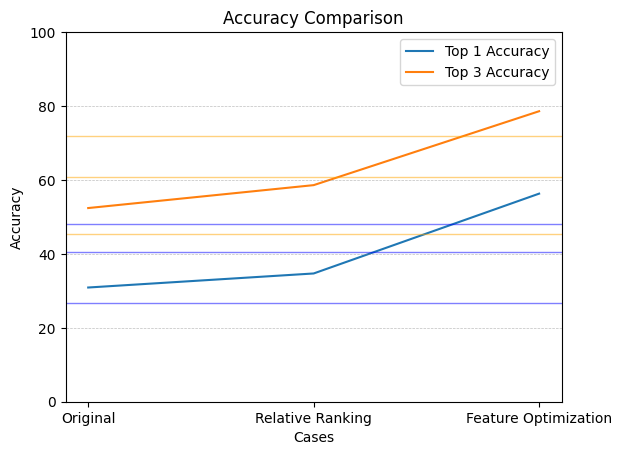

In [ ]:
# ViT-L/14 model
cases = ['Original','Relative Ranking','Feature Optimization']
# training top-1&top-3 accuracy: 60.0% and 81.2%
accuracy_top1 = [30.9, 34.7, 56.3]
accuracy_top3 = [52.4, 58.6, 78.6]

# Create the plot
plt.plot(cases, accuracy_top1, label='Top 1 Accuracy')
plt.plot(cases, accuracy_top3, label='Top 3 Accuracy')


plt.axhline(y=20, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)
plt.axhline(y=40, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)
plt.axhline(y=60, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)
plt.axhline(y=80, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)


# Add labels and legend
plt.xlabel('Cases')
plt.ylabel('Accuracy')
plt.title('Accuracy Comparison')
plt.legend()
plt.ylim([0,100])

# Display the plot
plt.savefig('accuracy_plot_new.pdf', format='pdf')
plt.show()

#### Make accuracy plots



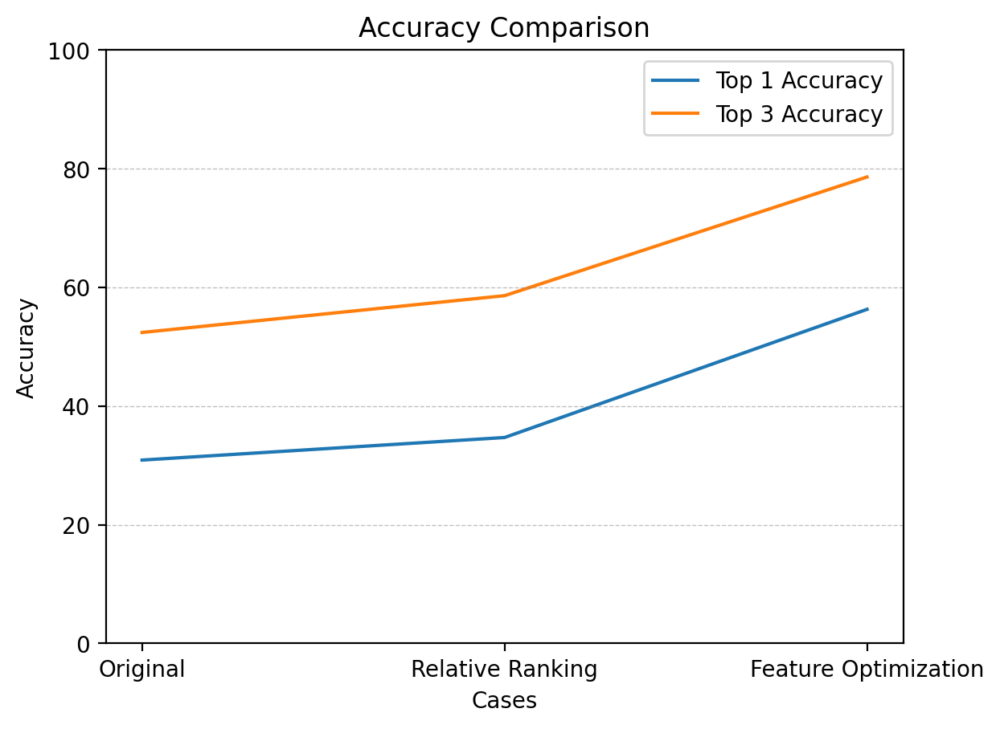

In [ ]:
# ViT-L/14 model
cases = ['Original','Relative Ranking','Feature Optimization']
# training top-1&top-3 accuracy: 60.0% and 81.2%
accuracy_top1 = [30.9, 34.7, 56.3]
accuracy_top3 = [52.4, 58.6, 78.6]

# Create the plot
plt.plot(cases, accuracy_top1, label='Top 1 Accuracy')
plt.plot(cases, accuracy_top3, label='Top 3 Accuracy')


plt.axhline(y=20, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)
plt.axhline(y=40, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)
plt.axhline(y=60, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)
plt.axhline(y=80, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)

# Add labels and legend
plt.xlabel('Cases')
plt.ylabel('Accuracy')
plt.title('Accuracy Comparison')
plt.legend()
plt.ylim([0,100])

# Display the plot
plt.savefig('accuracy_plot_new.pdf', format='pdf')
plt.show()

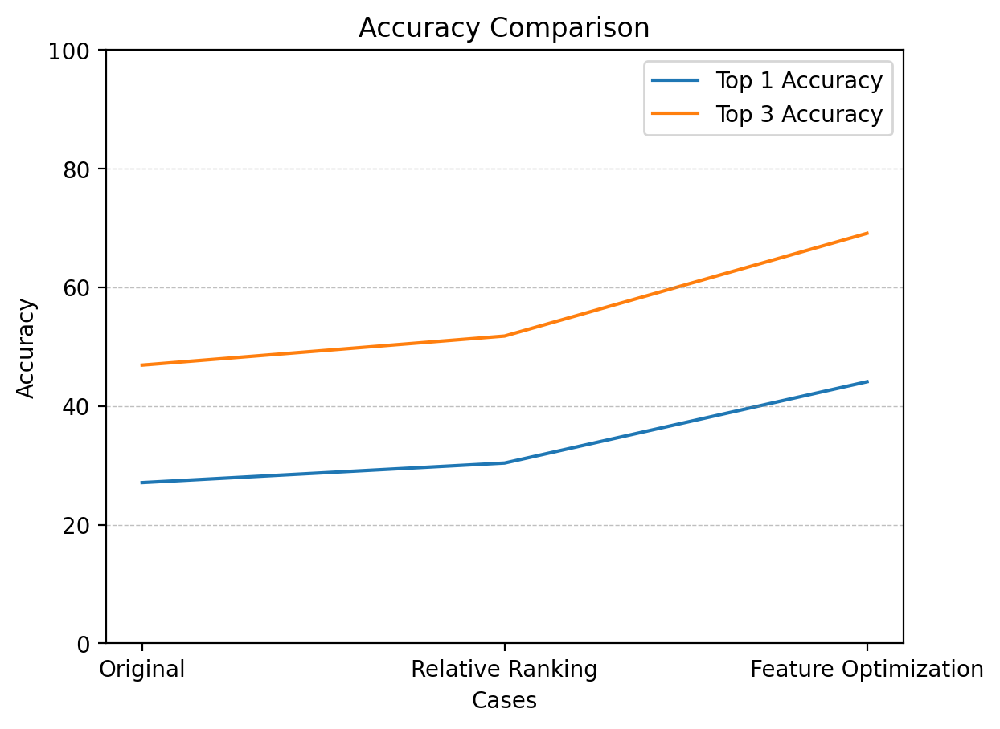

In [ ]:
# ViT-B/32 model
cases = ['Original','Relative Ranking','Feature Optimization']
accuracy_top1 = [27.1, 30.4, 44.1]
accuracy_top3 = [46.9, 51.8, 69.1]

# Create the plot
plt.plot(cases, accuracy_top1, label='Top 1 Accuracy')
plt.plot(cases, accuracy_top3, label='Top 3 Accuracy')


plt.axhline(y=20, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)
plt.axhline(y=40, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)
plt.axhline(y=60, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)
plt.axhline(y=80, color='gray', linestyle='--',linewidth=0.5, alpha=0.5)

# Add labels and legend
plt.xlabel('Cases')
plt.ylabel('Accuracy')
plt.title('Accuracy Comparison')
plt.legend()
plt.ylim([0,100])

# Display the plot
plt.savefig('accuracy_plot.pdf', format='pdf')
plt.show()

#### Make comparison plots

##### figure 1 album cover examples

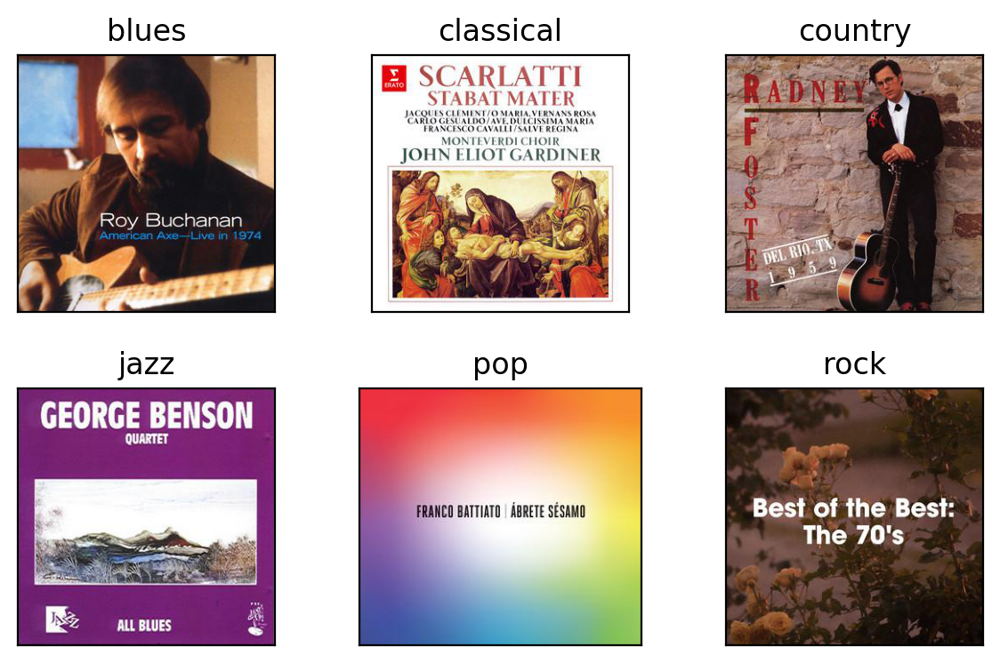

In [ ]:
### make plot using images in selected genres

valset = album_cover_loader(folder_name = val_folder_name, split = '')

n_class = len(valset.categories)

genres_selected = ['blues','classical','country','jazz','pop','rock']

example_images = []

current_id = [0,0,0,0,0,0]
target_id  = [2,3,1,3,2,2] ## in ragen 1-500

for (image, label) in valset:
    # only save first image in each category
    if valset.categories[label] in genres_selected:
        genre_idx = genres_selected.index(valset.categories[label])
        current_id[genre_idx] += 1
        if target_id[genre_idx] == current_id[genre_idx]:
            example_images.append( image )
        elif target_id[genre_idx] < current_id[genre_idx]:
            continue


plt.figure(figsize=(6, 4))

counter = 1
for idx, image in enumerate(example_images):
    plt.subplot(2, 3, idx+1)
    plt.imshow(image)
    plt.title(f"{genres_selected[idx]}")
    plt.xticks([])
    plt.yticks([])


plt.subplots_adjust(wspace=0.2)
plt.subplots_adjust(hspace=0.3)

# Add white space at the bottom
left_margin   = 0.05  # adjust this value to increase or decrease the left margin
right_margin  = 0.99  # adjust this value to increase or decrease the right margin
bottom_margin = 0.05  # adjust this value to increase or decrease the white space
plt.subplots_adjust(left=left_margin, right=right_margin, bottom=bottom_margin)

plt.savefig('album_cover_examples.pdf', format='pdf')
plt.show()

##### figure 5 number of prediections per genre

In [ ]:
### compare predicted genre distribution for initial, after balance and after embedding optimization
num_predict_genre_original = torch.load('num_predict_genre_original.py')
num_predict_genre_relative = torch.load('num_predict_genre_relative_ranking.py')
num_predict_genre_optimization = torch.load('num_predict_genre_feature_optimization.py')

df_hist = pd.DataFrame({'Original': num_predict_genre_original, 'Relative Ranking': num_predict_genre_relative, 'Feature Optimization': num_predict_genre_optimization}).T
df_hist

,blues,christian,classical,country,electronic,folk,hip_hop,indie,jazz,metal,pop,punk,r_b,reggae,rock
Original,759.0,344.0,445.0,542.0,212.0,1350.0,63.0,302.0,21.0,1167.0,85.0,19.0,1915.0,275.0,1.0
Relative Ranking,668.0,546.0,560.0,647.0,467.0,751.0,343.0,422.0,433.0,651.0,404.0,305.0,562.0,444.0,297.0
Feature Optimization,577.0,472.0,714.0,574.0,388.0,281.0,625.0,663.0,409.0,676.0,269.0,491.0,629.0,396.0,336.0


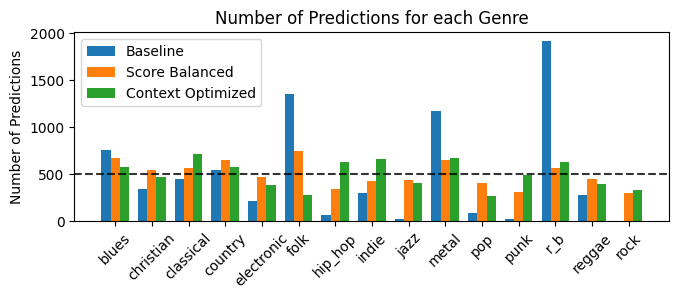

In [ ]:
### make plot
plt.figure(figsize=(7,3))

bar_width = 0.25
index = range(len(df_hist.columns))

plt.bar([i - bar_width for i in index], df_hist.loc['Original'], width=bar_width, label='Baseline', alpha=1.0)
plt.bar([i for i in index], df_hist.loc['Relative Ranking'], width=bar_width, label='Score Balanced', alpha=1.0)
plt.bar([i + bar_width for i in index], df_hist.loc['Feature Optimization'], width=bar_width, label='Context Optimized', alpha=1.0)
plt.axhline(y=500, linestyle='--', color='black', alpha=0.8)
plt.xticks([i for i in index], df_hist.columns, rotation=45)
plt.ylabel('Number of Predictions')
plt.title('Number of Predictions for each Genre')
plt.legend(fontsize='medium')

# Add white space at the bottom
left_margin   = 0.10  # adjust this value to increase or decrease the left margin
right_margin  = 0.95  # adjust this value to increase or decrease the right margin
bottom_margin = 0.25  # adjust this value to increase or decrease the white space
plt.subplots_adjust(left=left_margin, right=right_margin, bottom=bottom_margin)

plt.savefig('n_prediction_genre.pdf', format='pdf')
plt.show()

##### figure 6 precision per genre

In [ ]:
### compare prediction accuracy for initial, after balance and after embedding optimization

confusion_matrix_original = torch.load('confusion_matrix_df_original.py')
confusion_matrix_relative = torch.load('confusion_matrix_df_relative_ranking.py')
confusion_matrix_optimization = torch.load('confusion_matrix_df_feature_optimization.py')
# n_labels = 15

genre_accuracy_all = np.zeros((3,n_labels))

for idx in range(n_labels):
    correct = confusion_matrix_original.iloc[idx,idx]
    all     = confusion_matrix_original.iloc[:,idx].sum()
    genre_accuracy_all[0,idx] = correct/all

    correct = confusion_matrix_relative.iloc[idx,idx]
    all     = confusion_matrix_relative.iloc[:,idx].sum()
    genre_accuracy_all[1,idx] = correct/all

    correct = confusion_matrix_optimization.iloc[idx,idx]
    all     = confusion_matrix_optimization.iloc[:,idx].sum()
    genre_accuracy_all[2,idx] = correct/all

df_accuracy = pd.DataFrame({'Original': genre_accuracy_all[0,:], 'Relative Ranking': genre_accuracy_all[1,:], 'Feature Optimization': genre_accuracy_all[2,:]}).T
df_accuracy.columns = df_hist.columns
df_accuracy

,blues,christian,classical,country,electronic,folk,hip_hop,indie,jazz,metal,pop,punk,r_b,reggae,rock
Original,0.438735,0.514535,0.530337,0.566421,0.150943,0.177778,0.587302,0.168874,0.047619,0.281919,0.164706,0.842105,0.155091,0.887273,0.000000
Relative Ranking,0.488024,0.410256,0.483929,0.503864,0.156317,0.218375,0.530612,0.189573,0.224018,0.388633,0.146040,0.311475,0.250890,0.628378,0.104377
Feature Optimization,0.636049,0.586864,0.677871,0.618467,0.497423,0.622776,0.601600,0.393665,0.633252,0.538462,0.327138,0.501018,0.473768,0.833333,0.446429


In [ ]:
accuracy_original = np.trace(confusion_matrix_original.to_numpy())/7500
accuracy_relative = np.trace(confusion_matrix_relative.to_numpy())/7500
accuracy_optimization = np.trace(confusion_matrix_optimization.to_numpy())/7500
print("Overall accuracy for Original is:",round(accuracy_original*100,2))
print("Overall accuracy for Relative Ranking is:",round(accuracy_relative*100,2))
print("Overall accuracy for Feature Optimization is:",round(accuracy_optimization*100,2))

Overall accuracy for Original is: 30.85
Overall accuracy for Relative Ranking is: 34.68
Overall accuracy for Feature Optimization is: 56.31


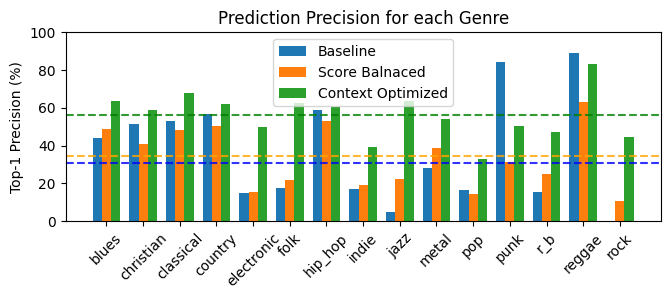

In [ ]:
### make plot
plt.figure(figsize=(7,3))

bar_width = 0.25
index = range(len(df_accuracy.columns))

plt.bar([i - bar_width for i in index], 100*df_accuracy.loc['Original'],             width=bar_width, label='Baseline', alpha=1.0)
plt.bar([i for i in index],             100*df_accuracy.loc['Relative Ranking'],     width=bar_width, label='Score Balnaced', alpha=1.0)
plt.bar([i + bar_width for i in index], 100*df_accuracy.loc['Feature Optimization'], width=bar_width, label='Context Optimized', alpha=1.0)

plt.axhline(y=accuracy_original*100, linestyle='--', color='blue', alpha=0.8)
plt.axhline(y=accuracy_relative*100, linestyle='--', color='orange', alpha=0.8)
plt.axhline(y=accuracy_optimization*100, linestyle='--', color='green', alpha=0.8)

plt.xticks([i for i in index], df_accuracy.columns, rotation=45)
plt.ylabel('Top-1 Precision (%)')
plt.title('Prediction Precision for each Genre')
plt.legend(fontsize='medium')
ax = plt.gca()
ax.set_ylim([0,100])

# Add white space at the bottom
left_margin   = 0.10  # adjust this value to increase or decrease the left margin
right_margin  = 0.95  # adjust this value to increase or decrease the right margin
bottom_margin = 0.25  # adjust this value to increase or decrease the white space
plt.subplots_adjust(left=left_margin, right=right_margin, bottom=bottom_margin)

plt.savefig('top1_precision_genre.pdf', format='pdf')
plt.show()

##### figure 7 CLIP v.s. Human

In [ ]:
### load CLIP v.s. human data
example_analysis = pd.read_excel('album_genre_guess_selected_for_plot.xlsx')
example_analysis.loc[0,'Album covers'] = 54698
example_analysis.loc[1,'Album covers'] = 54036
example_analysis.loc[2,'Album covers'] = 93497
example_analysis.loc[3,'Album covers'] = 119059
example_analysis

,Album covers,Ground Truth,CLIP 1,CLIP 2,CLIP 3,Genre guess 1,Genre guess 2,Genre guess 3,Genre guess 1.1,Genre guess 2.1,Genre guess 3.1,Genre guess 1.2,Genre guess 2.2,Genre guess 3.2,Genre guess 1.3,Genre guess 2.3,Genre guess 3.3,please use number to represent genre guesses
0,54698.0,10,5,3,7,5,10,0,5,10,3,5,10,14,5,10,12,"0: blues, 1: christian, 2: classical, 3: count..."
1,54036.0,12,12,6,13,6,12,13,12,10,6,6,12,10,5,6,12,"0: blues, 1: christian, 2: classical, 3: count..."
2,93497.0,8,12,4,10,5,7,10,12,2,7,1,10,5,7,3,8,"0: blues, 1: christian, 2: classical, 3: count..."
3,119059.0,9,4,9,7,2,11,10,14,7,1,4,10,14,4,10,7,"0: blues, 1: christian, 2: classical, 3: count..."


In [ ]:
#### find images

file1_path = "album_spotify_15genres_val/pop/album54698.jpg"
file2_path = "album_spotify_15genres_val/r_b/album54036.jpg"
file3_path = "album_spotify_15genres_val/jazz/album93497.jpg"
file4_path = "album_spotify_15genres_val/metal/album119059.jpg"
file_paths = [file1_path, file2_path, file3_path, file4_path]

image_example = []
for idx, path in enumerate(file_paths):
    image_cur = Image.open(path)
    image_example.append(image_cur)

example_analysis['Human 1'] = [5, 6, 7, 0]
example_analysis['Human 2'] = [10, 12, 5, 10]
example_analysis['Human 3'] = [7, 10, 12, 14]

example_analysis

,Album covers,Ground Truth,CLIP 1,CLIP 2,CLIP 3,Genre guess 1,Genre guess 2,Genre guess 3,Genre guess 1.1,Genre guess 2.1,...,Genre guess 1.2,Genre guess 2.2,Genre guess 3.2,Genre guess 1.3,Genre guess 2.3,Genre guess 3.3,please use number to represent genre guesses,Human 1,Human 2,Human 3
0,54698.0,10,5,3,7,5,10,0,5,10,...,5,10,14,5,10,12,"0: blues, 1: christian, 2: classical, 3: count...",5,10,7
1,54036.0,12,12,6,13,6,12,13,12,10,...,6,12,10,5,6,12,"0: blues, 1: christian, 2: classical, 3: count...",6,12,10
2,93497.0,8,12,4,10,5,7,10,12,2,...,1,10,5,7,3,8,"0: blues, 1: christian, 2: classical, 3: count...",7,5,12
3,119059.0,9,4,9,7,2,11,10,14,7,...,4,10,14,4,10,7,"0: blues, 1: christian, 2: classical, 3: count...",0,10,14


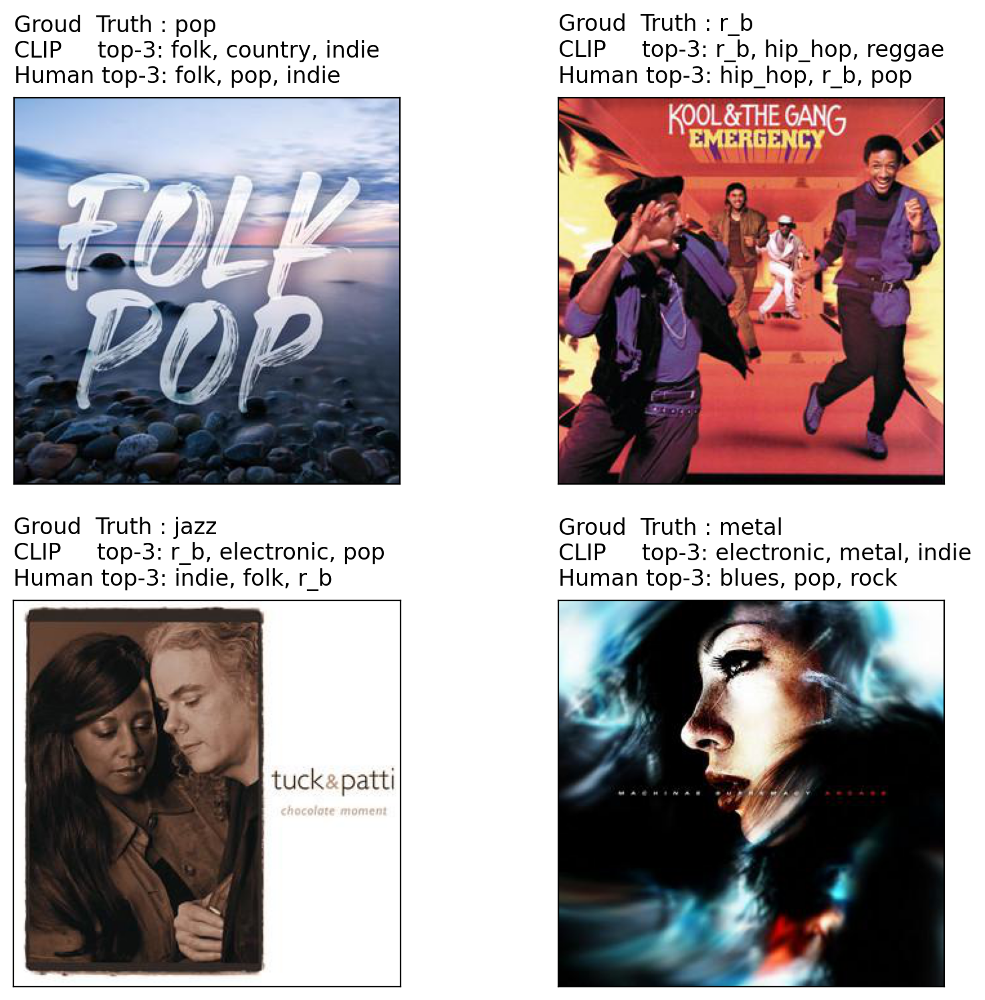

In [ ]:
### plot images
# plt.figure(figsize=(6, 6))

# Create a 2x2 grid of subplots
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 8))
plot_positions = [(0, 0), (0, 1), (1, 0), (1, 1)]

for idx, image in enumerate(image_example):
    row, col = plot_positions[idx]
    ax = axes[row, col]

    true1 = valset.categories[example_analysis.loc[idx,'Ground Truth']]
    true = "Groud  Truth : " + true1

    clip_pred1 = valset.categories[example_analysis.loc[idx,'CLIP 1']]
    clip_pred2 = valset.categories[example_analysis.loc[idx,'CLIP 2']]
    clip_pred3 = valset.categories[example_analysis.loc[idx,'CLIP 3']]
    clip_pred = "CLIP     top-3: " + clip_pred1 + ", " + clip_pred2 + ", " + clip_pred3

    human_pred1 = valset.categories[example_analysis.loc[idx,'Human 1']]
    human_pred2 = valset.categories[example_analysis.loc[idx,'Human 2']]
    human_pred3 = valset.categories[example_analysis.loc[idx,'Human 3']]
    human_pred = "Human top-3: " + human_pred1 + ", " + human_pred2 + ", " + human_pred3

    ax.imshow(image)
    title = f'{true}\n{clip_pred}\n{human_pred}'
    ax.set_title(title, y=1.01, fontsize=12, loc='left')

    ax.set_xticks([])
    ax.set_yticks([])
    
plt.subplots_adjust(wspace=0.3)
plt.subplots_adjust(hspace=0.3)

# Add white space at the bottom
left_margin   = 0.05  # adjust this value to increase or decrease the left margin
right_margin  = 0.95  # adjust this value to increase or decrease the right margin
bottom_margin = 0.05  # adjust this value to increase or decrease the white space
plt.subplots_adjust(left=left_margin, right=right_margin, bottom=bottom_margin)

plt.savefig('clip_human_examples.pdf', format='pdf')
plt.show()

### 3. CLIP prediction of selected group of images


#### Image selection for 
Garth Brooks - country

Rolling Stones - rock

Michael Jackson - pop

Vivaldi - classical

In [ ]:
# load data file
data_table = pd.read_csv('final_parent_genres_fixed.csv',
                   sep=',', header=0, index_col=0,error_bad_lines=False)
data_table.head(5)

<ipython-input-62-a7c4f1fcdf24>:2: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  data_table = pd.read_csv('final_parent_genres_fixed.csv',


,Genre,Artist,Album Name,URI,Image,Selected_Parent_Genre
0,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,San Diego 1989,spotify:album:4XVW50Jscloo7DGqbTuxSI,https://i.scdn.co/image/ab67616d00001e0220e656...,rock
1,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Heading North 53 NÂ° 8Â° E,spotify:album:0wk8LI6OGmJWivf6hKopeR,https://i.scdn.co/image/ab67616d00001e02b9ccc9...,rock
2,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Tales Of The New West,spotify:album:6toyhPRHSjBZYuBvorogOv,https://i.scdn.co/image/ab67616d00001e023ca375...,rock
3,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Best Of The Beat Farmers,spotify:album:4nI7uO3B7ja2n2Skm2H52G,https://i.scdn.co/image/ab67616d00001e02b459a4...,rock
4,"['cowpunk', 'pub rock', 'roots rock']",beat farmers,Loud and Plowed and... LIVE!,spotify:album:3DnGo1DUDP3O0Cynpplb1B,https://i.scdn.co/image/ab67616d00001e02df50b5...,rock


In [ ]:
# find records in data
str1 = "Rolling Stones"
str2 = "Antonio Vivaldi"
# str3 = "Michael Jackson"
str3 = "Madonna"
str4 = "Garth Brooks"

group1 = data_table[ data_table['Artist'].str.contains(str1.lower()) ]
group2 = data_table[ data_table['Artist'].str.contains(str2.lower()) ]
group3 = data_table[ data_table['Artist'].str.contains(str3.lower()) ]
group4 = data_table[ data_table['Artist'].str.contains(str4.lower()) ]

print("",group1.count())
print("",group2.count())
print("",group3.count())
print("",group4.count())

group1_name = "rock"
group2_name = "classical"
group3_name = "pop"
group4_name = "country"

 Genre                    35
Artist                   35
Album Name               35
URI                      35
Image                    35
Selected_Parent_Genre    35
dtype: int64
 Genre                    44
Artist                   44
Album Name               44
URI                      44
Image                    44
Selected_Parent_Genre    44
dtype: int64
 Genre                    24
Artist                   24
Album Name               24
URI                      24
Image                    24
Selected_Parent_Genre    24
dtype: int64
 Genre                    31
Artist                   31
Album Name               31
URI                      31
Image                    31
Selected_Parent_Genre    31
dtype: int64


In [ ]:
new_dir = "artists"


In [ ]:
!mkdir $new_dir
!mkdir $new_dir/$group1_name
!mkdir $new_dir/$group2_name
!mkdir $new_dir/$group3_name
!mkdir $new_dir/$group4_name

In [ ]:
counter = 0

data_in = group1
sub_dir = group1_name

for idx in data_in.index:
    if counter%100 == 0:
        print("working on sample No.",counter,". Index=",idx)

    image_url = data_in.loc[idx, 'Image']

    file_no = str(idx)

    response = requests.get(image_url)
    image_file = BytesIO(response.content)
    image = Image.open(image_file)

    image.save(new_dir+'/'+sub_dir+"/album"+file_no+".jpg")

    counter += 1

working on sample No. 0 . Index= 91356


In [ ]:
!zip -r $new_dir".zip" $new_dir -q

#### CLIP prediction

In [ ]:
!unzip -q $new_dir".zip"

##### Setup data loader

In [ ]:
## create list of classes
!cd
!ls -d $new_dir/*/ | cut -d "/" -f 2 > $new_dir/ClassName.txt


In [ ]:
categories = ['blues', 'christian', 'classical', 'country', 'electronic', 'folk','hip_hop', 'indie', 'jazz', 'metal', 'pop', 'punk', 'r_b', 'reggae', 'rock']

In [ ]:
# Simple implementation of a custom data loading class for our dataset.
class album_cover_loader(torch.utils.data.Dataset):

  # Initialize the class e.g. load files, preprocess, etc.
  def __init__(self, folder_name, cats, split = '', transform = None):
    
    # These are the 15 categories selected.
    self.categories = cats
    self.categories = sorted(self.categories)
    self.category2index = {category: idx for (idx, category) in enumerate(self.categories)}
    self.transform = transform
    self.indice = []

    # Compile a list of images and corresponding labels.
    self.imagepaths = []
    self.labels = []
    for category in self.categories:
      category_directory = folder_name + '/' + split + category
      if os.path.isdir(category_directory):
        category_imagenames = os.listdir(category_directory)
        self.imagepaths += [os.path.join(category_directory, imagename) 
                            for imagename in category_imagenames]
        self.labels += [self.category2index[category]] * len(category_imagenames)
        self.indice += [imagename.split('.')[0].split('m')[1] for imagename in category_imagenames]

    # Sort imagepaths alphabetically and labels accordingly.
    sorted_pairs = sorted(zip(self.imagepaths, self.labels), key = lambda x: x[0])
    self.imagepaths, self.labels = zip(*sorted_pairs)

        
  # Return a sample (x, y) as a tuple e.g. (image, label)
  def __getitem__(self, index):
    image = Image.open(self.imagepaths[index]).convert('RGB')
    if self.transform:
      image = self.transform(image)
    return image, self.labels[index]
  
  # Return the total number of samples.
  def __len__(self):
    return len(self.imagepaths)

This dataset has 134 training images
Image 0 is a classical
Image size is 300x300


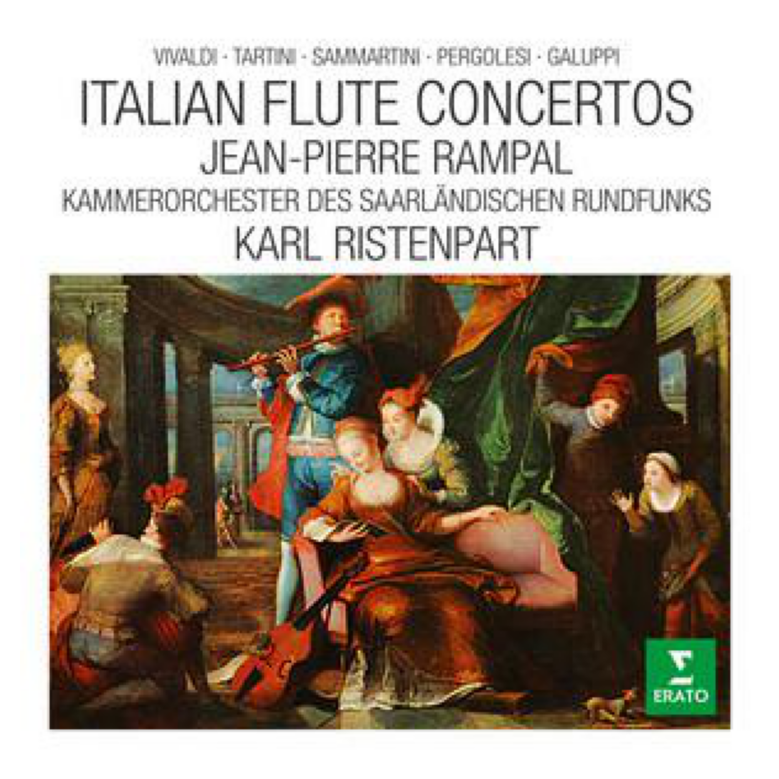

In [ ]:
import matplotlib
import matplotlib.pyplot as plt

valset = album_cover_loader(folder_name = new_dir, cats = categories, split = '')

image_index = 0  # Feel free to change this.

# 1. Datasets need to implement the __len__ method for this to work.
print('This dataset has {0} training images'.format(len(valset)))

# 2. Datasets need to implement the  __getitem__ method for this to work.
img, label = valset[image_index]  # Returns image and label.

print('Image {0} is a {1}'.format(image_index, valset.categories[label]))
print('Image size is {0}x{1}'.format(img.height, img.width))

# Show the image.
plt.figure();plt.imshow(img);
plt.grid(False); plt.axis('off'); plt.show()

##### Text feature optimization on training dataset and make predictions


###### data loader and functions

In [ ]:
# setup val data loader

class Flatten(object):
  def __call__(self, input_tensor):
    return input_tensor.view(224 * 224 * 3)

transform = transforms.Compose([transforms.Resize((224, 224)),
                                transforms.ToTensor(),
                                Flatten()])

batch_size = 1

valset = album_cover_loader(folder_name = new_dir, cats = categories, split = '', transform = transform)
val_loader = torch.utils.data.DataLoader(valset, batch_size = batch_size, shuffle = False)

In [ ]:
def freeze_model(model):
    for param in model.parameters():
        param.requires_grad = False

def tokens_to_similarity(input_text_features, image_features):
    normalized_input_text_features = input_text_features / input_text_features.norm(dim=-1, keepdim=True)
    similarity = normalized_input_text_features @ image_features.T
    return similarity.to(input_text_features.device)

###### Make prediction on training and validation dataset


In [ ]:
input_text_features = torch.load('input_text_features.pt')

In [ ]:
## make predictions on validation data

results_all = []

for (batch_id, (xb, yb)) in enumerate(val_loader):
    image_input = xb.reshape(-1,3,224,224).cuda()

    with torch.no_grad():
        image_features = model.encode_image(image_input).float()
    
    image_features /= image_features.norm(dim=-1, keepdim=True)

    text_probs = (100.0 * image_features @ input_text_features.T).softmax(dim=-1)
    all_probs, all_labels = text_probs.cpu().topk(len(valset.categories), dim=-1)

    results_all.append( (all_probs,all_labels,yb) )


In [ ]:
results_all[0]

(tensor([[1.0000e+00, 1.2974e-30, 1.0232e-32, 7.0763e-33, 2.7587e-33, 9.2439e-34,
          8.6833e-34, 7.0346e-34, 5.3872e-34, 3.3276e-34, 2.8759e-34, 2.8075e-34,
          3.8374e-35, 1.9458e-35, 2.2864e-36]], grad_fn=<TopkBackward0>),
 tensor([[ 2,  5,  7,  6,  3, 12,  8, 13,  4, 10,  9,  1, 11, 14,  0]]),
 tensor([2]))

###### Compute prediction accuracy and analyze errors

In [ ]:
valset.categories

['blues',
 'christian',
 'classical',
 'country',
 'electronic',
 'folk',
 'hip_hop',
 'indie',
 'jazz',
 'metal',
 'pop',
 'punk',
 'r_b',
 'reggae',
 'rock']

In [ ]:
# calculate accuracy based on original genres

n_labels = len(valset.categories)

correct = 0
incorrect = 0
incorrect_info = []
confusion_matrix = np.zeros( (n_labels, n_labels) )

for idx in range(len(results_all)):
    for idx2 in range(batch_size):
        pred = results_all[idx][1][idx2,0].item()
        true = results_all[idx][2][idx2].item()

        confusion_matrix[true, pred] += 1

        if pred == true:
            correct += 1
        else:
            incorrect += 1
            incorrect_info.append( (valset.categories[pred], valset.categories[true]) )

accuracy = correct / (correct+incorrect)
confusion_matrix_df = pd.DataFrame(confusion_matrix, columns=valset.categories, index=valset.categories)

print("total=",correct+incorrect)
print("validation accuracy=",accuracy)


total= 134
validation accuracy= 0.8208955223880597


In [ ]:
# calculate top 3 accuracy based on original genres

# set top n accuracy
top_n = 3

n_labels = len(valset.categories)

correct = 0
incorrect = 0

for idx1 in range(len(results_all)):
    for idx2 in range(batch_size):
        probs = results_all[idx1][0][idx2,:].detach().numpy()
        # top n accuracy
        label_idx = results_all[idx1][1][idx2, np.argsort(probs)[-top_n:]]
        true_idx = results_all[idx1][2][idx2].item()

        if true_idx in label_idx:
            correct += 1
        else:
            incorrect += 1

accuracy = correct / (correct+incorrect)

print("total=",correct+incorrect)
print("validation accuracy=",accuracy)

total= 134
validation accuracy= 0.9253731343283582


In [ ]:
# print out confusion matrix to QC wrong predictions
confusion_matrix_df

,blues,christian,classical,country,electronic,folk,hip_hop,indie,jazz,metal,pop,punk,r_b,reggae,rock
blues,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
christian,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
classical,0.0,0.0,33.0,0.0,0.0,0.0,0.0,9.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
country,1.0,3.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
electronic,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
folk,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
hip_hop,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
indie,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
jazz,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
metal,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
print("Total number of predictions for each genre:")
print(confusion_matrix_df.sum(axis=0))

Total number of predictions for each genre:
blues          3.0
christian      3.0
classical     33.0
country       25.0
electronic     0.0
folk           0.0
hip_hop        2.0
indie         11.0
jazz           1.0
metal          1.0
pop           22.0
punk           1.0
r_b            0.0
reggae         0.0
rock          32.0
dtype: float64


#### output predictions results

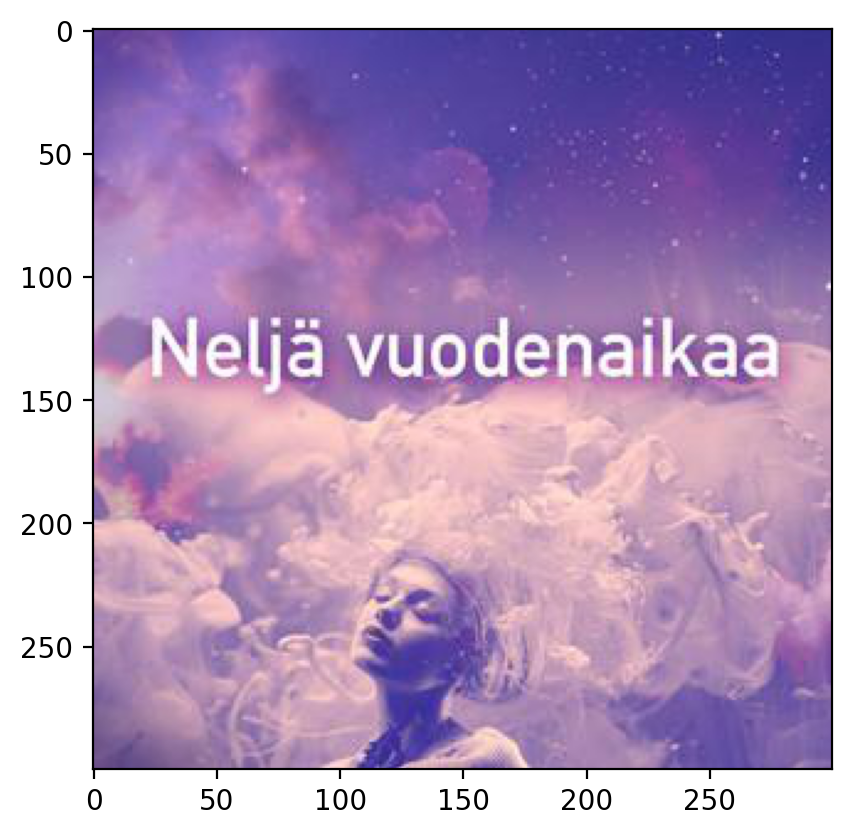

In [ ]:
valset = album_cover_loader(folder_name = new_dir, cats = categories, split = '')

img, label = valset[35]  # Returns image and label

# Show the image.
plt.figure();
plt.imshow(img);

In [ ]:
iconic_predictions_df = pd.DataFrame(columns=['Index', 'True_genre', 'Predicted_genre'])

for idx1 in range(len(results_all)):
    for idx2 in range(batch_size):
        pred = results_all[idx1][1][idx2,0].item()
        true = results_all[idx1][2][idx2].item()
        iconic_predictions_df.loc[idx1, 'Index']          = int(valset.indice[idx1])
        iconic_predictions_df.loc[idx1, 'True_genre']      = valset.categories[true]
        iconic_predictions_df.loc[idx1, 'Predicted_genre'] = valset.categories[pred]


In [ ]:
iconic_predictions_df = iconic_predictions_df.set_index('Index')
iconic_predictions_df

,True_genre,Predicted_genre
Index,,
5356,classical,classical
5338,classical,classical
5354,classical,classical
5373,classical,classical
5346,classical,classical
...,...,...
91376,rock,rock
91389,rock,rock
91369,rock,rock


In [ ]:
iconic_predictions_df = pd.concat([iconic_predictions_df, data_table], axis=1)[['True_genre','Predicted_genre','Artist','Image']].dropna()

In [ ]:
iconic_predictions_df
iconic_predictions_df.to_csv('iconic_predictions_df.csv', index=False)


In [ ]:
iconic_predictions_df.index

Int64Index([ 5356,  5338,  5354,  5373,  5346,  5351,  5372,  5376,  5355,
             5364,
            ...
            91374, 91357, 91361, 91379, 91363, 91376, 91389, 91369, 91368,
            91390],
           dtype='int64', length=134)

## Notes

In [ ]:
### mood
# Happy/Upbeat
# Sad/Melancholic
# Romantic/Love
# Energetic/Exciting
# Peaceful/Relaxing
# Nostalgic
# Angry/Aggressive
# Hopeful/Optimistic
# Dark/Intense
# Dreamy/Ethereal

### tempo
# Largo: Very slow (40-60 BPM)
# Adagio: Slow (66-76 BPM)
# Andante: Moderately slow (76-108 BPM)
# Moderato: Moderate (108-120 BPM)
# Allegro: Fast (120-168 BPM)
# Vivace: Lively and fast (168-176 BPM)
# Presto: Very fast (168-200 BPM)


### instruments
# 2-level classification
# String instruments: guitar, violin, cello, double bass, viola, harp, mandolin, banjo
# Wind instruments: flute, clarinet, saxophone, trumpet, trombone, tuba, oboe, bassoon
# Percussion instruments: drums, cymbals, xylophone, maracas, tambourine, triangle, gong, snare drum
# Keyboard instruments: piano, organ, harpsichord, synthesizer
# Electronic instruments: synthesizer, drum machine, sampler, digital audio workstation
# Vocal instruments: voice, choir


### art style
# Classical
# Renaissance
# Baroque
# Impressionism
# Expressionism
# Cubism
# Surrealism
# Art Deco
# Art Nouveau
# Avant-garde
# Abstract Expressionism1
# Fauvism
# Futurism
# Pop Art
# Minimalism
# Conceptual Art
# Neo-Impressionism
# Rococo
# Street Art
# Digital Art



DATASET GENRE REDUCTION BASED ON GRAMMY GENRE-SPECIFIC FIELDS:

Blues => Blues/Jazz/Soul => American Roots

Classical => Classical

Country => Country: Country/Folk

DeathMetal => Metal: DeathMetal/DoomMetal/HeavyMetal/Punk

DoomMetal => Metal: DeathMetal/DoomMetal/HeavyMetal/Punk

DrumNBass => Electronic: Electronic/Techno/DrumNBass

Electronic => Electronic: Electronic/Techno/DrumNBass

Folk => Country/Folk

Grime => HipHop/Grime

HeavyMetal => DeathMetal/DoomMetal/HeavyMetal/Punk

HipHop => HipHop/Grime

LoFi => LoFi

Jazz => Blues/Jazz/Soul

Pop => Pop/Rock/PsychedelicRock

PscychedelicRock => Rock

Punk => Pop/Rock/PsychedelicRock

Reggae => Reggae

Rock => Pop/Rock/PsychedelicRock/Punk

Soul => Blues/Jazz/Soul

Techno => Electronic/Techno/DrumNBass

**GENRE DESCRIPTIONS EDIT WITH GPT-4 + CONSISTENT ORDER OF FEATURES**

"Blues":
Color: Deep, rich blues, blacks, and reds.
Imagery: Elements of African American history and culture, rural landscapes, sharecroppers, iconic Southern images, and instruments like guitars, harmonicas, and pianos.
Text: Classic and legible typography.

"Classical":
Color: Neutral and elegant colors.
Imagery: Minimalist designs, sophisticated and timeless imagery, classical instruments like pianos, violins, and cellos.
Text: Serif fonts, calligraphy, or other classical typography styles.

"Country":
Color: Warm, earthy browns, greens, and reds.
Imagery: Rural landscapes such as farms, fields, rolling hills, country icons like cowboys, pickup trucks, and cowboy hats, and a sense of Americana.
Text: Bold, simple, and legible typography.

"DeathMetal":
Color: Blacks, reds, dark reds, and dark greens.
Imagery: Dark and macabre elements, including skulls, gore, demonic symbols, death, violence, battles, torture, decay, band logos or symbols with intricate designs, and demonic imagery.
Text: Bold, angular, difficult-to-read typography with spikes.

"DoomMetal":
Colors: Blacks and grays.
Imagery: Dark and ominous scenes, gothic architecture, cemeteries, dark forests, death, occult symbols like skulls and pentagrams.
Text: Bold, heavy, ornate, difficult-to-read typography with spikes.

"DrumNBass":
Color: Vibrant, bold colors.
Imagery: Abstract or futuristic designs, geometric shapes, digital or technological elements, distorted or glitched imagery, urban or industrial environments, graffiti, or street art. Energetic and visually dynamic visuals.
Text: Clear and modern typography.

"Electronic":
Color: Neon and bright colors, like pink, blue, or green.
Imagery: Abstract or psychedelic elements, including geometric shapes, trippy patterns, and digital landscapes.
Text: Sleek sans-serif fonts, futuristic-looking typefaces, and bold typography.

"Folk": Colors: Earthy tones, like browns, greens, and blues. Imagery: Scenic nature like forests or mountains, regional folk customs or instruments, artists in natural settings or folk venues. Text: Rustic, hand-drawn typography, reflecting tradition.

[["Folk":
Colors: Earthy browns, greens, and blues.
Imagery: Nature and landscape elements, such as mountains, forests, or fields, folk traditions, including folk costumes, instruments, or folk art, and band or artist in a natural setting or performing in a folk venue.
Text: Hand-drawn or rustic typography.]]

"Grime":
Color: Bright and eye-catching colors.
Imagery: Intricate patterns, urban visuals like graffiti or cityscapes, rough and edgy with a distinct urban and underground feel.
Text: Bold, vivid typography, incorporating a mix of street art-inspired design elements.

"HeavyMetal":
Color: Muted shades of black, gray, and red.
Imagery: Dark or intense visuals, featuring fantasy or horror themes, depictions of demons, monsters, supernatural creatures, symbols of death, destruction, or rebellion.
Text: Gothic or medieval-inspired bold and angular typography.

"HipHop":
Color: Vibrant and bold colors.
Imagery: Urban culture visuals, including cityscapes, graffiti, hip hop fashion, breakdancing, DJing, and stylized or altered photographs or illustrations of the artist or urban scenes.
Text: Stylized typography with elements like drop shadows or 3D effects, bold lettering.

"Jazz": Color: Diverse color schemes, vibrant and bold or subdued and muted. Imagery: Photography, artwork, musicians playing instruments such as trumpet or sax, jazz clubs and venues, cityscapes, nature, and abstract shapes, designs, and patterns. Text: Elegant, refined serifs or modern, playful sans-serif fonts, bold or italicized.

[["Jazz":Color: Predominantly black and white, with occasional use of subdued colors. Imagery: Black and white photography, elements of jazz culture like musical instruments, sheet music, jazz venues, and artistic illustrations such as sketches or paintings.Text: Refined and elegant typography featuring serifs or cursive scripts.]]

"LoFi":
Color: Muted, pastel color palettes.
Imagery: Nostalgic or vintage atmosphere, graphic designs, old technology, chill and laid-back vibes, and DIY aesthetic.
Text: Handwritten-inspired typography with focus on simple, bold lettering.

[["LoFi":
Color: Muted or pastel color palettes.
Imagery: Nostalgic or vintage atmosphere, minimalist or abstract designs, cassette tapes, vinyl records, old technology, natural landscapes, cityscapes, urban settings, chill and laid-back vibes, and DIY aesthetic.
Text: Handwritten or handwritten-inspired typography with a focus on simple, bold lettering.]]

"Pop":
Color: Bright and bold colors.
Imagery: Artist's image, people dancing or partying, bold patterns, surreal visuals, unusual textures.
Text: Distinctive lettering, creative fonts, playful shapes, and colors.

"PsychedelicRock":
Color: Vibrant colors.
Imagery: Surreal, abstract themes with bright, bold, colorful visuals. Psychedelic patterns, dreamlike landscapes, surrealistic illustrations, counterculture references, and elements of fantasy, spirituality, and altered states of consciousness.
Text: Bold typography and unusual graphic elements.

"Punk":
Imagery: Raw, rebellious aesthetic featuring bold designs with gritty or distressed textures, hand-drawn elements, DIY-style graphics, politically charged or socially conscious themes, and punk subculture symbols like safety pins, leather jackets, and mohawks.
Color: Monochromatic palette or limited to black and white.
Text: Bold, distressed typography.

"Reggae":
Color: Vibrant colors, prominently featuring red, green, and yellow.
Imagery: Tropical landscapes, historical figures, Jamaican culture, Rastafarianism, iconic Reggae artists or bands, political messages, social commentary, and bold patterns.
Text: Bold typography.

"Rock":
Color: Varied color palettes, often leaning towards darker or more saturated hues.
Imagery: Striking visuals, powerful symbols, abstract designs, rock culture elements like musical instruments, concert venues, iconic symbols, and elements of rebellion or counterculture such as political statements, anti-establishment symbols, or provocative imagery.
Text: Stylized typography with bold lettering and distressed textures.

"Soul":
Color: Bold colors.
Imagery: Vinyl records, microphones, instruments like guitar or piano, images of the artist or soulful performances, with nostalgic, emotive, and soulful moods reflecting the genre's roots in African American culture and history.
Text: Vintage typography.

"Techno":
Color: Black and white color palette.
Imagery: Minimalistic designs featuring simple geometric shapes, lines, or patterns; technology or machines such as circuit boards, robots, or futuristic cityscapes; and abstract or psychedelic elements like digital distortion or glitch effects.
Text: Modern, simple typography, primarily using sans-serif fonts.

**FIRST DRAFT PARENT GENRE DESCRIPTIONS:**

Rock: Color: Varied color palettes, often leaning towards darker or more saturated hues. Imagery: Striking visuals, powerful symbols, abstract designs, rock culture elements like musical instruments, concert venues, iconic symbols, and elements of rebellion or counterculture such as political statements, anti-establishment symbols, or provocative imagery. Text: Stylized typography with bold lettering and distressed textures.

Country: Color: Warm, earthy browns, greens, and reds. Imagery: Rural landscapes such as farms, fields, rolling hills, country icons like cowboys, pickup trucks, and cowboy hats, and a sense of Americana. Text: Bold, simple, and legible typography.

Pop: Color: Bright and bold colors. Imagery: Artist's image, people dancing or partying, bold patterns, surreal visuals, unusual textures. Text: Distinctive lettering, creative fonts, playful shapes, and colors.

Hip hop: Color: Vibrant and bold colors. Imagery: Urban culture visuals, including cityscapes, graffiti, hip hop fashion, breakdancing, DJing, and stylized or altered photographs or illustrations of the artist or urban scenes. Text: Stylized typography with elements like drop shadows or 3D effects, bold lettering.

Folk: Earthy tones, like browns, greens, and blues. Imagery: Scenic nature like forests or mountains, regional folk customs or instruments, artists in natural settings or folk venues. Text: Rustic, hand-drawn typography, reflecting tradition.

Metal: Color: Muted shades of black, gray, and red. Imagery: Dark or intense visuals, featuring fantasy or horror themes, depictions of demons, monsters, supernatural creatures, symbols of death, destruction, or rebellion. Text: Gothic or medieval-inspired bold and angular typography.

R&b: Color: Rich, vibrant, or sultry color schemes.
Imagery: Sensual or emotional themes, cityscapes, nightlife, silhouettes or portraits of artists, abstract or geometric patterns.
Text: Smooth, stylish typography, often with a modern or urban influence.

Punk: Imagery: Raw, rebellious aesthetic featuring bold designs with gritty or distressed textures, hand-drawn elements, DIY-style graphics, politically charged or socially conscious themes, and punk subculture symbols like safety pins, leather jackets, and mohawks. Color: Monochromatic palette or limited to black and white. Text: Bold, distressed typography.

Blues: Color: Deep, rich blues, blacks, and reds. Imagery: Elements of African American history and culture, rural landscapes, sharecroppers, iconic Southern images, and instruments like guitars, harmonicas, and pianos. Text: Classic and legible typography.

Christian: Color: Soft, warm hues or uplifting bright colors.
Imagery: Spiritual symbols, peaceful landscapes, religious buildings, or abstract designs conveying faith, hope, or love.
Text: Elegant, refined typography or handwritten-style lettering.

Classical: Color: Neutral and elegant colors. Imagery: Minimalist designs, sophisticated and timeless imagery, classical instruments like pianos, violins, and cellos. Text: Serif fonts, calligraphy, or other classical typography styles.

Indie: Color: Diverse, often bold or unconventional palettes.
Imagery: Unique, artistic visuals, eclectic or abstract designs, personal or introspective themes, hand-drawn elements.
Text: Creative, distinctive typography, often handcrafted or experimental in style.

Jazz: Color: Diverse color schemes, vibrant and bold or subdued and muted. Imagery: Photography, artwork, musicians playing instruments such as trumpet or sax, jazz clubs and venues, cityscapes, nature, and abstract shapes, designs, and patterns. Text: Elegant, refined serifs or modern, playful sans-serif fonts, bold or italicized.

Electronic: Color: Neon and bright colors, like pink, blue, or green. Imagery: Abstract or psychedelic elements, including geometric shapes, trippy patterns, and digital landscapes. Text: Sleek sans-serif fonts, futuristic-looking 

"Reggae": Color: Vibrant colors, prominently featuring red, green, and yellow. Imagery: Tropical landscapes, historical figures, Jamaican culture, Rastafarianism, iconic Reggae artists or bands, political messages, social commentary, and bold patterns. Text: Bold typography.typefaces, and bold typography.

## Old test: CLIP testing on Kaggle album cover dataset

### Load and prepare Album cover data

#### Download album covers from Kaggle

In [ ]:
## install Kaggle
!pip install -q kaggle

In [ ]:
# need to login Kaggel account
# click your icon and then "account"
# click "Create New API token", this will download a jason file

# from google.colab import files
# files.upload()

# after running the cell, click "Choose Files" below and find the jason file downed above

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"lhffelix","key":"de3241312ae0d5e4847a1ebddf5fc61a"}'}

In [ ]:
# copy the uploaded file to the right directory and set permission

# !cd
# # !mkdir ~/.kaggle/
# !cp kaggle.json  ~/.kaggle/
# !chmod 600  ~/.kaggle/kaggle.json


In [ ]:
# show kaggle datasets
# ! kaggle datasets list

ref                                                      title                                     size  lastUpdated          downloadCount  voteCount  usabilityRating  
-------------------------------------------------------  ---------------------------------------  -----  -------------------  -------------  ---------  ---------------  
themrityunjaypathak/covid-cases-and-deaths-worldwide     Covid Cases and Deaths WorldWide           8KB  2023-02-01 12:22:51          12276        412  1.0              
naveenkumar20bps1137/walmart-sales-analysis              WALMART SALES ANALYSIS                   119KB  2023-03-03 18:02:11           2559         63  0.9411765        
datascientistanna/customers-dataset                      Shop Customer Data                        23KB  2023-02-07 18:42:21          10513        238  1.0              
ulrikthygepedersen/co2-emissions-by-country              CO2 Emissions                            114KB  2023-02-28 12:39:49           1079         31

In [ ]:
# download the album image dataset
# ! kaggle datasets download -d michaeljkerr/20k-album-covers-within-20-genres

 95% 214M/226M [00:03<00:00, 57.5MB/s]
100% 226M/226M [00:03<00:00, 72.1MB/s]


In [ ]:
# unzip images

# !unzip 20k-album-covers-within-20-genres.zip

#### Alternatively, Download album covers from google drive

In [ ]:
# !pip install gdown

!gdown "https://drive.google.com/uc?export=download&id=1vThTS8UMC0QAzj75wYAt9fQMZvSWh8A4"
# for unknown reason, direct download from gdown will fail while browser download works.

Downloading...
From: https://drive.google.com/uc?export=download&id=1vThTS8UMC0QAzj75wYAt9fQMZvSWh8A4
To: /content/archive.zip
100% 237M/237M [00:00<00:00, 274MB/s]


In [ ]:
!unzip -qq archive.zip

### other datasets
# !unzip -qq MajorGenres.zip
# !unzip -qq easy_small.zip

replace GAID/Blues/R-10023346-1623700770-3011-jpeg.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


#### Imports

In [ ]:
## imports

import os, json, pickle, random
import torch.utils.data
from PIL import Image

from torchvision import transforms

import matplotlib
import matplotlib.pyplot as plt

import time
import numpy as np
import pandas as pd

from PIL import Image
import cv2 
import numpy as np
import matplotlib.pyplot as plt

#### Setup dataset name (important)


In [ ]:
## set data folder name
## this is used to control which dataset to use
folder_name = 'GAID'

#### find genres of images

In [ ]:
# dump image filenames and genres to a csv file
! ls $folder_name/*/* > data_file_paths
! cat data_file_paths | awk -F/ '{print $2","$3","$0}' > data_list.csv

In [ ]:
# load filename and genre data list
data_list = pd.read_csv('data_list.csv')

# original column name needs to be set customly
data_list.rename(columns = {'R-10023346-1623700770-3011-jpeg.jpg':'filename'}, inplace = True)
data_list.rename(columns = {'Blues':'genre'}, inplace = True)
data_list.rename(columns = {'GAID/Blues/R-10023346-1623700770-3011-jpeg.jpg':'file_path'}, inplace = True)
# data_list.rename(columns = {'R-1001640-1445614691-2395-jpeg.jpg':'filename'}, inplace = True)
# data_list.rename(columns = {'AmericanRoots':'genre'}, inplace = True)
# data_list.rename(columns = {'MajorGenres/AmericanRoots/R-1001640-1445614691-2395-jpeg.jpg':'file_path'}, inplace = True)
# data_list.rename(columns = {'R-430690-1581804815-7947-jpeg.jpg':'filename'}, inplace = True)
# data_list.rename(columns = {'AmericanRoots':'genre'}, inplace = True)
# data_list.rename(columns = {'easy_small/AmericanRoots/R-430690-1581804815-7947-jpeg.jpg':'file_path'}, inplace = True)

# find unique genre and filename
file_names = data_list['filename'].drop_duplicates()
genre_names = data_list['genre'].drop_duplicates()

#CL alternatively, could just use
# genre_names = data_list['genre'].unique()

In [ ]:
print("Number of unique files is:",file_names.shape[0])
print("Number of unique genres is:",genre_names.shape[0])

Number of unique files is: 19229
Number of unique genres is: 20


In [ ]:
# process all files and dump results
file_genres_all = []
file_genre = []
file_genres = []
for filename in file_names:
    # find the genres correspond to a filename
    cur_record = data_list[data_list['filename']==filename]
    cur_genres = ",".join(cur_record['genre'])

    # find the file_path correspond to a filename
    file_path = ",".join(cur_record['file_path'])

    # store results to multiple lists
    if cur_record['genre'].shape[0]==1:
        file_genre.append([filename, cur_genres, file_path])
    else:
        file_genres.append([filename, cur_genres, file_path])
    file_genres_all.append([filename, cur_genres, file_path])

file_genres_all = pd.DataFrame(file_genres_all)
file_genre = pd.DataFrame(file_genre)
file_genres = pd.DataFrame(file_genres)

In [ ]:
print("Number of single genre album cover is:",file_genre.shape[0])
print("Number of multi genres album cover is:",file_genres.shape[0])

Number of single genre album cover is: 18558
Number of multi genres album cover is: 671


In [ ]:
# save to file
file_genre.to_csv('file_single_genre.csv')
file_genres.to_csv('file_multi_genres.csv')

#### QC Album covers

Image shape:  (300, 300, 3)
Value type: <class 'numpy.uint8'>, Min: 0, Max: 255


(-0.5, 299.5, 299.5, -0.5)

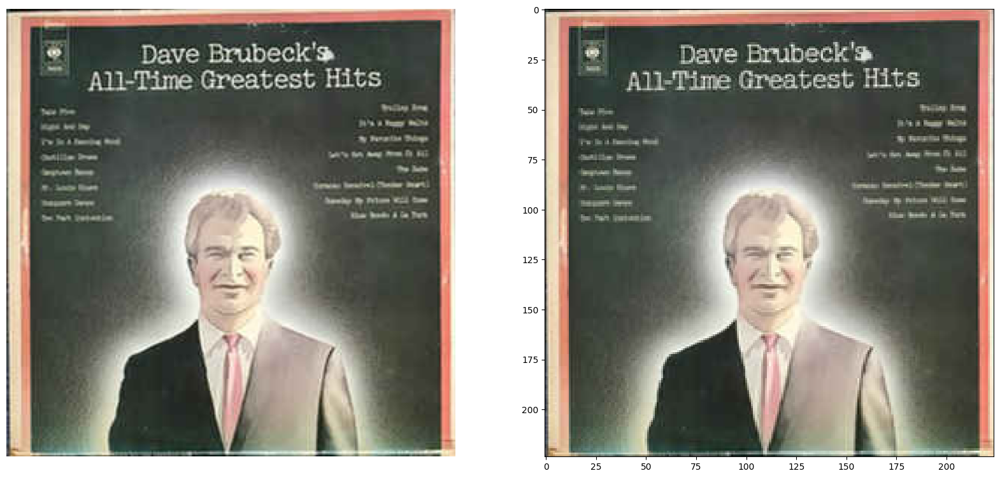

In [ ]:
# review images and test the effect of resizing

# from PIL import Image
# import cv2 
# import numpy as np
# import matplotlib.pyplot as plt

img_path = data_list['file_path'][0]

im = Image.open(img_path)

im = np.array(im) # Convert to a numpy array
print("Image shape: ", im.shape) # Prints out shape: (height, width, channels)
print("Value type: %s, Min: %d, Max: %d" % (type(im[0,0,0]), np.min(im), np.max(im))) # Image is loaded with uint8 values in [0, 255]

im_224 = cv2.resize(im, (224, 224))
im_out = Image.fromarray(im_224)

im_out.save('test_224.jpg')

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20,40))

ax[0].imshow(im) # Show image
ax[0].axis(False)
ax[1].imshow(im_out)
ax[0].axis(False)

# im_out.save('test_224.jpg')


#### Setup data loader

In [ ]:
## create list of classes
!cd
!ls -d $folder_name/*/ | cut -d "/" -f 2 > $folder_name/ClassName.txt

In [ ]:
# Simple implementation of a custom data loading class for our dataset.
class album_cover_loader(torch.utils.data.Dataset):

  # Initialize the class e.g. load files, preprocess, etc.
  def __init__(self, folder_name, split = '', transform = None):
    
    # These are the 20 categories selected.
    # self.categories = open('GAID/' + split + '/ClassName.txt').read().split('\n')[:-1]
    self.categories = open(folder_name + '/' + split + '/ClassName.txt').read().split('\n')[:-1]
    self.categories = sorted(self.categories)
    self.category2index = {category: idx for (idx, category) in enumerate(self.categories)}
    self.transform = transform

    # Compile a list of images and corresponding labels.
    self.imagepaths = []
    self.labels = []
    for category in self.categories:
    #   category_directory = 'GAID/' + split + category
      category_directory = folder_name + '/' + split + category
      category_imagenames = os.listdir(category_directory)
      self.imagepaths += [os.path.join(category_directory, imagename) 
                          for imagename in category_imagenames]
      self.labels += [self.category2index[category]] * len(category_imagenames)

    # Sort imagepaths alphabetically and labels accordingly.
    sorted_pairs = sorted(zip(self.imagepaths, self.labels), key = lambda x: x[0])
    self.imagepaths, self.labels = zip(*sorted_pairs)

        
  # Return a sample (x, y) as a tuple e.g. (image, label)
  def __getitem__(self, index):
    image = Image.open(self.imagepaths[index]).convert('RGB')
    if self.transform:
      image = self.transform(image)
    return image, self.labels[index]
  
  # Return the total number of samples.
  def __len__(self):
    return len(self.imagepaths)

This dataset has 20000 training images
Image 0 is a Blues
Image size is 300x300


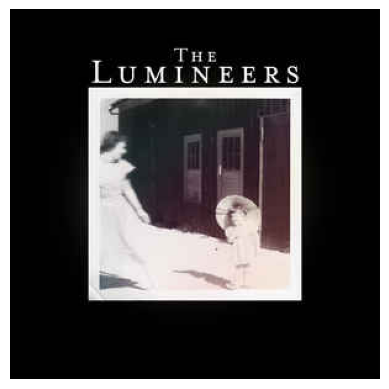

In [ ]:
import matplotlib
import matplotlib.pyplot as plt

# valset = GAID(split = '')
valset = album_cover_loader(folder_name = folder_name, split = '')

image_index = 0  # Feel free to change this.

# 1. Datasets need to implement the __len__ method for this to work.
print('This dataset has {0} training images'.format(len(valset)))

# 2. Datasets need to implement the  __getitem__ method for this to work.
img, label = valset[image_index]  # Returns image and label.

print('Image {0} is a {1}'.format(image_index, valset.categories[label]))
print('Image size is {0}x{1}'.format(img.height, img.width))

# Show the image.
plt.figure();plt.imshow(img);
plt.grid(False); plt.axis('off'); plt.show()

### Train/Fine-tune model for Genre classification

#### Prep CLIP model and helper functions

In [ ]:
! pip install ftfy regex tqdm
! pip install git+https://github.com/openai/CLIP.git

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-2nds4we6
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-2nds4we6
  Resolved https://github.com/openai/CLIP.git to commit a9b1bf5920416aaeaec965c25dd9e8f98c864f16
  Preparing metadata (setup.py) ... done


In [ ]:
import torch
from pkg_resources import packaging

import clip

import IPython.display

from collections import OrderedDict

print("Torch version:", torch.__version__)

clip.available_models()

Torch version: 2.0.0+cu118


['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [ ]:
# load pre-trained model
model, preprocess = clip.load("ViT-B/32")
# model, preprocess = clip.load("ViT-L/14")

model.cuda().eval()
input_resolution = model.visual.input_resolution
context_length = model.context_length
vocab_size = model.vocab_size

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

Model parameters: 151,277,313
Input resolution: 224
Context length: 77
Vocab size: 49408


In [ ]:
# helper functions

to_tensor = transforms.ToTensor()
to_image = transforms.ToPILImage()

def image_pil_to_tensor(img):
    transform = transforms.Compose([transforms.ToTensor()])
    return transform(img)

def image_tensor_to_pil(img):
    transform = transforms.Compose([transforms.ToPILImage()])
    return transform(img)

def image_tensor_to_numpy(img_tensor):
    img_np = img_tensor.detach().cpu().numpy()
    return np.transpose( img_np[...], (1, 2, 0))

def image_numpy_to_tensor(img_np):
    img_tensor = torch.tensor(img_np)
    return img_tensor

def image_resize(image, img_height=256, img_width=256):
    transform = transforms.Compose([transforms.Resize([img_height,img_width])])
    return transform(image)

#### QC data

In [ ]:
# QC categories in dataset
valset.categories

['Blues',
 'Classical',
 'Country',
 'DeathMetal',
 'DoomMetal',
 'DrumNBass',
 'Electronic',
 'Folk',
 'Grime',
 'HeavyMetal',
 'HipHop',
 'Jazz',
 'LoFi',
 'Pop',
 'PsychedelicRock',
 'Punk',
 'Reggae',
 'Rock',
 'Soul',
 'Techno']

/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


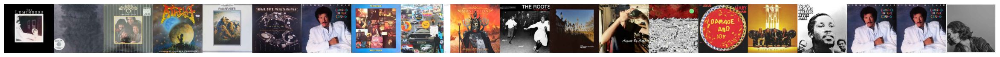

In [ ]:
# Show image examples

valset = album_cover_loader(folder_name = folder_name, split = '')

n_class = len(valset.categories)
n_channel = 3
height = 224
width = 224

image_exp_list = []
found_list = []

for (image, label) in valset:
    # only save first image in each category
    if label not in found_list:
        image_cur = image_pil_to_tensor(image)
        image_cur = image_resize( image_cur, 224, 224 )
        image_exp_list.append( image_cur )
        found_list.append(label)

image_exp_display = image_tensor_to_numpy( torch.concat(image_exp_list, axis = 2) )
plt.figure(figsize=(30,600));
plt.imshow( image_exp_display )
plt.grid(False); 
plt.axis('off'); 

#### descriptions

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# # baseline
# descriptions = {
#     "Blues": "Blues",
#     "Classical": "Classical",
#     "Country": "Country",
#     "DeathMetal": "DeathMetal",
#     "DoomMetal": "DoomMetal",
#     "DrumNBass": "DrumNBass",
#     "Electronic": "Electronic",
#     "Folk": "Folk",
#     "Grime": "Grime", 
#     "HeavyMetal": "HeavyMetal",
#     "HipHop": "HipHop",
#     "Jazz": "Jazz",
#     "LoFi": "LoFi",
#     "Pop": "Pop",
#     "PsychedelicRock": "PsychedelicRock", 
#     "Punk": "Punk",
#     "Reggae": "Reggae",
#     "Rock": "Rock",
#     "Soul": "Soul",
#     "Techno": "Techno"
# }


# descriptions = {
#     "Blues": "African American history and culture. deep, rich colors like blue, black, and red. \
# rural landscapes, sharecroppers, or other iconic Southern images. guitar, a harmonica, or a piano.",

#     "Classical": "sophistication, and timeless. classical fonts including serif fonts or calligraphy. \
# minimalist designs. classical instruments such as a piano, violin, or cello",

#     "Country": "rural landscapes, country icons, and a sense of Americana. rural landscapes, such as farms, fields, or rolling hills. \
# warm, earthy colors like brown, green, and red.  country icons like cowboys, pickup trucks, or cowboy hats. bold, simple typography.",

#     "DeathMetal": "dark and macabre imagery, such as skulls, gore, or demonic symbols. dark colors such as black, red, or dark green. \
# bold, angular typography that is difficult to read and may include spikes. \
# death or violence, such as depictions of battles, torture, or decay. band logos or symbols, which may include intricate designs or demonic imagery",

#     "DoomMetal": "dark and ominous imagery, such as gothic architecture, cemeteries, or dark forests. \
# black and gray colors. bold, heavy, and ornate typography difficult to read. spikes. \
# death or the occult, such as skulls, pentagrams, or other symbols of evil.",

#     "DrumNBass": "bright, bold colors and abstract or futuristic designs. geometric shapes, digital or technological elements, and distorted or glitched imagery. \
# may feature references to urban or industrial environments, as well as graffiti or street art.  energetic and visually dynamic.",

#     "Electronic": "abstract or psychedelic imagery, such as geometric shapes, trippy patterns, or digital landscapes. \
# bright and neon colors, such as pink, blue, or green. bold and modern typography, such as sleek sans-serif fonts or futuristic-looking typefaces.",

#     "Folk": "nature and landscape imagery, such as mountains, forests, or fields. earthy colors, such as browns, greens, and blues. \
# typography that is hand-drawn or has a rustic feel. folk traditions, such as folk costumes, instruments, or folk art. \
# band or artist, which may be posed in a natural setting or performing in a folk venue.",

#     "Grime": "bold, vivid, and often feature a mix of typography and street art inspired design elements. \
# bright colors, intricate patterns, and urban imagery such as graffiti or cityscapes. rough and edgy. \
# have a distinct urban and underground feel.", 

#     "HeavyMetal": "dark or intense imagery, featuring fantasy or horror themes. The color scheme is dark and muted, featuring shades of black, gray, and red. \
# depictions of demons, monsters, or other supernatural creatures, as well as symbols of death, destruction, or rebellion. \
# typography is bold and angular, with a gothic or medieval feel. power, aggression, and intensity.",

#     "HipHop": "bold and vibrant colors. bold and stylized typography, with elements like drop shadows or 3D effects. \
# urban culture, such as cityscapes, graffiti, or hip hop fashion. hip hop culture, such as breakdancing or DJing. \
# stylized or altered photographs or illustrations of the artist or other urban imagery.",

#     "Jazz": "black and white photography. elegant and refined typography, with elements like serifs or cursive scripts. \
# imagery related to jazz culture, such as musical instruments, sheet music, or jazz venues. artistic illustrations, such as sketches or paintings. \
# abstract or surreal elements, such as geometric shapes or distorted imagery.",

#     "LoFi": "nostalgic or vintage vibe, with muted or pastel color palettes and minimalist or abstract designs. \
# images of cassette tapes, vinyl records, or old technology, as well as natural landscapes, cityscapes, or urban settings. \
# typography is often handwritten or handwritten-inspired, with a focus on simple, bold lettering. \
# sense of chill, laid-back vibes and DIY aesthetic.",

#     "Pop": "Bright and bold colors. Imagery of the artist. bold lettering, unusual fonts, or playful shapes and colors. \
# people dancing or partying. bold patterns, surreal images, or unusual textures.",

#     "PsychedelicRock": "bright, bold, and colorful imagery with surreal and abstract themes. \
# psychedelic patterns, dreamlike landscapes, and surrealistic illustrations. vibrant colors, bold typography, and unusual graphic elements. \
# references to the counterculture movement, as well as elements of fantasy, spirituality, and altered states of consciousness. ", 

#     "Punk": "raw and rebellious aesthetic. bold, eye-catching designs with gritty or distressed textures, hand-drawn elements, and DIY-style graphics. \
# politically charged or socially conscious themes. color palette is monochromatic or limited to black and white. \
# punk subcultures, such as safety pins, leather jackets, and mohawks.",

#     "Reggae": "vibrant colors, images of tropical landscapes or historical figures, and references to Jamaican culture and Rastafarianism. \
# iconic Reggae artists or bands, while others may incorporate political messages or social commentary. bold typography and patterns.",

#     "Rock": "bold and striking imagery, such as powerful symbols or abstract designs. bold and stylized typography, with elements like bold lettering or distressed textures. \
# rock culture, such as musical instruments, rock concert venues, or iconic symbols. \
# elements of rebellion or counterculture, such as political statements, anti-establishment symbols, or provocative imagery",

#     "Soul": "vintage typography, bold colors, and images of the artist or a soulful performance. \
# motifs such as vinyl records, microphones, and instruments such as the guitar or piano. \
# mood could be nostalgic, emotive, and soulful to reflect the genre's roots in African American culture and history.",

#     "Techno": "minimalistic imagery, such as simple geometric shapes, lines, or patterns. black and white colors. \
# simple and modern typography, such as sans-serif fonts. technology or machines, such as circuit boards, robots, or futuristic cityscapes. \
# abstract or psychedelic elements, such as digital distortion or glitch effects."
# }

# best before feature engineering
# descriptions = {
#     "Blues": "Blues. African American history and culture. deep, rich colors like blue, black, and red. \
# rural landscapes, sharecroppers, or other iconic Southern images. guitar, a harmonica, or a piano.",

#     "Classical": "Classical. sophistication, and timeless. classical fonts including serif fonts or calligraphy. \
# minimalist designs. classical instruments such as a piano, violin, or cello",

#     "Country": "Country. rural landscapes, country icons, and a sense of Americana. rural landscapes, such as farms, fields, or rolling hills. \
# warm, earthy colors like brown, green, and red. country icons like cowboys, pickup trucks, or cowboy hats. bold, simple typography.",

#     "DeathMetal": "DeathMetal. dark and macabre imagery, such as skulls, gore, or demonic symbols. dark colors such as black, red, or dark green. \
# bold, angular typography that is difficult to read and spikes. death or violence, such as depictions of battles, torture, or decay. \
# band logos or symbols, which may include intricate designs or demonic imagery",

#     "DoomMetal": "DoomMetal. dark and ominous imagery, such as gothic architecture, cemeteries, or dark forests. \
# black and gray colors. bold, heavy, and ornate typography difficult to read. spikes. \
# death or the occult, such as skulls, pentagrams, or other symbols of evil.",

#     "DrumNBass": "DrumNBass. bright, bold colors and abstract or futuristic designs. geometric shapes, digital or technological elements, and distorted or glitched imagery. \
# may feature references to urban or industrial environments, as well as graffiti or street art.  energetic and visually dynamic.",

#     "Electronic": "Electronic. abstract or psychedelic imagery, such as geometric shapes, trippy patterns, or digital landscapes. \
# bright and neon colors, such as pink, blue, or green. bold and modern typography, such as sleek sans-serif fonts or futuristic-looking typefaces.",

#     "Folk": "Folk. nature and landscape imagery, such as mountains, forests, or fields. earthy colors, such as browns, greens, and blues. \
# typography that is hand-drawn or has a rustic feel. folk traditions, such as folk costumes, instruments, or folk art. \
# band or artist, which may be posed in a natural setting or performing in a folk venue.",

#     "Grime": "Grime. bold, vivid, and often feature a mix of typography and street art inspired design elements. \
# bright colors, intricate patterns, and urban imagery such as graffiti or cityscapes. rough and edgy. \
# have a distinct urban and underground feel.", 

#     "HeavyMetal": "HeavyMetal. dark or intense imagery, featuring fantasy or horror themes. The color scheme is dark and muted, featuring shades of black, gray, and red. \
# depictions of demons, monsters, or other supernatural creatures, as well as symbols of death, destruction, or rebellion. \
# typography is bold and angular, with a gothic or medieval feel.",

#     "HipHop": "HipHop. bold and vibrant colors. bold and stylized typography, with elements like drop shadows or 3D effects. \
# urban culture, such as cityscapes, graffiti, or hip hop fashion. hip hop culture, such as breakdancing or DJing. \
# stylized or altered photographs or illustrations of the artist or other urban imagery.",

#     "Jazz": "Jazz. black and white photography. elegant and refined typography, with elements like serifs or cursive scripts. \
# imagery related to jazz culture, such as musical instruments, sheet music, or jazz venues. artistic illustrations, such as sketches or paintings. \
# abstract or surreal elements, such as geometric shapes or distorted imagery.",

#     "LoFi": "LoFi. nostalgic or vintage vibe, with muted or pastel color palettes and minimalist or abstract designs. \
# images of cassette tapes, vinyl records, or old technology and natural landscapes, cityscapes, or urban settings. \
# typography is handwritten or handwritten-inspired, with a focus on simple, bold lettering. sense of chill, laid-back vibes and DIY aesthetic.",

#     "Pop": "Pop. Bright and bold colors. Imagery of the artist. bold lettering, unusual fonts, or playful shapes and colors. \
# people dancing or partying. bold patterns, surreal images, or unusual textures.",

#     "PsychedelicRock": "PsychedelicRock. bright, bold, and colorful imagery with surreal and abstract themes. \
# psychedelic patterns, dreamlike landscapes, and surrealistic illustrations. vibrant colors, bold typography, and unusual graphic elements. \
# references to the counterculture movement, as well as elements of fantasy, spirituality, and altered states of consciousness. ", 

#     "Punk": "Punk. raw and rebellious aesthetic. bold, eye-catching designs with gritty or distressed textures, hand-drawn elements, and DIY-style graphics. \
# politically charged or socially conscious themes. color palette is monochromatic or limited to black and white. \
# punk subcultures, such as safety pins, leather jackets, and mohawks.",

#     "Reggae": "Reggae. vibrant colors, images of tropical landscapes or historical figures, and references to Jamaican culture and Rastafarianism. \
# iconic Reggae artists or bands, while others may incorporate political messages or social commentary. bold typography and patterns.",

#     "Rock": "Rock. bold and striking imagery, such as powerful symbols or abstract designs. bold and stylized typography, with elements like bold lettering or distressed textures. \
# rock culture, such as musical instruments, rock concert venues, or iconic symbols. \
# elements of rebellion or counterculture, such as political statements, anti-establishment symbols, or provocative imagery",

#     "Soul": "Soul. vintage typography, bold colors, and images of the artist or a soulful performance. \
# motifs such as vinyl records, microphones, and instruments such as the guitar or piano. \
# mood could be nostalgic, emotive, and soulful to reflect the genre's roots in African American culture and history.",

#     "Techno": "Techno. minimalistic imagery, such as simple geometric shapes, lines, or patterns. black and white colors. \
# simple and modern typography, such as sans-serif fonts. technology or machines, such as circuit boards, robots, or futuristic cityscapes. \
# abstract or psychedelic elements, such as digital distortion or glitch effects."
# }

# prompt after feature engineering (GENRE DESCRIPTIONS EDIT WITH GPT-4 + CONSISTENT ORDER OF FEATURES)
descriptions = {
    "Blues": "Color: Deep, rich blues, blacks, and reds. \
Imagery: Elements of African American history and culture, rural landscapes, sharecroppers, iconic Southern images, and instruments like guitars, harmonicas, and pianos. \
Text: Classic and legible typography.",

    "Classical": "Color: Neutral and elegant colors. \
Imagery: Minimalist designs, sophisticated and timeless imagery, classical instruments like pianos, violins, and cellos. \
Text: Serif fonts, calligraphy, or other classical typography styles.",

    "Country": "Color: Warm, earthy browns, greens, and reds. \
Imagery: Rural landscapes such as farms, fields, rolling hills, country icons like cowboys, pickup trucks, and cowboy hats, and a sense of Americana. \
Text: Bold, simple, and legible typography.",

    "DeathMetal": "Color: Blacks, reds, dark reds, and dark greens. \
Imagery: Dark and macabre elements, including skulls, gore, demonic symbols, death, violence, battles, torture, decay, band logos or symbols with intricate designs, and demonic imagery. \
Text: Bold, angular, difficult-to-read typography with spikes.",

    "DoomMetal": "Colors: Blacks and grays. \
Imagery: Dark and ominous scenes, gothic architecture, cemeteries, dark forests, death, occult symbols like skulls and pentagrams. \
Text: Bold, heavy, ornate, difficult-to-read typography with spikes",

    "DrumNBass": "Color: Vibrant, bold colors. \
Imagery: Abstract or futuristic designs, geometric shapes, digital or technological elements, distorted or glitched imagery, urban or industrial environments, graffiti, or street art. Energetic and visually dynamic visuals. \
Text: Clear and modern typography.",

    "Electronic": "Color: Neon and bright colors, like pink, blue, or green. \
Imagery: Abstract or psychedelic elements, including geometric shapes, trippy patterns, and digital landscapes. \
Text: Sleek sans-serif fonts, futuristic-looking typefaces, and bold typography.",

    "Folk": "Colors: Earthy tones, like browns, greens, and blues. \
Imagery: Scenic nature like forests or mountains, regional folk customs or instruments, artists in natural settings or folk venues. \
Text: Rustic, hand-drawn typography, reflecting tradition.",

    "Grime": "Color: Bright and eye-catching colors. \
Imagery: Intricate patterns, urban visuals like graffiti or cityscapes, rough and edgy with a distinct urban and underground feel. \
Text: Bold, vivid typography, incorporating a mix of street art-inspired design elements.", 

    "HeavyMetal": "Color: Muted shades of black, gray, and red. \
Imagery: Dark or intense visuals, featuring fantasy or horror themes, depictions of demons, monsters, supernatural creatures, symbols of death, destruction, or rebellion. \
Text: Gothic or medieval-inspired bold and angular typography.",

    "HipHop": "Color: Vibrant and bold colors. \
Imagery: Urban culture visuals, including cityscapes, graffiti, hip hop fashion, breakdancing, DJing, and stylized or altered photographs or illustrations of the artist or urban scenes. \
Text: Stylized typography with elements like drop shadows or 3D effects, bold lettering.",

    "Jazz": "Diverse color schemes, vibrant and bold or subdued and muted. \
Imagery: Photography, artwork, musicians playing instruments such as trumpet or sax, jazz clubs and venues, cityscapes, nature, and abstract shapes, designs, and patterns. \
Text: Elegant, refined serifs or modern, playful sans-serif fonts, bold or italicized.",

    "LoFi": "Color: Muted, pastel color palettes. \
Imagery: Nostalgic or vintage atmosphere, graphic designs, old technology, chill and laid-back vibes, and DIY aesthetic. \
Text: Handwritten-inspired typography with focus on simple, bold lettering.",

    "Pop": "Color: Bright and bold colors. \
Imagery: Artist's image, people dancing or partying, bold patterns, surreal visuals, unusual textures. \
Text: Distinctive lettering, creative fonts, playful shapes, and colors.",

    "PsychedelicRock": "Color: Vibrant colors. \
Imagery: Surreal, abstract themes with bright, bold, colorful visuals. Psychedelic patterns, dreamlike landscapes, surrealistic illustrations, counterculture references, and elements of fantasy, spirituality, and altered states of consciousness. \
Text: Bold typography and unusual graphic elements.", 

    "Punk": "Color: Monochromatic palette or limited to black and white. \
Imagery: Raw, rebellious aesthetic featuring bold designs with gritty or distressed textures, hand-drawn elements, DIY-style graphics, politically charged or socially conscious themes, and punk subculture symbols like safety pins, leather jackets, and mohawks. \
Text: Bold, distressed typography.",

    "Reggae": "Color: Vibrant colors, prominently featuring red, green, and yellow. \
Imagery: Tropical landscapes, historical figures, Jamaican culture, Rastafarianism, iconic Reggae artists or bands, political messages, social commentary, and bold patterns. \
Text: Bold typography.",

    "Rock": "Color: Varied color palettes, often leaning towards darker or more saturated hues. \
Imagery: Striking visuals, powerful symbols, abstract designs, rock culture elements like musical instruments, concert venues, iconic symbols, and elements of rebellion or counterculture such as political statements, anti-establishment symbols, or provocative imagery. \
Text: Stylized typography with bold lettering and distressed textures.",

    "Soul": "Color: Bold colors. \
Imagery: Vinyl records, microphones, instruments like guitar or piano, images of the artist or soulful performances, with nostalgic, emotive, and soulful moods reflecting the genre's roots in African American culture and history. \
Text: Vintage typography.",

    "Techno": "Color: Black and white color palette. \
Imagery: Minimalistic designs featuring simple geometric shapes, lines, or patterns; technology or machines such as circuit boards, robots, or futuristic cityscapes; and abstract or psychedelic elements like digital distortion or glitch effects. \
Text: Modern, simple typography, primarily using sans-serif fonts."
}


#### QC images with descriptinos

In [ ]:
# Show image examples

original_images = []
images = []
texts = []
plt.figure(figsize=(40, 40))
  
for idx in range(len(image_exp_list)):
    name = valset.categories[idx]
    image = image_tensor_to_pil(image_exp_list[idx])

    plt.subplot(len(valset.categories), 1, idx + 1)
    plt.imshow(image)
    plt.title(f"{descriptions[name]}")
    plt.xticks([])
    plt.yticks([])

    original_images.append(image)
    images.append(preprocess(image))
    texts.append(descriptions[name])

plt.tight_layout()

#### Test and QC prediction on example images

We normalize the images, tokenize each text input, and run the forward pass of the model to get the image and text features.

##### Encode text and image

In [ ]:
image_input = torch.tensor(np.stack(images)).cuda()
text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

In [ ]:
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_tokens).float()

##### Calculating cosine similarity

We normalize the features and calculate the dot product of each pair.

In [ ]:
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

Text(0.5, 1.0, 'Cosine similarity between text and image features')

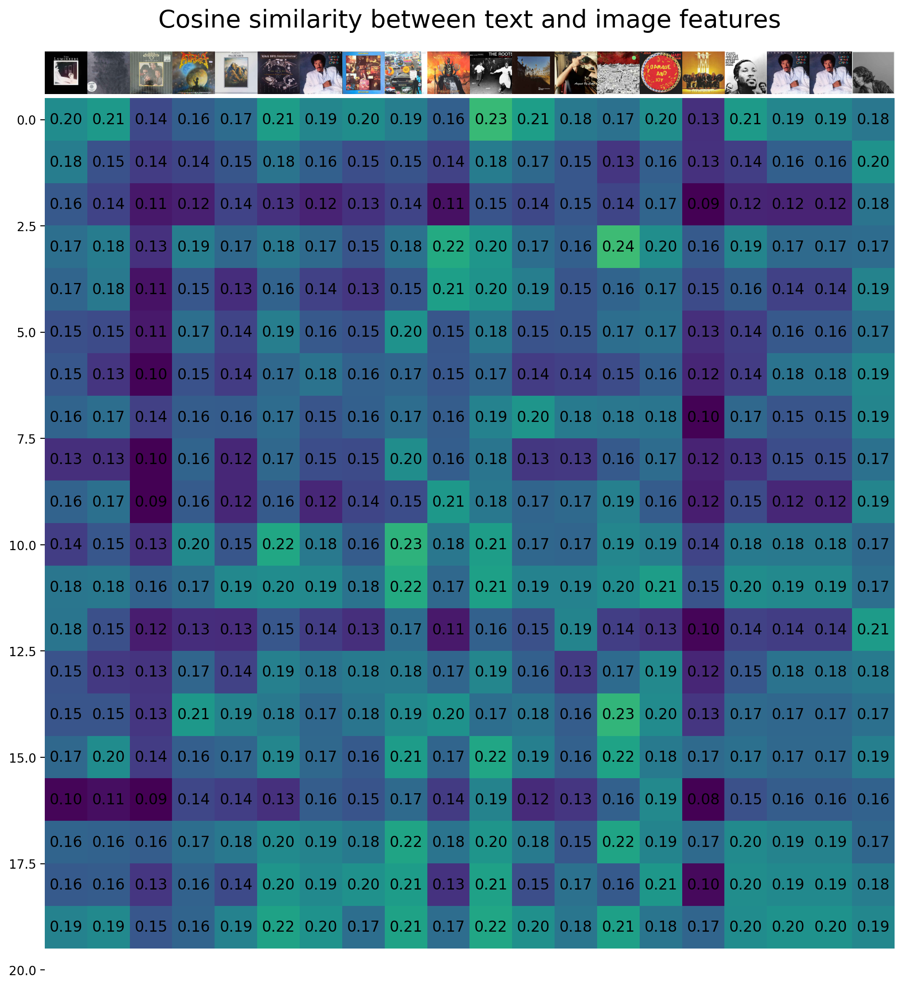

In [ ]:
count = len(descriptions)

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
# plt.colorbar()
# plt.yticks(range(count), texts, fontsize=18)
plt.xticks([])
for i, image in enumerate(original_images):
    plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])

plt.title("Cosine similarity between text and image features", size=20)

##### Text Feature Optimization (testing)

In [ ]:
!pip install livelossplot --quiet
!pip install torchmetrics --quiet

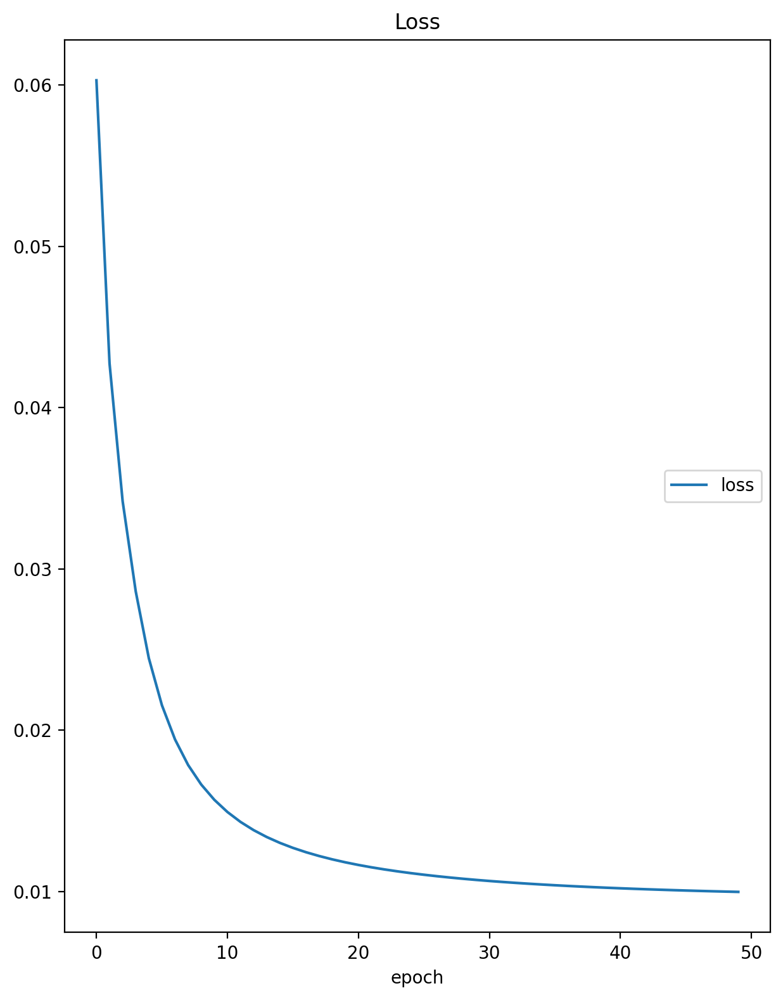

Loss
	loss             	 (min:    0.010, max:    0.060, cur:    0.010)


In [ ]:
# testing optimizing text_features only using 1 group of images

from livelossplot import PlotLosses

def freeze_model(model):
    for param in model.parameters():
        param.requires_grad = False

def tokens_to_similarity(input_text_features, image_features):
    normalized_input_text_features = input_text_features / input_text_features.norm(dim=-1, keepdim=True)
    similarity = normalized_input_text_features @ image_features.T

    return similarity.to(input_text_features.device)

freeze_model(model)

with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    image_features /= image_features.norm(dim=-1, keepdim=True)

input_text_features = text_features.clone().detach().requires_grad_(True)

n_epoch = 500
learningRate = 1e-3

liveloss = PlotLosses()
logs = {}

cost_function = torch.nn.MSELoss()
optimizer = torch.optim.Adam([input_text_features], lr = learningRate)

true_similarity = torch.eye(20).to('cuda')

for epoch in range(n_epoch):
    optimizer.zero_grad()

    if input_text_features.grad is not None:
        input_text_features.grad.zero_()

    pred_similarity = tokens_to_similarity(input_text_features, image_features)

    loss_recon = cost_function(pred_similarity, true_similarity.detach())
    loss = loss_recon
    loss.backward()
    logs['loss'] = loss.item()
    # print("epoch", epoch,"loss=",loss.item())

    optimizer.step()
    
    # Update the plot with new logging information.
    if epoch%10==0:
        liveloss.update(logs)
        liveloss.send()


In [ ]:
normalized_input_text_features = input_text_features / input_text_features.norm(dim=-1, keepdim=True)
similarity = normalized_input_text_features.cpu().detach().numpy() @ image_features.cpu().numpy().T

Text(0.5, 1.0, 'Cosine similarity between text and image features')

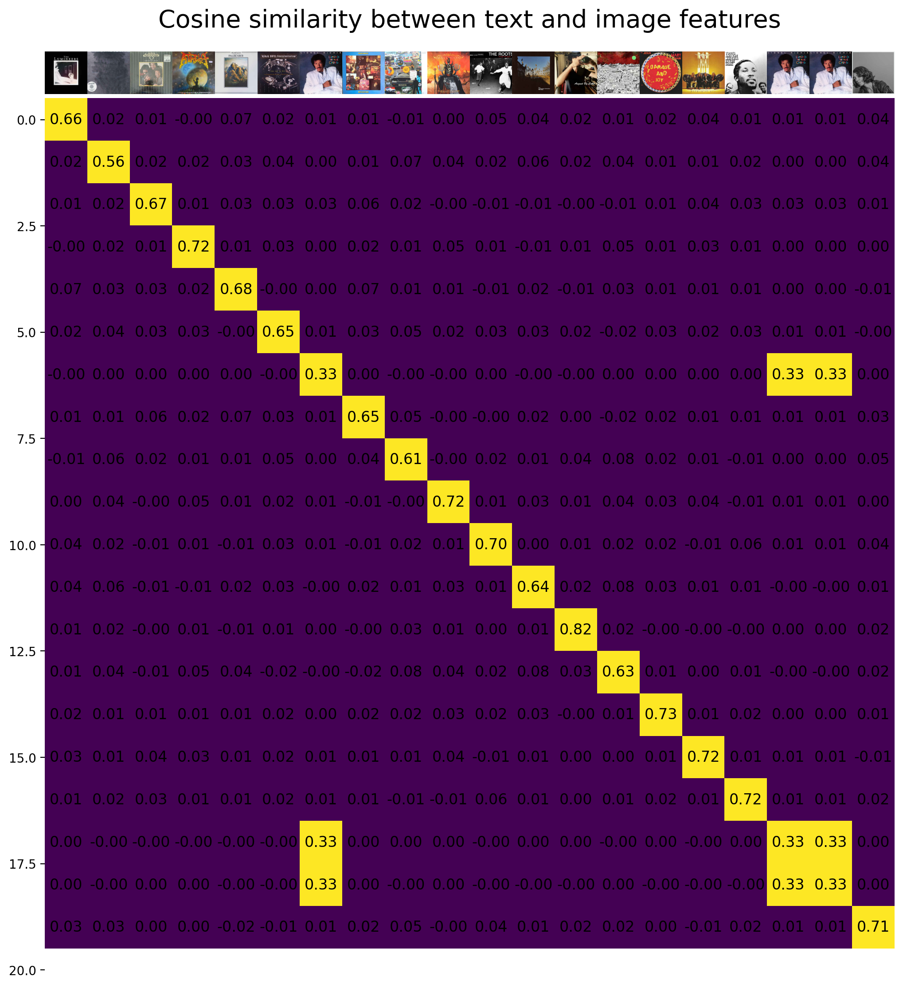

In [ ]:
count = len(descriptions)

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
# plt.colorbar()
# plt.yticks(range(count), texts, fontsize=18)
plt.xticks([])
for i, image in enumerate(original_images):
    plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])

plt.title("Cosine similarity between text and image features", size=20)

##### Zero-Shot Image Classification

Classify images using the cosine similarity (times 100) as the logits to the softmax operation.

In [ ]:
text_descriptions = [f"This is a photo of a {label}" for label in valset.categories]
text_tokens = clip.tokenize(text_descriptions).cuda()

In [ ]:
with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)
top_probs, top_labels = text_probs.cpu().topk(5, dim=-1)

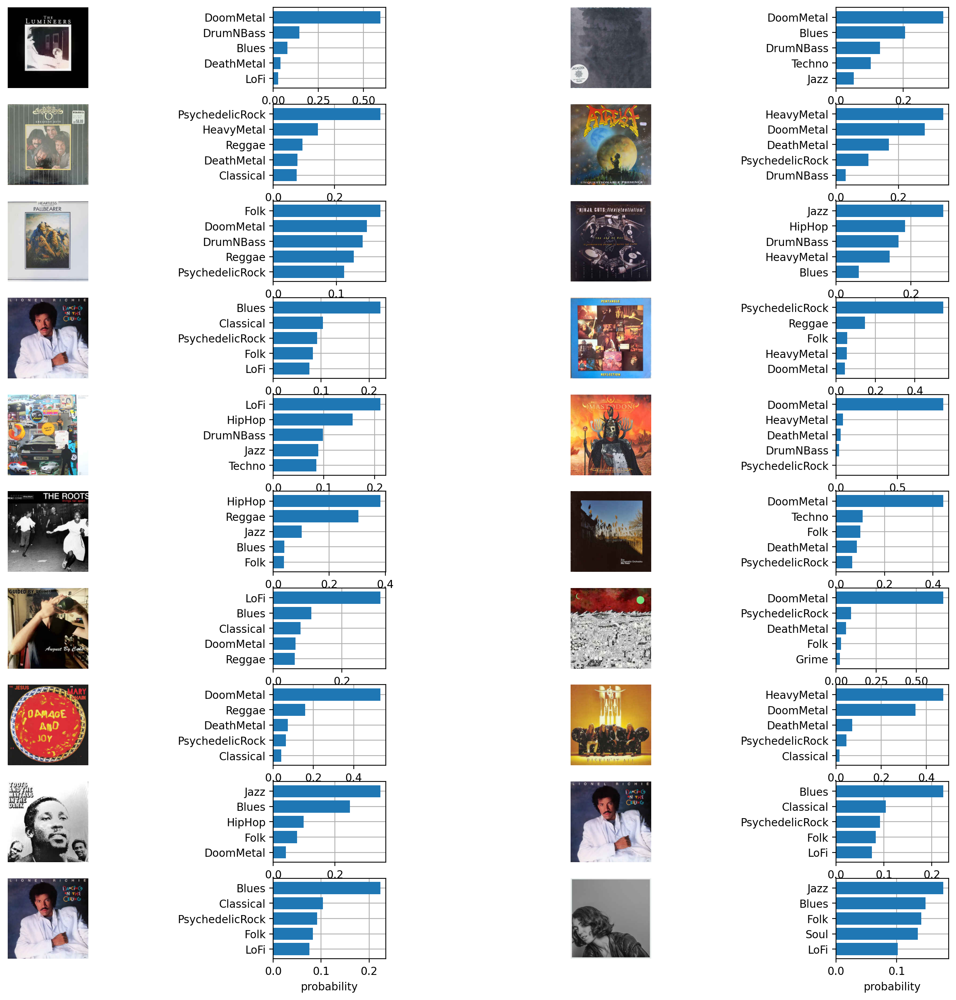

In [ ]:
## validate prediction for original images

plt.figure(figsize=(16, 16))

for i, image in enumerate(original_images):
    plt.subplot(10, 4, 2 * i + 1)
    plt.imshow(image)
    plt.axis("off")
    
    plt.subplot(10, 4, 2 * i + 2)
    y = np.arange(top_probs.shape[-1])
    plt.grid()
    plt.barh(y, top_probs[i])
    plt.gca().invert_yaxis()
    plt.gca().set_axisbelow(True)
    plt.yticks(y, [valset.categories[index] for index in top_labels[i].numpy()])
    plt.xlabel("probability")

plt.subplots_adjust(wspace=1.5)
plt.show()

#### Make predictions on the whole validation dataset

In [ ]:
# setup val data loader

class Flatten(object):
  def __call__(self, input_tensor):
    return input_tensor.view(224 * 224 * 3)

transform = transforms.Compose([transforms.Resize((224, 224)),
                                transforms.ToTensor(),
                                Flatten()])

valset = album_cover_loader(folder_name = folder_name, split = '', transform = transform)

batch_size = 50

val_loader = torch.utils.data.DataLoader(valset, 
                                         batch_size = batch_size, 
                                         shuffle = False)

In [ ]:
# encode descriptions

texts = []

for idx in range(len(image_exp_list)):
    name = valset.categories[idx]
    texts.append(descriptions[name])

text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()

text_features /= text_features.norm(dim=-1, keepdim=True)

In [ ]:
## make predictions by comparing encoded images and text descriptions

results = []
results_all = []

for (batch_id, (xb, yb)) in enumerate(val_loader):
    image_input = xb.reshape(-1,3,224,224).cuda()

    with torch.no_grad():
        image_features = model.encode_image(image_input).float()
    
    image_features /= image_features.norm(dim=-1, keepdim=True)

    text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    top_probs, top_labels = text_probs.cpu().topk(5, dim=-1)
    all_probs, all_labels = text_probs.cpu().topk(len(valset.categories), dim=-1)

    results.append( (top_probs,top_labels,yb) )
    results_all.append( (all_probs,all_labels,yb) )


#### Text feature optimization (testing)

In [ ]:
# setup val data loader

class Flatten(object):
  def __call__(self, input_tensor):
    return input_tensor.view(224 * 224 * 3)

transform = transforms.Compose([transforms.Resize((224, 224)),
                                transforms.ToTensor(),
                                Flatten()])

valset = album_cover_loader(folder_name = folder_name, split = '', transform = transform)

batch_size = 50

val_loader = torch.utils.data.DataLoader(valset, 
                                         batch_size = batch_size, 
                                         shuffle = True)

In [ ]:
# encode descriptions

texts = []

for idx in range(len(image_exp_list)):
    name = valset.categories[idx]
    texts.append(descriptions[name])

text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()

text_features /= text_features.norm(dim=-1, keepdim=True)

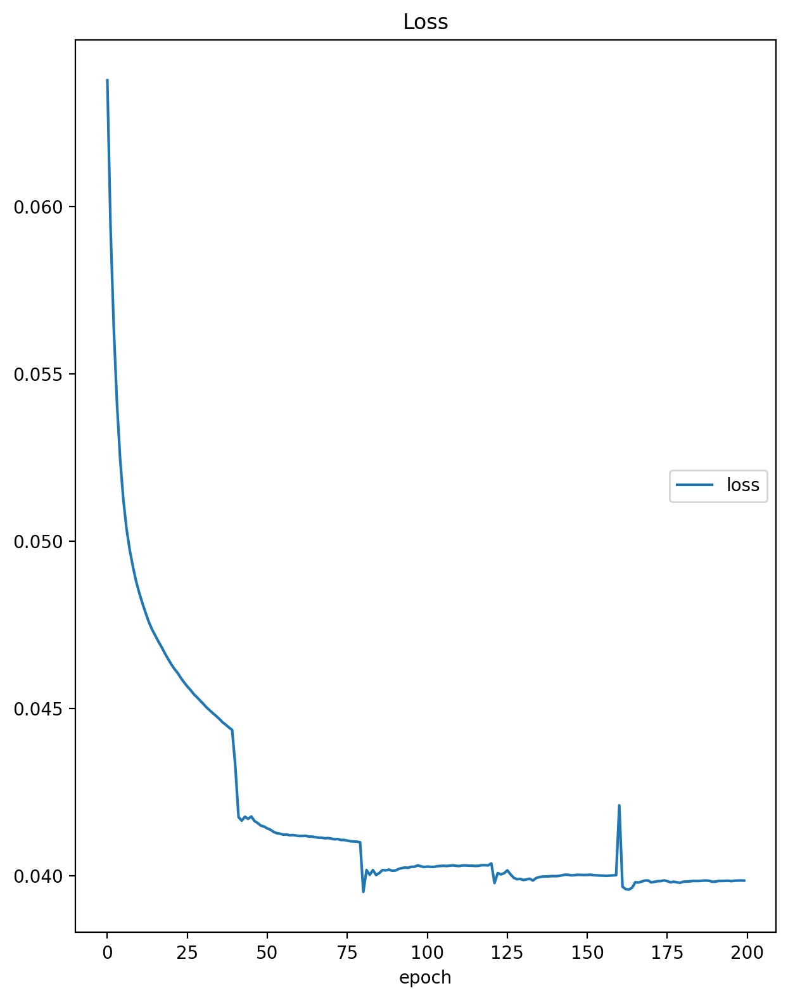

Loss
	loss             	 (min:    0.040, max:    0.064, cur:    0.040)


In [ ]:
from livelossplot import PlotLosses

def freeze_model(model):
    for param in model.parameters():
        param.requires_grad = False

def tokens_to_similarity(input_text_features, image_features):
    normalized_input_text_features = input_text_features / input_text_features.norm(dim=-1, keepdim=True)
    similarity = normalized_input_text_features @ image_features.T

    return similarity.to(input_text_features.device)

freeze_model(model)

input_text_features = text_features.clone().detach().requires_grad_(True)

n_epoch = 5
learningRate = 5e-4

liveloss = PlotLosses()
logs = {}

cost_function = torch.nn.MSELoss()
optimizer = torch.optim.Adam([input_text_features], lr = learningRate)
# optimizer = torch.optim.SGD([input_text_features], lr = learningRate)

n_class = 20

for epoch in range(n_epoch):
    cumulative_loss = 0

    for (batch_id, (xb, yb)) in enumerate(val_loader):
        optimizer.zero_grad()

        if input_text_features.grad is not None:
            input_text_features.grad.zero_()

        image_input = xb.reshape(-1,3,224,224).cuda()

        with torch.no_grad():
            image_features = model.encode_image(image_input).float()
        
        image_features /= image_features.norm(dim=-1, keepdim=True)

        true_similarity = torch.zeros(n_class, batch_size).to('cuda')
        for ib in range(yb.shape[0]):
            true_similarity[ yb[ib], ib ] = 1

        pred_similarity = tokens_to_similarity(input_text_features, image_features)

        loss_recon = cost_function(pred_similarity, true_similarity.detach())
        loss = loss_recon
        loss.backward()

        cumulative_loss += loss.item()
        n_batches = 1 + batch_id 
        logs['loss'] = cumulative_loss / n_batches
        # print("epoch", epoch,"loss=",loss.item())

        optimizer.step()
        
        # Update the plot with new logging information.
        if batch_id%10 == 0:
            liveloss.update(logs)
            liveloss.send()


In [ ]:
## make predictions by comparing encoded images and text descriptions

results = []
results_all = []

for (batch_id, (xb, yb)) in enumerate(val_loader):
    image_input = xb.reshape(-1,3,224,224).cuda()

    with torch.no_grad():
        image_features = model.encode_image(image_input).float()
    
    image_features /= image_features.norm(dim=-1, keepdim=True)

    text_probs = (100.0 * image_features @ input_text_features.T).softmax(dim=-1)
    top_probs, top_labels = text_probs.cpu().topk(5, dim=-1)
    all_probs, all_labels = text_probs.cpu().topk(len(valset.categories), dim=-1)

    results.append( (top_probs,top_labels,yb) )
    results_all.append( (all_probs,all_labels,yb) )


#### Compute prediction accuracy and analyze errors

#### obtain probabilities and plot histograms

In [ ]:
### obtain predicted probabilities for each genre and plot

n_data = len(results_all) * batch_size
n_label = len(valset.categories)
probs_all = np.zeros( (n_label, n_data) )

for idx1 in range(len(results_all)):
    for idx2 in range(batch_size):
        for idx3 in range(n_label):
            probs_all[results_all[idx1][1][idx2][idx3], idx1*batch_size+idx2] = results_all[idx1][0][idx2][idx3]

plt.figure(figsize=(30, 6))

for idx in range(n_label):
    
    P95 = round(np.percentile(probs_all[idx,:], 95),3)

    plt.subplot(2, 10, idx + 1)
    plt.hist(probs_all[idx,:], bins=50)
    plt.ylim(ymax = n_data//100, ymin = 0)

    plt.grid()
    plt.title(valset.categories[idx]+" P95="+str(P95))
    plt.xlabel("probability")
    plt.ylabel("counts")

plt.subplots_adjust(hspace=0.5)
plt.show()

In [ ]:
# convert distribution to uniform

probs_all_new = np.zeros( (n_label, n_data) )

# for idx in range(n_label):
for idx in range(n_label):
    # obtain ranking in ascending order
    ranking = np.argsort(np.argsort(probs_all[idx,:]))
    ranking_min = np.min(ranking)
    ranking_max = np.max(ranking)
    relative_ranking = (ranking - ranking_min) / ranking_max
    probs_all_new[idx,:] = relative_ranking

    # print(probs_all[idx,:10])
    # print(ranking_min)
    # print(ranking_max)
    # print(ranking[:10])
    # print(relative_ranking[:10])

plt.figure(figsize=(30, 6))

for idx in range(n_label):
    
    P95 = round(np.percentile(probs_all_new[idx,:], 95),3)

    plt.subplot(2, 10, idx + 1)
    plt.hist(probs_all_new[idx,:], bins=100)
    plt.ylim(ymax = n_data//50, ymin = 0)

    plt.grid()
    plt.title(valset.categories[idx]+" P95="+str(P95))
    plt.xlabel("probability")
    plt.ylabel("counts")

plt.subplots_adjust(hspace=0.5)
plt.show()

##### compute accuracies with the transform

In [ ]:
# calculate accuracy based on original genres

n_labels = len(valset.categories)

correct = 0
incorrect = 0
incorrect_info = []
confusion_matrix = np.zeros( (n_labels, n_labels) )

for idx1 in range(len(results)):
    for idx2 in range(batch_size):
        probs = probs_all_new[:,idx1*batch_size+idx2]
        pred = np.argmax(probs)
        true = results[idx1][2][idx2].item()

        confusion_matrix[true, pred] += 1

        if pred == true:
            correct += 1
        else:
            incorrect += 1
            incorrect_info.append( (valset.categories[pred], valset.categories[true]) )

accuracy = correct / (correct+incorrect)
confusion_matrix_df = pd.DataFrame(confusion_matrix, columns=valset.categories, index=valset.categories)

print("total=",correct+incorrect)
print("accuracy=",accuracy)

In [ ]:
confusion_matrix_df

In [ ]:
print("Total number of predictions for each genre:")
print(confusion_matrix_df.sum(axis=0))

In [ ]:
# calculate top 3 accuracy based on original genres

# set top n accuracy
top_n = 3

n_labels = len(valset.categories)

correct = 0
incorrect = 0
incorrect_info = []

for idx1 in range(len(results)):
    for idx2 in range(batch_size):
        probs = probs_all_new[:,idx1*batch_size+idx2]
        # top n accuracy
        label_idx = np.argsort(probs)[-top_n:]
        true_idx = results[idx1][2][idx2].item()

        if true_idx in label_idx:
            correct += 1
        else:
            incorrect += 1
            incorrect_info.append( (valset.categories[pred], valset.categories[true]) )

accuracy = correct / (correct+incorrect)

print("total=",correct+incorrect)
print("accuracy=",accuracy)

In [ ]:
### compute accuracy based on Grammy genres

# set top n accuracy
top_n = 3

correct = 0
incorrect = 0
incorrect_info = []

Grammy_dict = {'Blues':'American Roots',
               'Folk':'American Roots',
               'Soul':'American Roots',
               'Classical':'Classical',
               'Country':'Country',
               'DeathMetal':'Metal',
               'DoomMetal':'Metal',
               'HeavyMetal':'Metal',
               'Electronic':'Dance/Electronic',
               'DrumNBass':'Dance/Electronic',
               'LoFi':'Dance/Electronic',
               'Techno':'Dance/Electronic',
               'Grime':'R&B',
               'HipHop':'R&B',
               'Jazz':'Jazz',
               'Pop':'Pop',
               'Reggae':'Reggae',
               'PsychedelicRock':'Rock',
               'Punk':'Rock',
               'Rock':'Rock'}

for idx1 in range(len(results)):
    for idx2 in range(batch_size):
        true_idx = results[idx1][2][idx2].item()
        true_cat = valset.categories[true_idx]
        true_grammy = Grammy_dict[true_cat]

        probs = probs_all_new[:,idx1*batch_size+idx2]
        # top n accuracy
        label_idx = np.argsort(probs)[-top_n:]

        pred_grammy = []
        for idx in label_idx:
            pred_grammy.append( Grammy_dict[valset.categories[idx]] )

        if true_grammy in pred_grammy:
            correct += 1
        else:
            incorrect += 1
            incorrect_info.append( (pred_grammy, true_grammy) )

accuracy = correct / (correct+incorrect)

print("total=",correct+incorrect)
print("accuracy=",accuracy)

#### Compute prediction accuracy and analyze errors

In [ ]:
# calculate accuracy based on original genres

n_labels = len(valset.categories)

correct = 0
incorrect = 0
incorrect_info = []
confusion_matrix = np.zeros( (n_labels, n_labels) )

for idx in range(len(results)):
    for idx2 in range(batch_size):
        pred = results[idx][1][idx2,0].item()
        true = results[idx][2][idx2].item()

        confusion_matrix[true, pred] += 1

        if pred == true:
            correct += 1
        else:
            incorrect += 1
            incorrect_info.append( (valset.categories[pred], valset.categories[true]) )

accuracy = correct / (correct+incorrect)
confusion_matrix_df = pd.DataFrame(confusion_matrix, columns=valset.categories, index=valset.categories)

print("total=",correct+incorrect)
print("accuracy=",accuracy)


total= 20000
accuracy= 0.43435


In [ ]:
# print out confusion matrix to QC wrong predictions
confusion_matrix_df

,Blues,Classical,Country,DeathMetal,DoomMetal,DrumNBass,Electronic,Folk,Grime,HeavyMetal,HipHop,Jazz,LoFi,Pop,PsychedelicRock,Punk,Reggae,Rock,Soul,Techno
Blues,308.0,67.0,35.0,16.0,10.0,3.0,2.0,60.0,3.0,15.0,22.0,65.0,125.0,7.0,24.0,16.0,3.0,7.0,109.0,103.0
Classical,113.0,601.0,4.0,12.0,3.0,0.0,4.0,80.0,1.0,8.0,6.0,55.0,40.0,3.0,4.0,0.0,0.0,0.0,18.0,48.0
Country,252.0,137.0,160.0,9.0,4.0,1.0,0.0,97.0,1.0,6.0,5.0,43.0,130.0,8.0,6.0,11.0,1.0,8.0,66.0,55.0
DeathMetal,15.0,22.0,5.0,276.0,211.0,1.0,0.0,65.0,1.0,298.0,5.0,7.0,13.0,2.0,44.0,6.0,1.0,0.0,0.0,28.0
DoomMetal,28.0,74.0,15.0,117.0,191.0,4.0,0.0,134.0,1.0,206.0,9.0,10.0,59.0,4.0,52.0,9.0,1.0,0.0,2.0,84.0
DrumNBass,51.0,68.0,12.0,27.0,11.0,16.0,11.0,79.0,3.0,10.0,84.0,68.0,89.0,13.0,28.0,11.0,6.0,0.0,31.0,382.0
Electronic,59.0,116.0,17.0,30.0,13.0,4.0,13.0,53.0,1.0,19.0,44.0,58.0,175.0,21.0,33.0,51.0,2.0,8.0,50.0,233.0
Folk,188.0,146.0,49.0,11.0,14.0,0.0,1.0,144.0,0.0,8.0,9.0,68.0,201.0,3.0,18.0,9.0,0.0,2.0,40.0,89.0
Grime,31.0,83.0,30.0,67.0,29.0,2.0,4.0,67.0,5.0,16.0,94.0,28.0,116.0,16.0,22.0,15.0,5.0,1.0,33.0,336.0
HeavyMetal,53.0,40.0,7.0,312.0,133.0,10.0,9.0,49.0,4.0,116.0,34.0,10.0,41.0,9.0,62.0,33.0,0.0,8.0,16.0,54.0


In [ ]:
print("Total number of predictions for each genre:")
print(confusion_matrix_df.sum(axis=0))

Total number of predictions for each genre:
Blues              2533.0
Classical          2090.0
Country             484.0
DeathMetal         1355.0
DoomMetal           751.0
DrumNBass            68.0
Electronic           96.0
Folk               1551.0
Grime                39.0
HeavyMetal          831.0
HipHop              920.0
Jazz                961.0
LoFi               2334.0
Pop                 250.0
PsychedelicRock     649.0
Punk                591.0
Reggae              188.0
Rock                 81.0
Soul               1222.0
Techno             3006.0
dtype: float64


In [ ]:
# prediction before updating the description of Jazz
# print("Total number of predictions for each genre",confusion_matrix_df.sum(axis=0))

Total number of predictions for each genre Blues               678.0
Classical           537.0
Country             308.0
DeathMetal          880.0
DoomMetal           519.0
DrumNBass            40.0
Electronic           78.0
Folk               2278.0
Grime                17.0
HeavyMetal          662.0
HipHop              432.0
Jazz               9651.0
LoFi               2106.0
Pop                 108.0
PsychedelicRock     279.0
Punk                225.0
Reggae              123.0
Rock                  6.0
Soul                411.0
Techno              662.0
dtype: float64


Below is the updated Grammy Genres mapping (based on Andrew's input via discord):

Blues/Folk/Soul => American Roots

Classical => Classical

Country => Country

DeathMetal/DoomMetal/HeavyMetal => Metal

Electronic/DrumNBass/LoFi/Techno => Dance/Electronic

Grime/HipHop => R&B

Jazz => Jazz

Pop => Pop

Reggae => Reggae

PsychedelicRock/Punk/Rock => Rock

In [ ]:
### compute accuracy based on Grammy genres

correct = 0
incorrect = 0
incorrect_info = []

Grammy_dict = {'Blues':'American Roots',
               'Folk':'American Roots',
               'Soul':'American Roots',
               'Classical':'Classical',
               'Country':'Country',
               'DeathMetal':'Metal',
               'DoomMetal':'Metal',
               'HeavyMetal':'Metal',
               'Electronic':'Dance/Electronic',
               'DrumNBass':'Dance/Electronic',
               'LoFi':'Dance/Electronic',
               'Techno':'Dance/Electronic',
               'Grime':'R&B',
               'HipHop':'R&B',
               'Jazz':'Jazz',
               'Pop':'Pop',
               'Reggae':'Reggae',
               'PsychedelicRock':'Rock',
               'Punk':'Rock',
               'Rock':'Rock'}

for idx in range(len(results)):
    for idx2 in range(batch_size):
        # original predicted and true genres
        pred_label = results[idx][1][idx2,0].item()
        true_label = results[idx][2][idx2].item()
        pred_cat = valset.categories[pred_label]
        true_cat = valset.categories[true_label]

        # convert to Grammy genres
        pred_grammy = Grammy_dict[pred_cat]
        true_grammy = Grammy_dict[true_cat]

        if pred_grammy == true_grammy:
            correct += 1
        else:
            incorrect += 1
            incorrect_info.append( (pred_grammy, true_grammy) )

accuracy = correct / (correct+incorrect)

print("total=",correct+incorrect)
print("accuracy=",accuracy)


total= 20000
accuracy= 0.34595


In [ ]:
# # printout instances where prediction is wrong for fine-tuning purpose

# print(len(incorrect_info))
# for idx in range(len(incorrect_info)):
#     print("Pred:",incorrect_info[idx][0],"  True:",incorrect_info[idx][1])
    